# Week 3: Variational Autoencoders on Anime Faces

For this exercise, you will train a Variational Autoencoder (VAE) using the [anime faces dataset by MckInsey666](https://github.com/bchao1/Anime-Face-Dataset). 

You will train the model using the techniques discussed in class. At the end, you should save your model and download it from Colab so that it can be submitted to the autograder for grading.

***Important:*** *This colab notebook has read-only access so you won't be able to save your changes. If you want to save your work periodically, please click `File -> Save a Copy in Drive` to create a copy in your account, then work from there.*  

## Imports

In [2]:
import tensorflow as tf
import tensorflow_datasets as tfds

import matplotlib.pyplot as plt
import numpy as np

import os
import zipfile
import urllib.request
import random
from IPython import display

## Parameters

In [3]:
# set a random seed
np.random.seed(51)

# parameters for building the model and training
BATCH_SIZE=2000
LATENT_DIM=512
IMAGE_SIZE=64

## Download the Dataset

You will download the Anime Faces dataset and save it to a local directory.

In [4]:
# make the data directory
try:
  os.mkdir('/tmp/anime')
except OSError:
  pass

# download the zipped dataset to the data directory
data_url = "https://storage.googleapis.com/laurencemoroney-blog.appspot.com/Resources/anime-faces.zip"
data_file_name = "animefaces.zip"
download_dir = '/tmp/anime/'
urllib.request.urlretrieve(data_url, data_file_name)

# extract the zip file
zip_ref = zipfile.ZipFile(data_file_name, 'r')
zip_ref.extractall(download_dir)
zip_ref.close()

## Prepare the Dataset

Next is preparing the data for training and validation. We've provided you some utilities below.

In [5]:
# Data Preparation Utilities

def get_dataset_slice_paths(image_dir):
  '''returns a list of paths to the image files'''
  image_file_list = os.listdir(image_dir)
  image_paths = [os.path.join(image_dir, fname) for fname in image_file_list]

  return image_paths


def map_image(image_filename):
  '''preprocesses the images'''
  img_raw = tf.io.read_file(image_filename)
  image = tf.image.decode_jpeg(img_raw)

  image = tf.cast(image, dtype=tf.float32)
  image = tf.image.resize(image, (IMAGE_SIZE, IMAGE_SIZE))
  image = image / 255.0  
  image = tf.reshape(image, shape=(IMAGE_SIZE, IMAGE_SIZE, 3,))

  return image

You will use the functions above to generate the train and validation sets.

In [6]:
# get the list containing the image paths
paths = get_dataset_slice_paths("/tmp/anime/images/")

# shuffle the paths
random.shuffle(paths)

# split the paths list into to training (80%) and validation sets(20%).
paths_len = len(paths)
train_paths_len = int(paths_len * 0.8)

train_paths = paths[:train_paths_len]
val_paths = paths[train_paths_len:]

# load the training image paths into tensors, create batches and shuffle
training_dataset = tf.data.Dataset.from_tensor_slices((train_paths))
training_dataset = training_dataset.map(map_image)
training_dataset = training_dataset.shuffle(1000).batch(BATCH_SIZE)

# load the validation image paths into tensors and create batches
validation_dataset = tf.data.Dataset.from_tensor_slices((val_paths))
validation_dataset = validation_dataset.map(map_image)
validation_dataset = validation_dataset.batch(BATCH_SIZE)


print(f'number of batches in the training set: {len(training_dataset)}')
print(f'number of batches in the validation set: {len(validation_dataset)}')

number of batches in the training set: 26
number of batches in the validation set: 7


## Display Utilities

We've also provided some utilities to help in visualizing the data.

In [7]:
def display_faces(dataset, size=9):
  '''Takes a sample from a dataset batch and plots it in a grid.'''
  dataset = dataset.unbatch().take(size)
  n_cols = 3
  n_rows = size//n_cols + 1
  plt.figure(figsize=(5, 5))
  i = 0
  for image in dataset:
    i += 1
    disp_img = np.reshape(image, (64,64,3))
    plt.subplot(n_rows, n_cols, i)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(disp_img)


def display_one_row(disp_images, offset, shape=(28, 28)):
  '''Displays a row of images.'''
  for idx, image in enumerate(disp_images):
    plt.subplot(3, 10, offset + idx + 1)
    plt.xticks([])
    plt.yticks([])
    image = np.reshape(image, shape)
    plt.imshow(image)


def display_results(disp_input_images, disp_predicted):
  '''Displays input and predicted images.'''
  plt.figure(figsize=(15, 5))
  display_one_row(disp_input_images, 0, shape=(IMAGE_SIZE,IMAGE_SIZE,3))
  display_one_row(disp_predicted, 20, shape=(IMAGE_SIZE,IMAGE_SIZE,3))


Let's see some of the anime faces from the validation dataset.

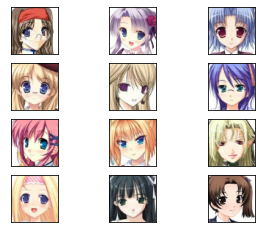

In [8]:
display_faces(validation_dataset, size=12)

## Build the Model

You will be building your VAE in the following sections. Recall that this will follow and encoder-decoder architecture and can be summarized by the figure below.

<img src="https://drive.google.com/uc?export=view&id=1YAZAeMGEJ1KgieYk1ju-S9DoshpMREeC" width="60%" height="60%"/>

### Sampling Class

You will start with the custom layer to provide the Gaussian noise input along with the mean (mu) and standard deviation (sigma) of the encoder's output. Recall the equation to combine these:

$$z = \mu + e^{0.5\sigma} * \epsilon  $$

where $\mu$ = mean, $\sigma$ = standard deviation, and $\epsilon$ = random sample

In [9]:
class Sampling(tf.keras.layers.Layer):
  def call(self, inputs):
    """Generates a random sample and combines with the encoder output
    
    Args:
      inputs -- output tensor from the encoder

    Returns:
      `inputs` tensors combined with a random sample
    """
    ### START CODE HERE ###
    mu, sigma = inputs # coming out of dense layer with shape b,c
    batch = tf.shape(mu)[0]
    dim = tf.shape(mu)[1]
    epsilon = tf.random.normal(shape=(batch,dim))
    z = mu + tf.exp( 0.5*sigma) * epsilon
    ### END CODE HERE ###
    return  z

### Encoder Layers

Next, please use the Functional API to stack the encoder layers and output `mu`, `sigma` and the shape of the features before flattening. We expect you to use 3 convolutional layers (instead of 2 in the ungraded lab) but feel free to revise as you see fit. Another hint is to use `1024` units in the Dense layer before you get mu and sigma (we used `20` for it in the ungraded lab).

*Note: If you did Week 4 before Week 3, please do not use LeakyReLU activations yet for this particular assignment. The grader for Week 3 does not support LeakyReLU yet. This will be updated but for now, you can use `relu` and `sigmoid` just like in the ungraded lab.*

In [10]:
from tensorflow.keras.layers import Input , Conv2D , Conv2DTranspose , BatchNormalization , Dense , Flatten

In [11]:
def encoder_layers(inputs, latent_dim):
  """Defines the encoder's layers.
  Args:
    inputs -- batch from the dataset
    latent_dim -- dimensionality of the latent space

  Returns:
    mu -- learned mean
    sigma -- learned standard deviation
    batch_3.shape -- shape of the features before flattening
  """
  ### START CODE HERE ###
  conv1=Conv2D(16 , 2 , padding='same' ,activation='relu')(inputs)
  b0=BatchNormalization()(conv1)
  conv2=Conv2D(32 , 2 , 2 ,  padding='same' ,activation='relu')(b0)
  b1=BatchNormalization()(conv2)
  conv3=Conv2D(64 , 2 , 2 ,  padding='same' ,activation='relu')(b1)
  b2=BatchNormalization()(conv3)
  conv4=Conv2D(128 , 2 , 2 , padding='same' ,activation='relu')(b2)
  b3=BatchNormalization()(conv4)
  x=Flatten()(b3)
  x=Dense(1028 , activation='relu')(x)
  x = tf.keras.layers.BatchNormalization()(x) # without this batch norm the model doesn't work and gets OOM error (out of memo)
  mu=Dense(latent_dim )(x)
  sigma=Dense(latent_dim)(x)
  
  
  ### END CODE HERE ###

  # revise `batch_3.shape` here if you opted not to use 3 Conv2D layers
  return mu, sigma, b3.shape

### Encoder Model

You will feed the output from the above function to the `Sampling layer` you defined earlier. That will have the latent representations that can be fed to the decoder network later. Please complete the function below to build the encoder network with the `Sampling` layer.

In [12]:
def encoder_model(latent_dim, input_shape):
  """Defines the encoder model with the Sampling layer
  Args:
    latent_dim -- dimensionality of the latent space
    input_shape -- shape of the dataset batch

  Returns:
    model -- the encoder model
    conv_shape -- shape of the features before flattening
  """
  ### START CODE HERE ###
  inputs = Input( shape=(input_shape) )
  mu, sigma, conv_shape = encoder_layers( inputs , latent_dim )

  z = Sampling()((mu,sigma))
  model = tf.keras.Model(inputs=inputs , outputs=[mu , sigma , z])
  ### END CODE HERE ###
  model.summary()
  return model, conv_shape

### Decoder Layers

Next, you will define the decoder layers. This will expand the latent representations back to the original image dimensions. After training your VAE model, you can use this decoder model to generate new data by feeding random inputs.

In [13]:
def decoder_layers(inputs, conv_shape):
  """Defines the decoder layers.
  Args:
    inputs -- output of the encoder 
    conv_shape -- shape of the features before flattening

  Returns:
    tensor containing the decoded output
  """
#   conv1=Conv2D(16 , 2 , padding='same' ,activation='relu')(inputs)
#   conv2=Conv2D(32 , 2 , padding='same' ,activation='relu')(conv1)
#   b1=BatchNormalization()(conv2)
#   conv3=Conv2D(64 , 2 , padding='same' ,activation='relu')(b1)
#   conv4=Conv2D(128 , 2 , padding='same' ,activation='relu')(conv3)
#   b2=BatchNormalization()(conv4)
#   x=Flatten()(b2)


  ### START CODE HERE ###
   
  #DONT YOU FORGET THIS
  units = conv_shape[1] * conv_shape[2] * conv_shape[3] # where units = dims of the image we will construct using reshaping layer -h*w*c flattened-
  x = tf.keras.layers.Dense(units, activation = 'relu')(inputs) # inputs will be the z output of the sampling layer, output will be our last image shape flattened
  x = tf.keras.layers.BatchNormalization()(x)
 
  x=tf.keras.layers.Reshape( conv_shape[1:] )(x) # reshape takes the shapes individually as it doesn't include the batch size conv_shape[0]
  deconv4=Conv2DTranspose(128 , 2 , 2 , padding='same',activation='relu')(x)
  b3=BatchNormalization()(deconv4)
  deconv3=Conv2DTranspose(64 , 2 , 2 , padding='same',activation='relu')(b3)
  b2=BatchNormalization()(deconv3)
  deconv2=Conv2DTranspose(32, 2 , 2 , padding='same',activation='relu')(b2)
  b1=BatchNormalization()(deconv2)
  deconv1=Conv2DTranspose(16, 2 , padding='same',activation='relu')(b1)
  b0=BatchNormalization()(deconv1)
  output=Conv2DTranspose(3, 2 , 1 , padding='same',activation='relu')(b0)

  return output

### Decoder Model

Please complete the function below to output the decoder model.

In [14]:
def decoder_model(latent_dim, conv_shape):
  """Defines the decoder model.
  Args:
    latent_dim -- dimensionality of the latent space
    conv_shape -- shape of the features before flattening

  Returns:
    model -- the decoder model
  """
  ### START CODE HERE ###
  
  inputs = Input( shape=( latent_dim) )
  outputs = decoder_layers(inputs , conv_shape)
  model = tf.keras.Model(inputs=inputs, outputs= outputs)
  ### END CODE HERE ###
  model.summary()
  return model

### Kullback–Leibler Divergence

Next, please complete the function below to compute the [Kullback–Leibler Divergence](https://arxiv.org/abs/2002.07514) loss. This will be used to improve the generative capability of the model.


In [15]:
def kl_reconstruction_loss(inputs, outputs, mu, sigma):
  """ Computes the Kullback-Leibler Divergence (KLD)
  Args:
    inputs -- batch from the dataset
    outputs -- output of the Sampling layer
    mu -- mean
    sigma -- standard deviation

  Returns:
    KLD loss
  """
  kl_loss = 1 + sigma - tf.math.exp(sigma) - tf.square(mu) 
  return tf.reduce_mean(kl_loss) * -0.5

### Putting it all together

Please define the whole VAE model. Remember to use `model.add_loss()` to add the KL reconstruction loss. This will be accessed and added to the loss later in the training loop.

In [16]:
def vae_model(encoder, decoder, input_shape):
  """Defines the VAE model
  Args:
    encoder -- the encoder model
    decoder -- the decoder model
    input_shape -- shape of the dataset batch

  Returns:
    the complete VAE model
  """
  input=Input(input_shape)
  mu , sigma , z = encoder(input)
  decoded = decoder(z)
  model=tf.keras.Model( inputs=input , outputs=decoded)
  loss=kl_reconstruction_loss(input , z , mu , sigma )
  model.add_loss( loss )

  return model

Next, please define a helper function to return the encoder, decoder, and vae models you just defined.


In [17]:
def get_models(input_shape, latent_dim):
  """Returns the encoder, decoder, and vae models"""
  encoder,conv_shape= encoder_model(latent_dim , input_shape)
  decoder= decoder_model(latent_dim , conv_shape)
  vae= vae_model( encoder , decoder , input_shape )
  return encoder, decoder, vae

Let's use the function above to get the models we need in the training loop.


In [18]:
encoder, decoder, vae = get_models( input_shape=(64,64,3) , latent_dim=LATENT_DIM )

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 64, 64, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 64, 64, 16)   208         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 64, 64, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 32, 32, 32)   2080        batch_normalization[0][0]        
______________________________________________________________________________________________

## Train the Model

You will now configure the model for training. We defined some losses, the optimizer, and the loss metric below but you can experiment with others if you like.


In [19]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.002)
loss_metric = tf.keras.metrics.Mean()
mse_loss = tf.keras.losses.MeanSquaredError()
bce_loss = tf.keras.losses.BinaryCrossentropy()

You will generate 16 images in a 4x4 grid to show
progress of image generation. We've defined a utility function for that below.

In [29]:
def generate_and_save_images(model, epoch, step, test_input):
  """Helper function to plot our 16 images

  Args:

  model -- the decoder model
  epoch -- current epoch number during training
  step -- current step number during training
  test_input -- random tensor with shape (15, LATENT_DIM)
  """
  predictions = model.predict(test_input)

  fig = plt.figure(figsize=(20,20))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      img = predictions[i, :, :, :] * 255
      img = img.astype('int32')
      plt.imshow(img)
      plt.axis('off')

  # tight_layout minimizes the overlap between 2 sub-plots
  fig.suptitle("epoch: {}, step: {}".format(epoch, step))
  plt.savefig('image_at_epoch_{:04d}_step{:04d}.png'.format(epoch, step))
  plt.show()

You can now start the training loop. You are asked to select the number of epochs and to complete the subection on updating the weights. The general steps are:

* feed a training batch to the VAE model
* compute the reconstruction loss (hint: use the **mse_loss** defined above instead of `bce_loss` in the ungraded lab, then multiply by the flattened dimensions of the image (i.e. 64 x 64 x 3)
* add the KLD regularization loss to the total loss (you can access the `losses` property of the `vae` model)
* get the gradients
* use the optimizer to update the weights


When training your VAE, you might notice that there’s not a lot of variation in the faces. But don’t let that deter you! We’ll test based on how well it does in reconstructing the original faces, and not how well it does in creating new faces.

The training will also take a long time (more than 30 minutes) and that is to be expected. If you used the mean loss metric suggested above, train the model until that is down to around 320 before submitting.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


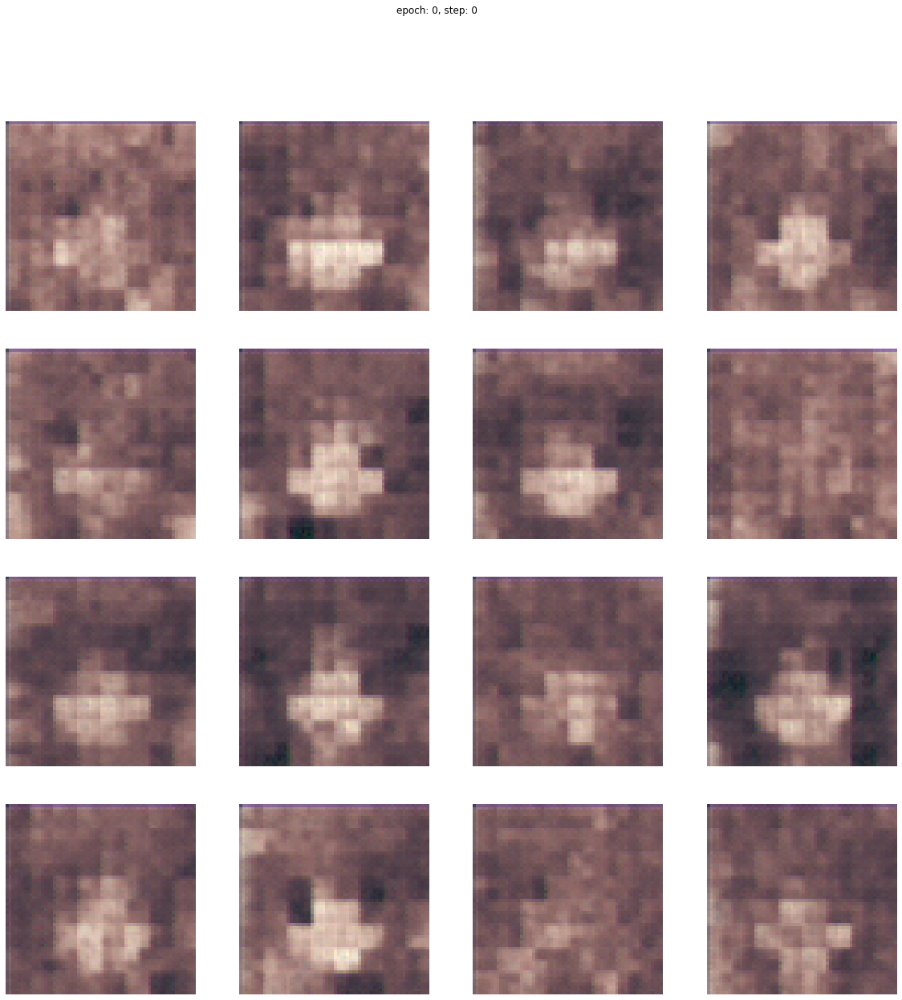

Start of epoch 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


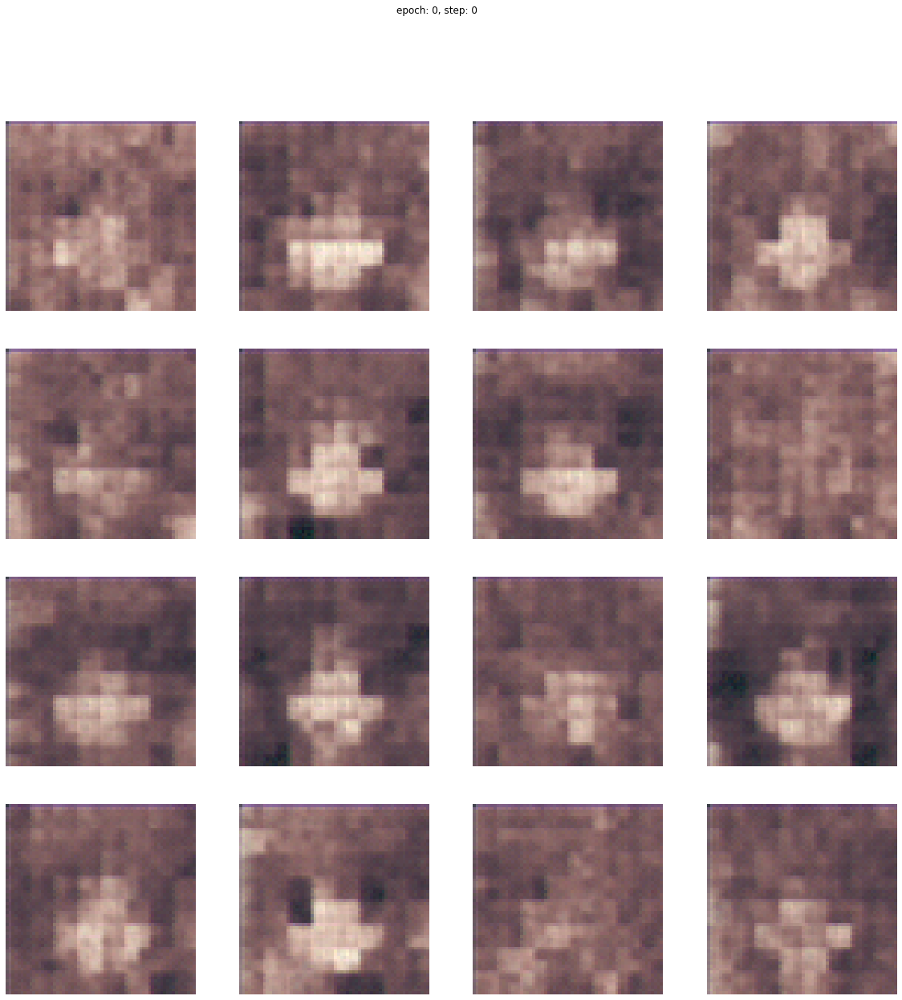

Epoch: 0 step: 0 mean loss = 1135.2216
Epoch: 0 step: 1 mean loss = 1133.9362
Epoch: 0 step: 2 mean loss = 1132.6509
Epoch: 0 step: 3 mean loss = 1131.3704
Epoch: 0 step: 4 mean loss = 1130.0967
Epoch: 0 step: 5 mean loss = 1128.8104
Epoch: 0 step: 6 mean loss = 1127.5494
Epoch: 0 step: 7 mean loss = 1126.2748
Epoch: 0 step: 8 mean loss = 1125.0028
Epoch: 0 step: 9 mean loss = 1123.7444


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


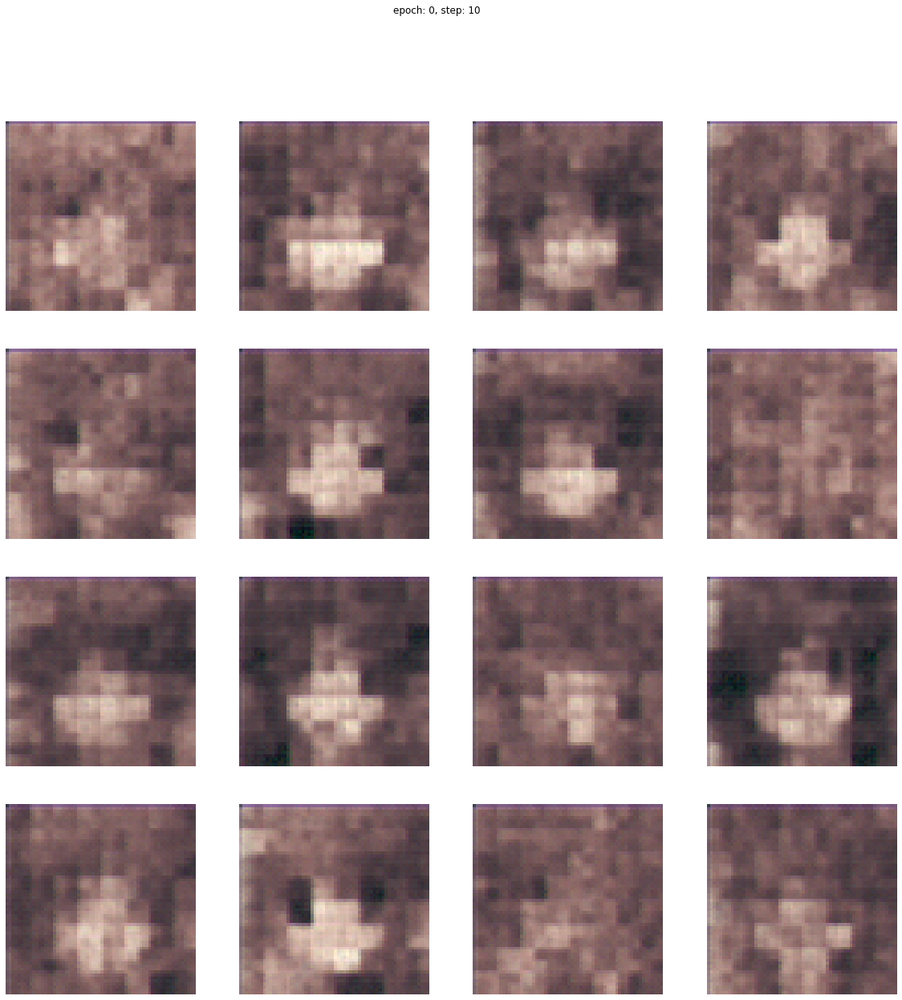

Epoch: 0 step: 10 mean loss = 1122.4829
Epoch: 0 step: 11 mean loss = 1121.2277
Epoch: 0 step: 12 mean loss = 1119.9741
Epoch: 0 step: 13 mean loss = 1118.7274
Epoch: 0 step: 14 mean loss = 1117.4816
Epoch: 0 step: 15 mean loss = 1116.2378
Epoch: 0 step: 16 mean loss = 1115.0012
Epoch: 0 step: 17 mean loss = 1113.7643
Epoch: 0 step: 18 mean loss = 1112.5297
Epoch: 0 step: 19 mean loss = 1111.2927


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


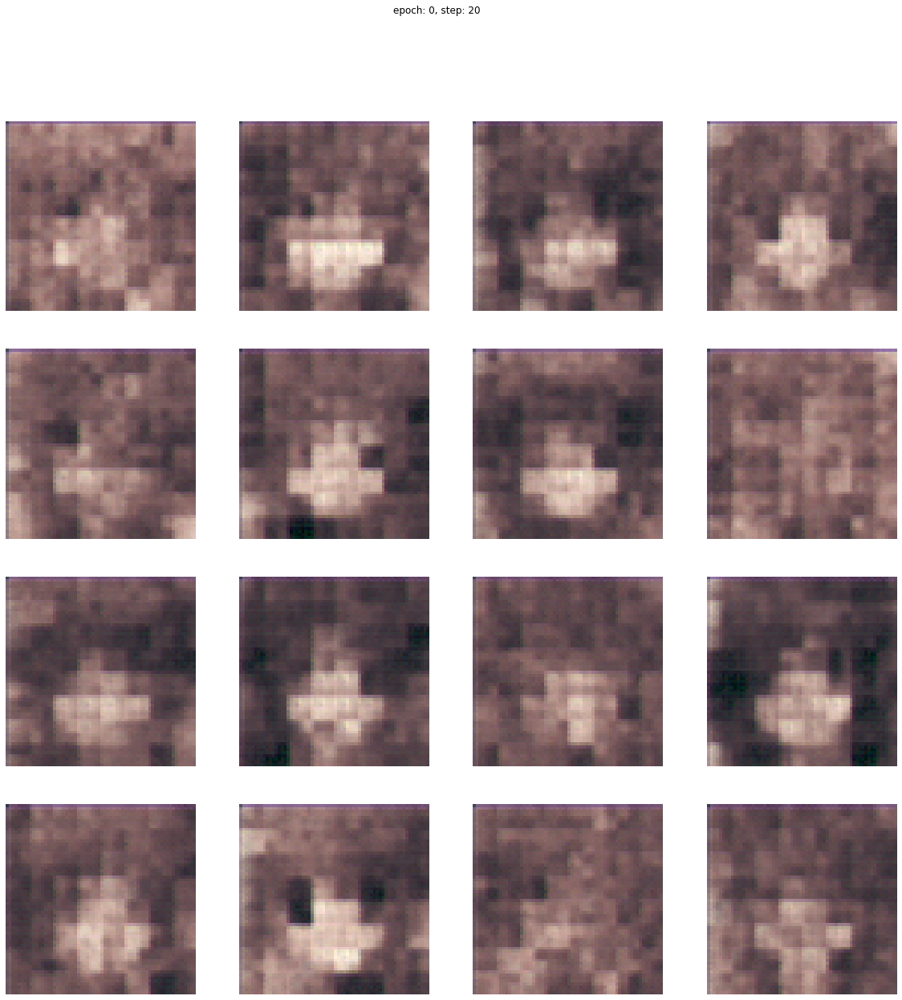

Epoch: 0 step: 20 mean loss = 1110.0725
Epoch: 0 step: 21 mean loss = 1108.8405
Epoch: 0 step: 22 mean loss = 1107.6246
Epoch: 0 step: 23 mean loss = 1106.4054
Epoch: 0 step: 24 mean loss = 1105.1962
Epoch: 0 step: 25 mean loss = 1103.9888
Start of epoch 1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


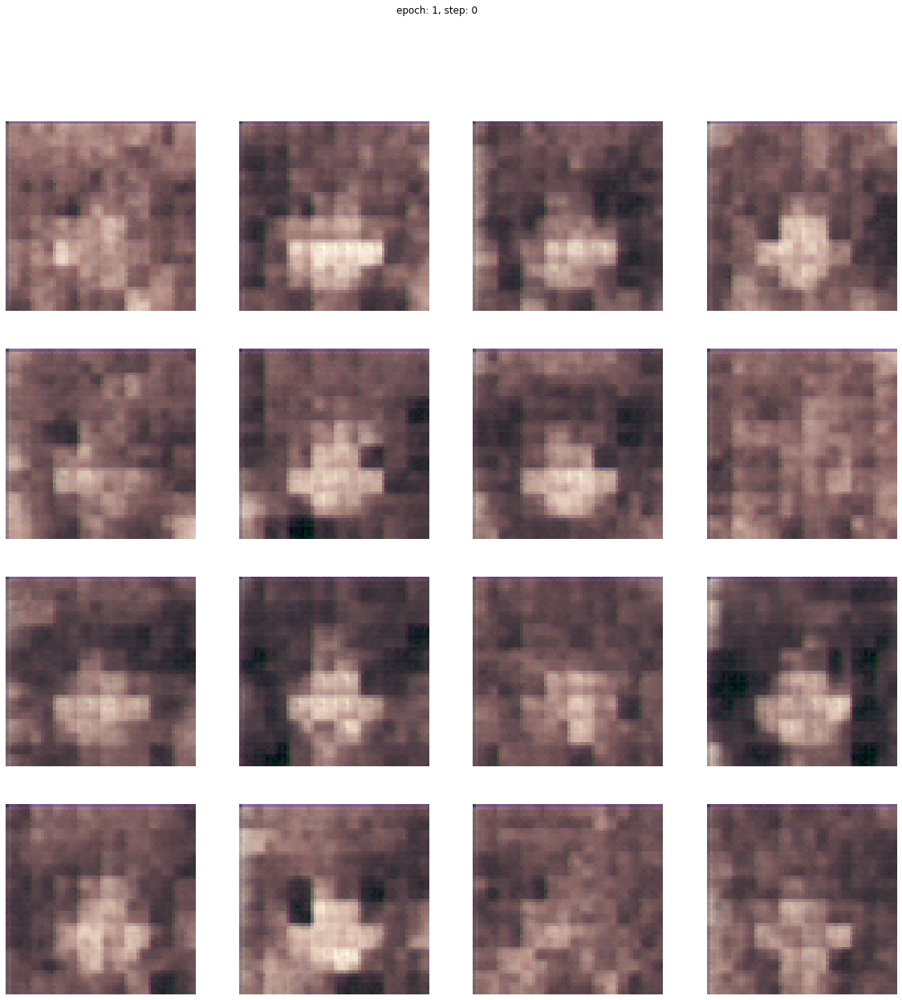

Epoch: 1 step: 0 mean loss = 1102.7703
Epoch: 1 step: 1 mean loss = 1101.5593
Epoch: 1 step: 2 mean loss = 1100.3638
Epoch: 1 step: 3 mean loss = 1099.1667
Epoch: 1 step: 4 mean loss = 1097.9724
Epoch: 1 step: 5 mean loss = 1096.7792
Epoch: 1 step: 6 mean loss = 1095.5935
Epoch: 1 step: 7 mean loss = 1094.4103
Epoch: 1 step: 8 mean loss = 1093.2269
Epoch: 1 step: 9 mean loss = 1092.052


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


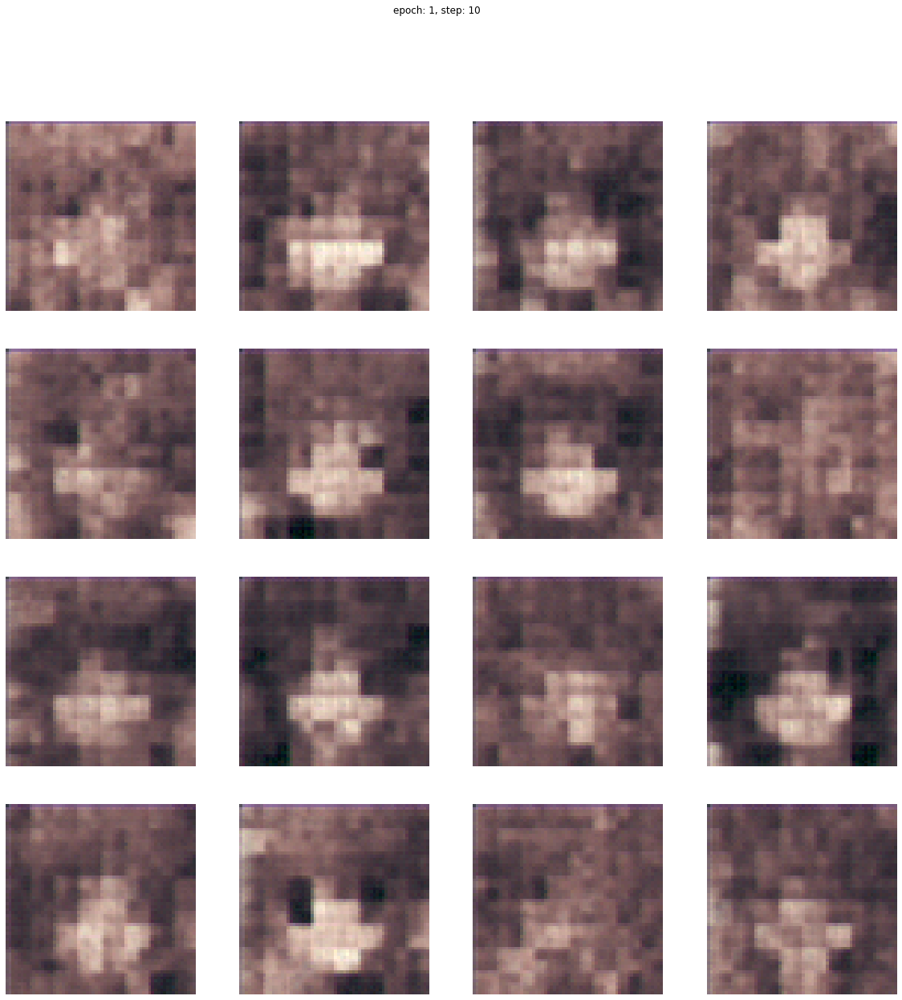

Epoch: 1 step: 10 mean loss = 1090.88
Epoch: 1 step: 11 mean loss = 1089.7079
Epoch: 1 step: 12 mean loss = 1088.5428
Epoch: 1 step: 13 mean loss = 1087.3826
Epoch: 1 step: 14 mean loss = 1086.2238
Epoch: 1 step: 15 mean loss = 1085.0656
Epoch: 1 step: 16 mean loss = 1083.9185
Epoch: 1 step: 17 mean loss = 1082.7688
Epoch: 1 step: 18 mean loss = 1081.6161
Epoch: 1 step: 19 mean loss = 1080.4719


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


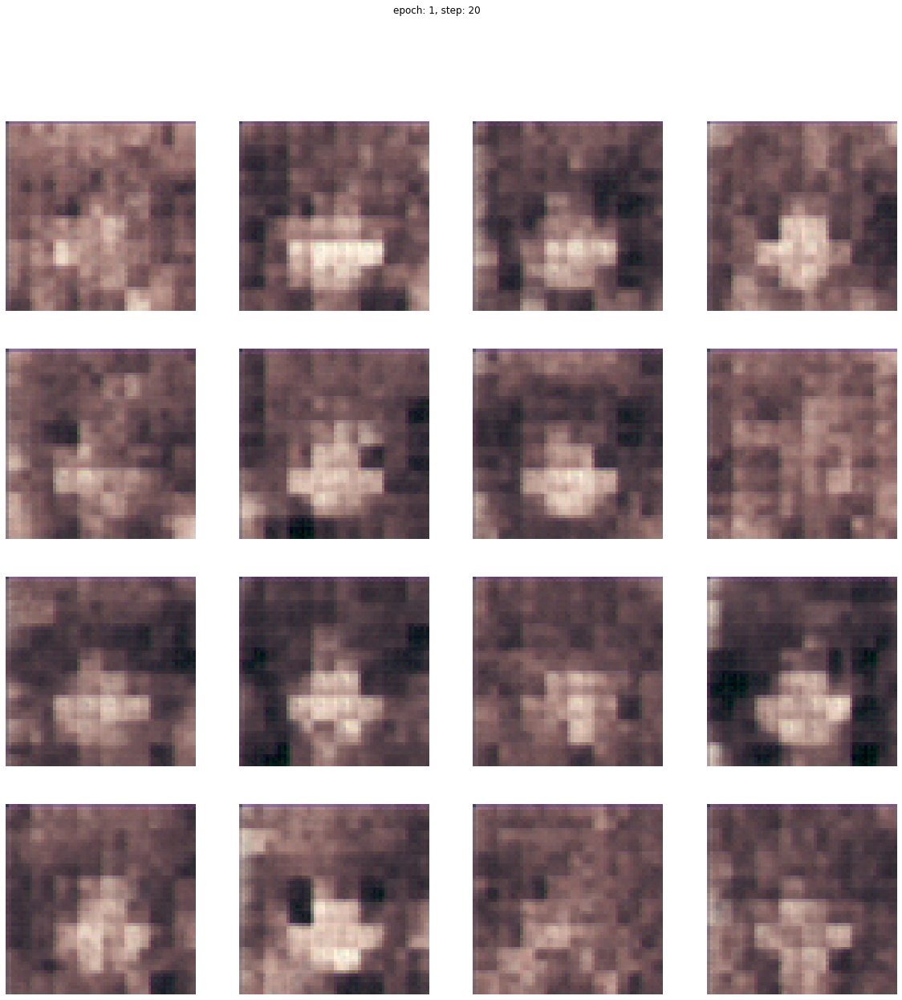

Epoch: 1 step: 20 mean loss = 1079.3315
Epoch: 1 step: 21 mean loss = 1078.1963
Epoch: 1 step: 22 mean loss = 1077.0575
Epoch: 1 step: 23 mean loss = 1075.9314
Epoch: 1 step: 24 mean loss = 1074.8079
Epoch: 1 step: 25 mean loss = 1073.6785
Start of epoch 2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


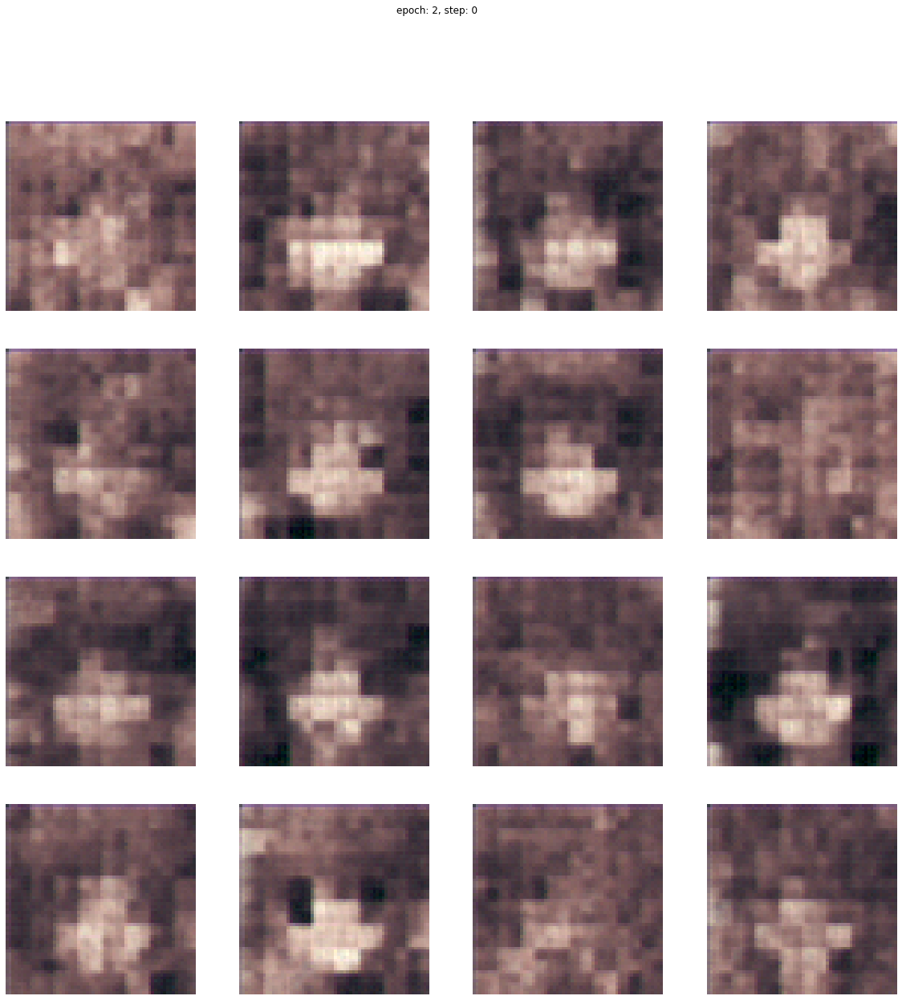

Epoch: 2 step: 0 mean loss = 1072.5475
Epoch: 2 step: 1 mean loss = 1071.4165
Epoch: 2 step: 2 mean loss = 1070.3063
Epoch: 2 step: 3 mean loss = 1069.1958
Epoch: 2 step: 4 mean loss = 1068.0873
Epoch: 2 step: 5 mean loss = 1066.9789
Epoch: 2 step: 6 mean loss = 1065.8743
Epoch: 2 step: 7 mean loss = 1064.7738
Epoch: 2 step: 8 mean loss = 1063.6725
Epoch: 2 step: 9 mean loss = 1062.5798


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


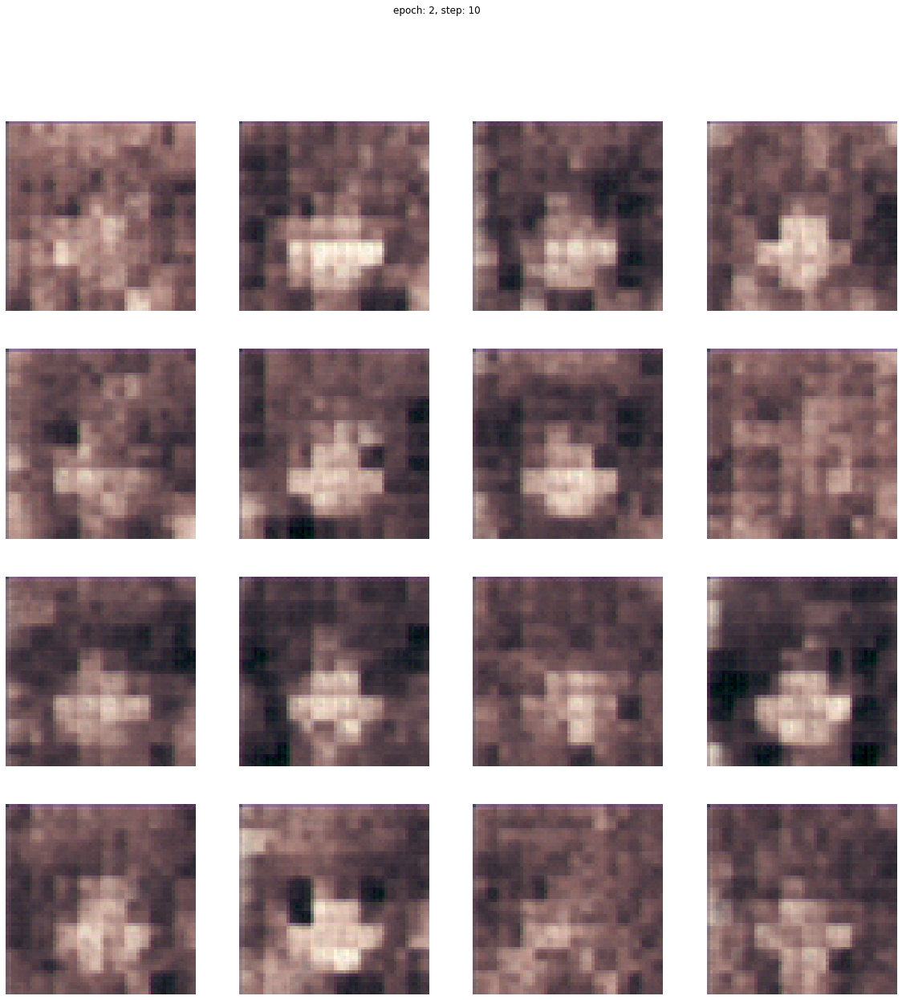

Epoch: 2 step: 10 mean loss = 1061.489
Epoch: 2 step: 11 mean loss = 1060.4015
Epoch: 2 step: 12 mean loss = 1059.3198
Epoch: 2 step: 13 mean loss = 1058.2395
Epoch: 2 step: 14 mean loss = 1057.1611
Epoch: 2 step: 15 mean loss = 1056.0815
Epoch: 2 step: 16 mean loss = 1055.0135
Epoch: 2 step: 17 mean loss = 1053.9459
Epoch: 2 step: 18 mean loss = 1052.8806
Epoch: 2 step: 19 mean loss = 1051.8213


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


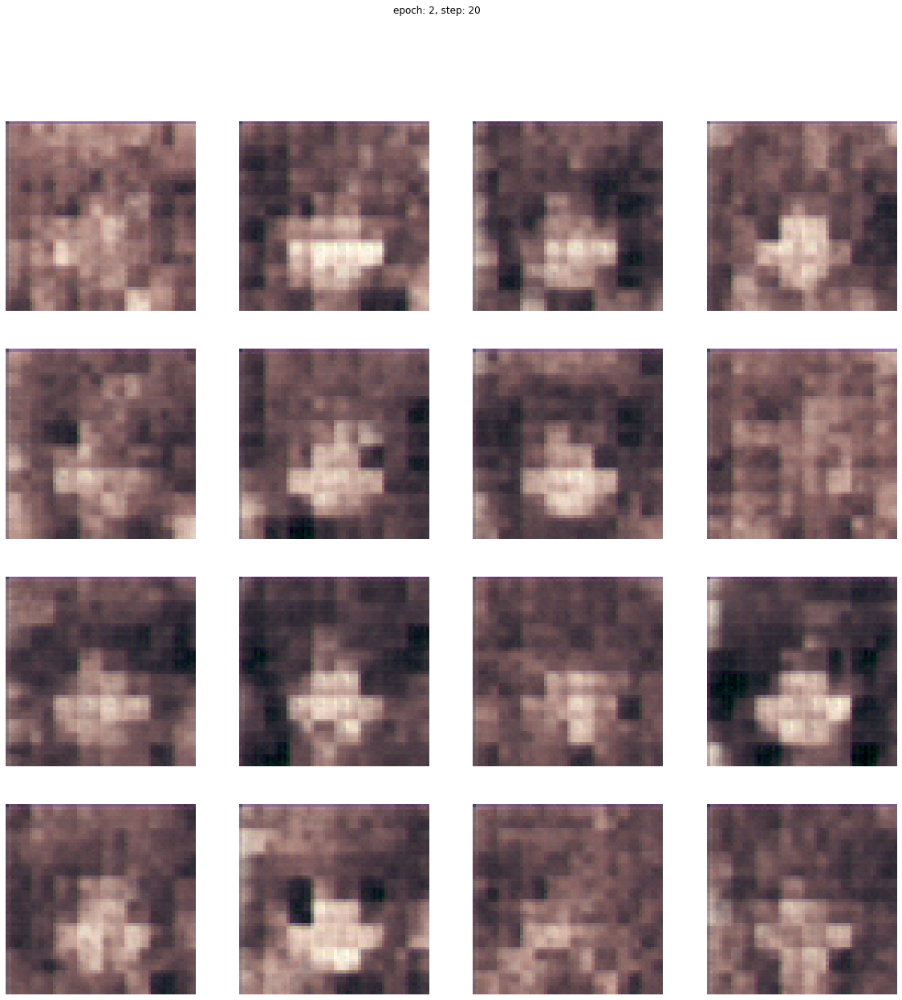

Epoch: 2 step: 20 mean loss = 1050.7683
Epoch: 2 step: 21 mean loss = 1049.7316
Epoch: 2 step: 22 mean loss = 1048.702
Epoch: 2 step: 23 mean loss = 1047.6661
Epoch: 2 step: 24 mean loss = 1046.6246
Epoch: 2 step: 25 mean loss = 1045.5874
Start of epoch 3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


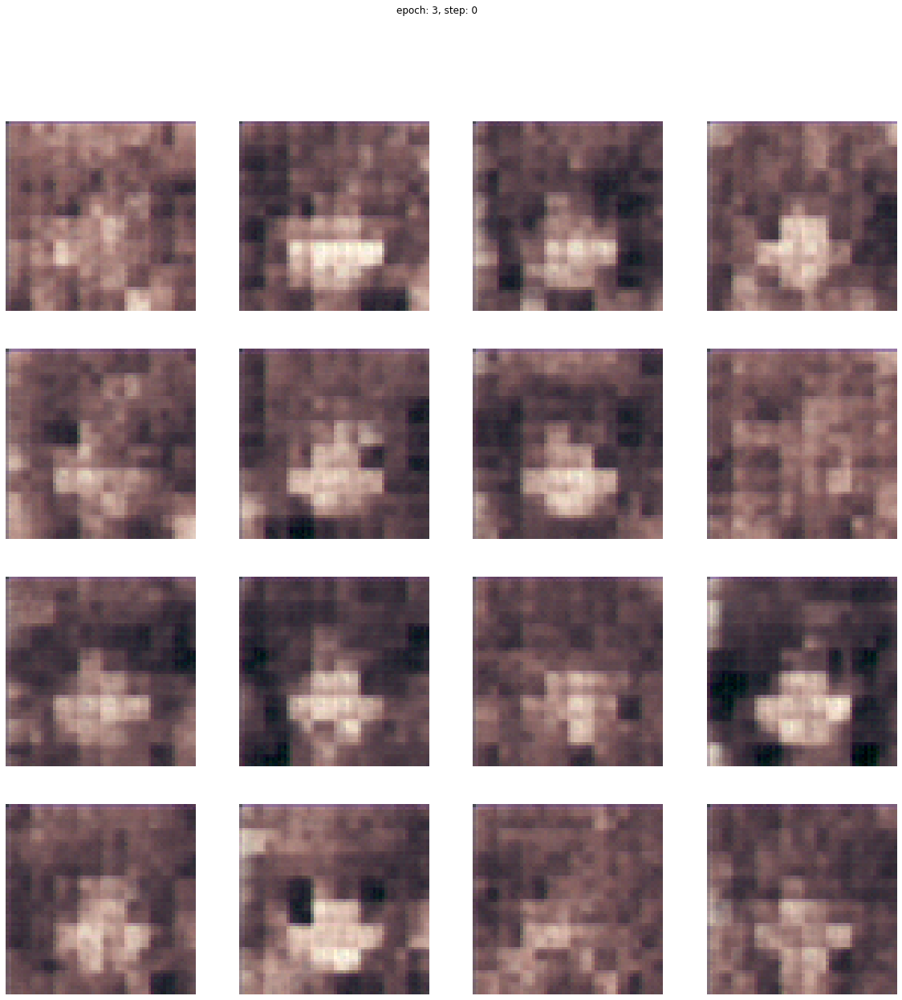

Epoch: 3 step: 0 mean loss = 1044.5414
Epoch: 3 step: 1 mean loss = 1043.498
Epoch: 3 step: 2 mean loss = 1042.4694
Epoch: 3 step: 3 mean loss = 1041.4346
Epoch: 3 step: 4 mean loss = 1040.4001
Epoch: 3 step: 5 mean loss = 1039.3721
Epoch: 3 step: 6 mean loss = 1038.3494
Epoch: 3 step: 7 mean loss = 1037.3275
Epoch: 3 step: 8 mean loss = 1036.3003
Epoch: 3 step: 9 mean loss = 1035.282


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


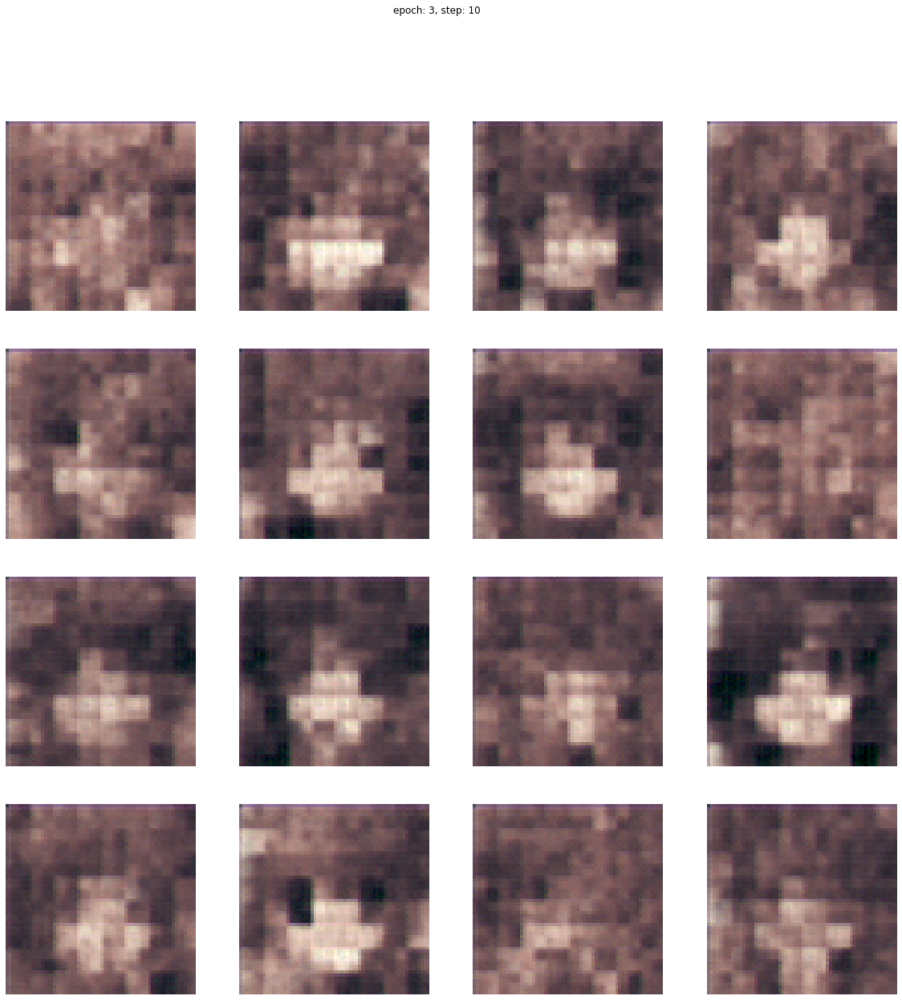

Epoch: 3 step: 10 mean loss = 1034.272
Epoch: 3 step: 11 mean loss = 1033.2612
Epoch: 3 step: 12 mean loss = 1032.2455
Epoch: 3 step: 13 mean loss = 1031.242
Epoch: 3 step: 14 mean loss = 1030.2384
Epoch: 3 step: 15 mean loss = 1029.2358
Epoch: 3 step: 16 mean loss = 1028.2402
Epoch: 3 step: 17 mean loss = 1027.2383
Epoch: 3 step: 18 mean loss = 1026.2468
Epoch: 3 step: 19 mean loss = 1025.2502


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


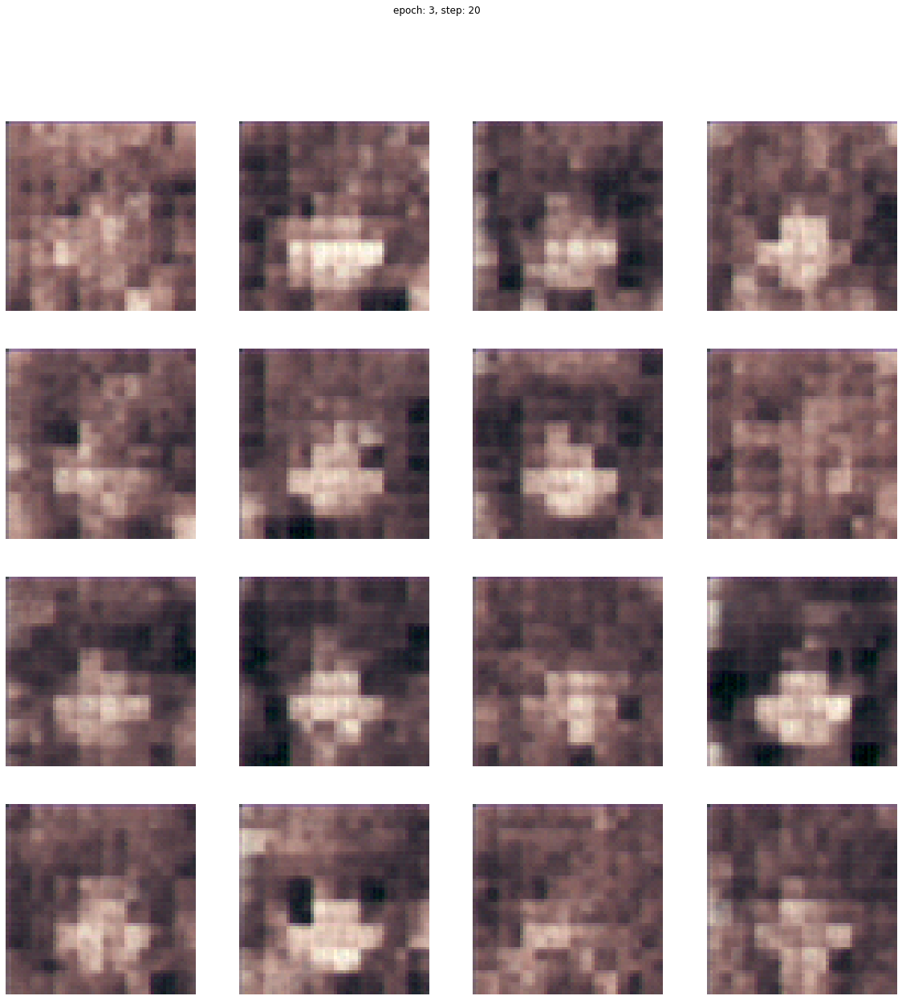

Epoch: 3 step: 20 mean loss = 1024.2577
Epoch: 3 step: 21 mean loss = 1023.2738
Epoch: 3 step: 22 mean loss = 1022.2886
Epoch: 3 step: 23 mean loss = 1021.3052
Epoch: 3 step: 24 mean loss = 1020.3239
Epoch: 3 step: 25 mean loss = 1019.355
Start of epoch 4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


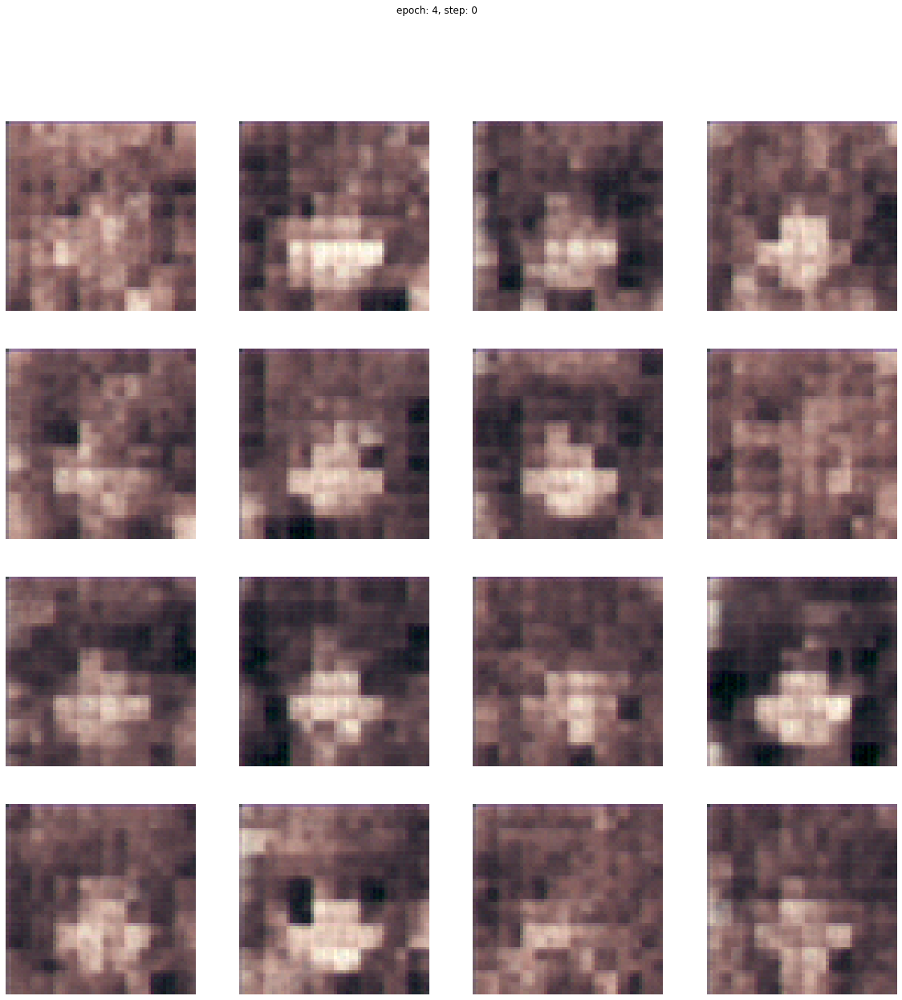

Epoch: 4 step: 0 mean loss = 1018.368
Epoch: 4 step: 1 mean loss = 1017.3902
Epoch: 4 step: 2 mean loss = 1016.4224
Epoch: 4 step: 3 mean loss = 1015.4582
Epoch: 4 step: 4 mean loss = 1014.4907
Epoch: 4 step: 5 mean loss = 1013.52826
Epoch: 4 step: 6 mean loss = 1012.5666
Epoch: 4 step: 7 mean loss = 1011.60614
Epoch: 4 step: 8 mean loss = 1010.6496
Epoch: 4 step: 9 mean loss = 1009.69965


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


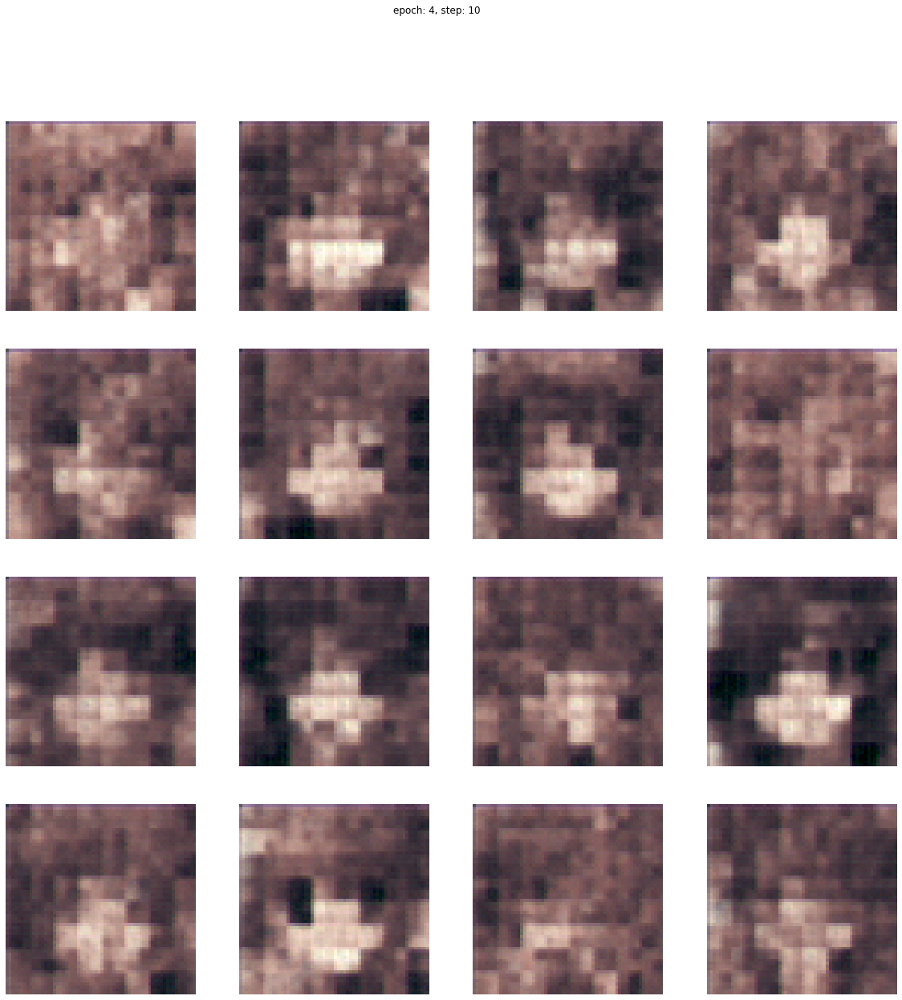

Epoch: 4 step: 10 mean loss = 1008.7499
Epoch: 4 step: 11 mean loss = 1007.8074
Epoch: 4 step: 12 mean loss = 1006.87555
Epoch: 4 step: 13 mean loss = 1005.961
Epoch: 4 step: 14 mean loss = 1005.07007
Epoch: 4 step: 15 mean loss = 1004.19196
Epoch: 4 step: 16 mean loss = 1003.28973
Epoch: 4 step: 17 mean loss = 1002.3658
Epoch: 4 step: 18 mean loss = 1001.4516
Epoch: 4 step: 19 mean loss = 1000.54645


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


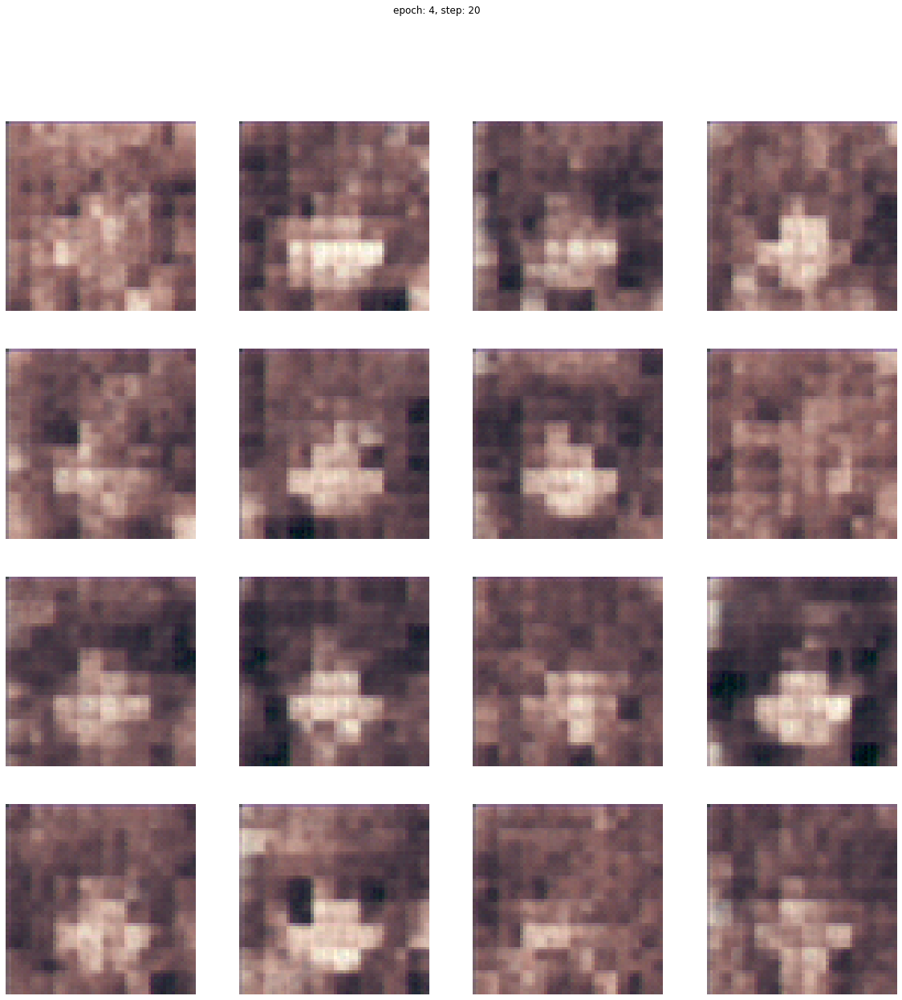

Epoch: 4 step: 20 mean loss = 999.6244
Epoch: 4 step: 21 mean loss = 998.7162
Epoch: 4 step: 22 mean loss = 997.8061
Epoch: 4 step: 23 mean loss = 996.89197
Epoch: 4 step: 24 mean loss = 995.9871
Epoch: 4 step: 25 mean loss = 995.08435
Start of epoch 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


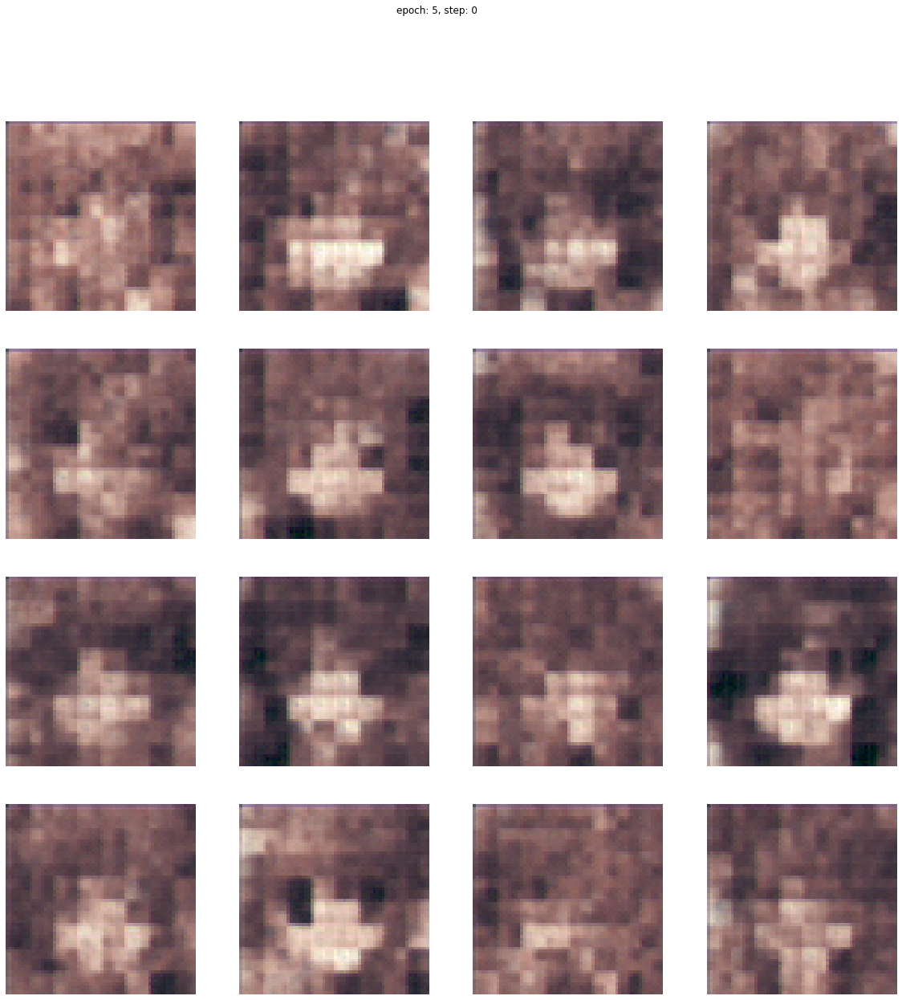

Epoch: 5 step: 0 mean loss = 994.1646
Epoch: 5 step: 1 mean loss = 993.25574
Epoch: 5 step: 2 mean loss = 992.3564
Epoch: 5 step: 3 mean loss = 991.45764
Epoch: 5 step: 4 mean loss = 990.55975
Epoch: 5 step: 5 mean loss = 989.6573
Epoch: 5 step: 6 mean loss = 988.7652
Epoch: 5 step: 7 mean loss = 987.86804
Epoch: 5 step: 8 mean loss = 986.96704
Epoch: 5 step: 9 mean loss = 986.0811


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


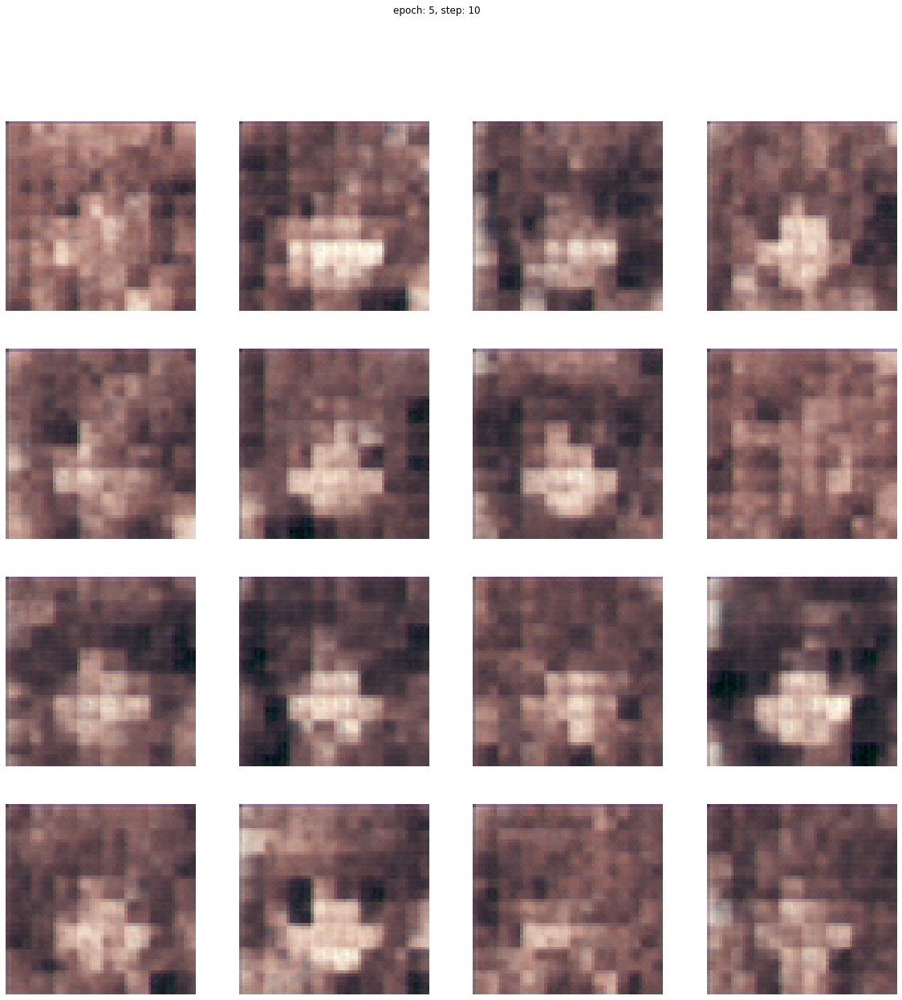

Epoch: 5 step: 10 mean loss = 985.18555
Epoch: 5 step: 11 mean loss = 984.29834
Epoch: 5 step: 12 mean loss = 983.4128
Epoch: 5 step: 13 mean loss = 982.52625
Epoch: 5 step: 14 mean loss = 981.63934
Epoch: 5 step: 15 mean loss = 980.7625
Epoch: 5 step: 16 mean loss = 979.879
Epoch: 5 step: 17 mean loss = 979.0016
Epoch: 5 step: 18 mean loss = 978.125
Epoch: 5 step: 19 mean loss = 977.246


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


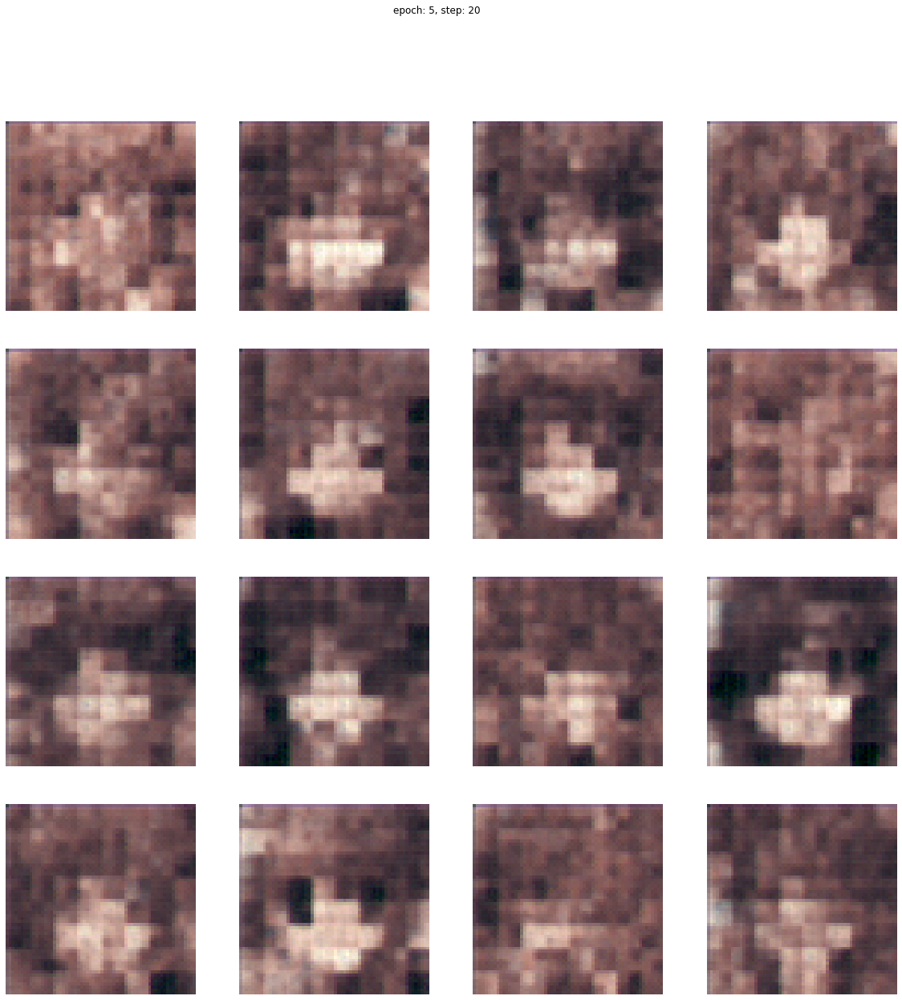

Epoch: 5 step: 20 mean loss = 976.37274
Epoch: 5 step: 21 mean loss = 975.4978
Epoch: 5 step: 22 mean loss = 974.62665
Epoch: 5 step: 23 mean loss = 973.76184
Epoch: 5 step: 24 mean loss = 972.8956
Epoch: 5 step: 25 mean loss = 972.0299
Start of epoch 6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


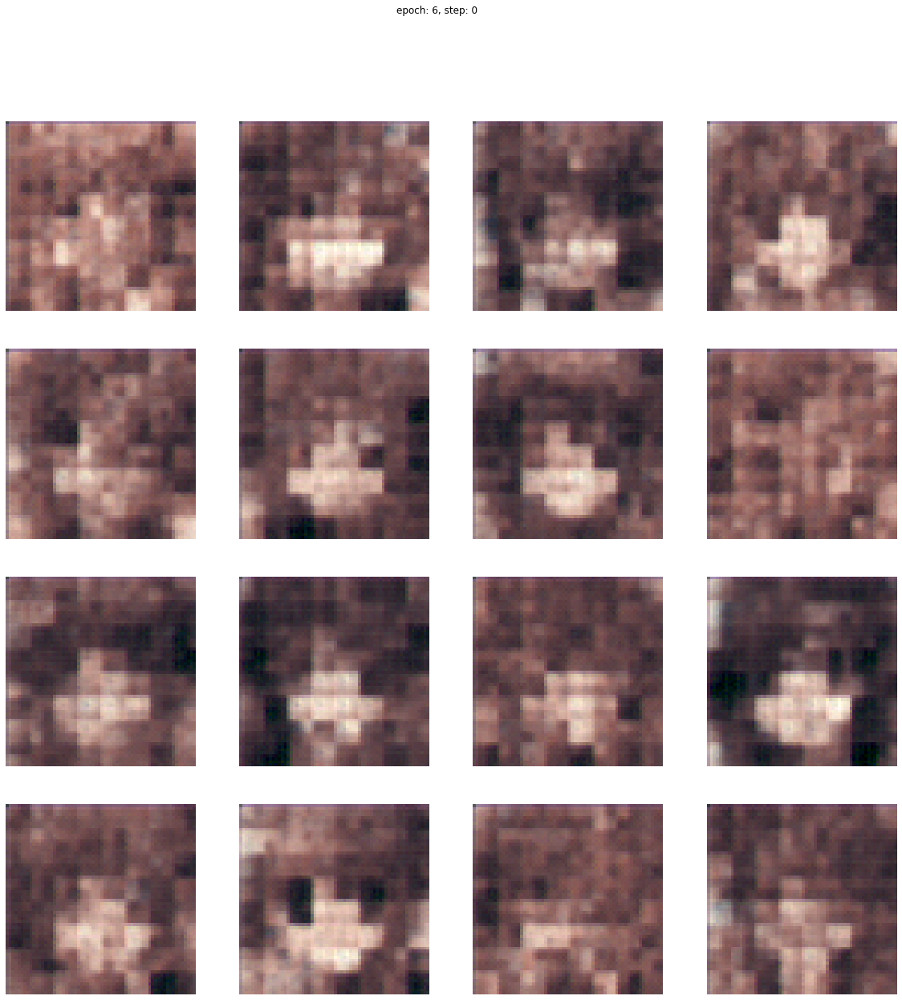

Epoch: 6 step: 0 mean loss = 971.1544
Epoch: 6 step: 1 mean loss = 970.2868
Epoch: 6 step: 2 mean loss = 969.4315
Epoch: 6 step: 3 mean loss = 968.57227
Epoch: 6 step: 4 mean loss = 967.71063
Epoch: 6 step: 5 mean loss = 966.8525
Epoch: 6 step: 6 mean loss = 965.99744
Epoch: 6 step: 7 mean loss = 965.1438
Epoch: 6 step: 8 mean loss = 964.28723
Epoch: 6 step: 9 mean loss = 963.43536


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


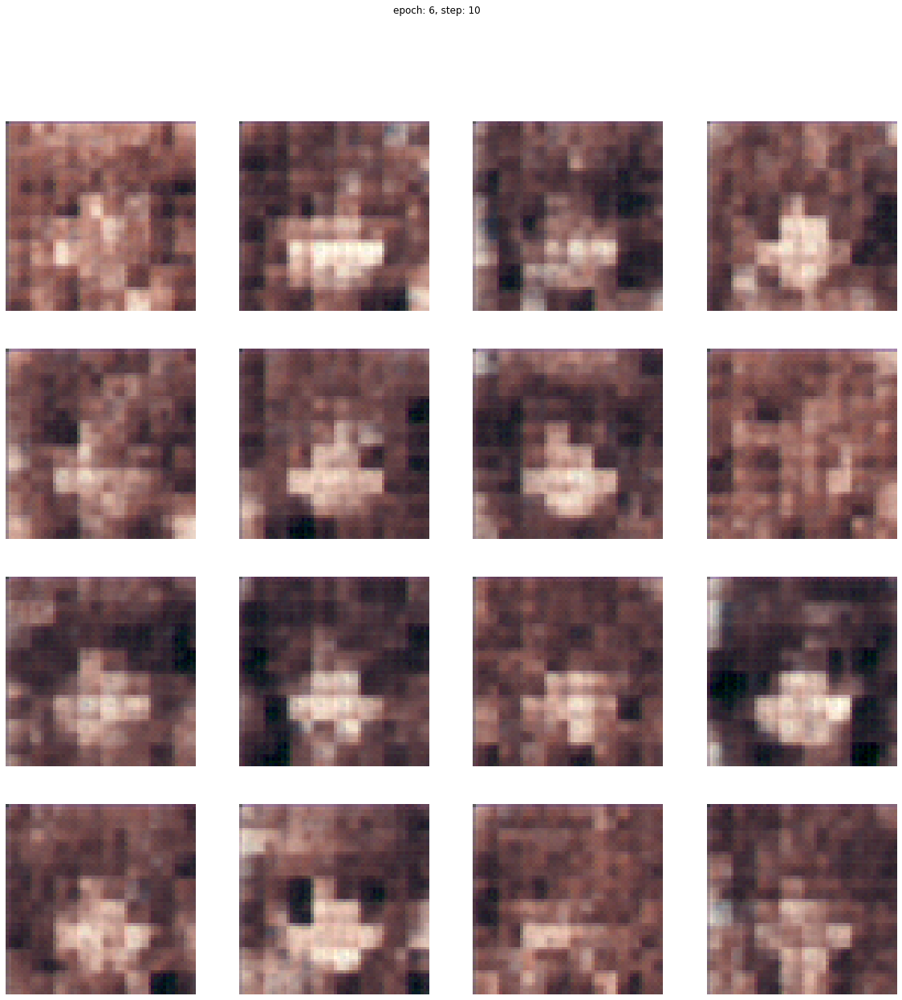

Epoch: 6 step: 10 mean loss = 962.5845
Epoch: 6 step: 11 mean loss = 961.7382
Epoch: 6 step: 12 mean loss = 960.898
Epoch: 6 step: 13 mean loss = 960.06647
Epoch: 6 step: 14 mean loss = 959.2558
Epoch: 6 step: 15 mean loss = 958.4834
Epoch: 6 step: 16 mean loss = 957.71765
Epoch: 6 step: 17 mean loss = 956.9222
Epoch: 6 step: 18 mean loss = 956.1292
Epoch: 6 step: 19 mean loss = 955.3036


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


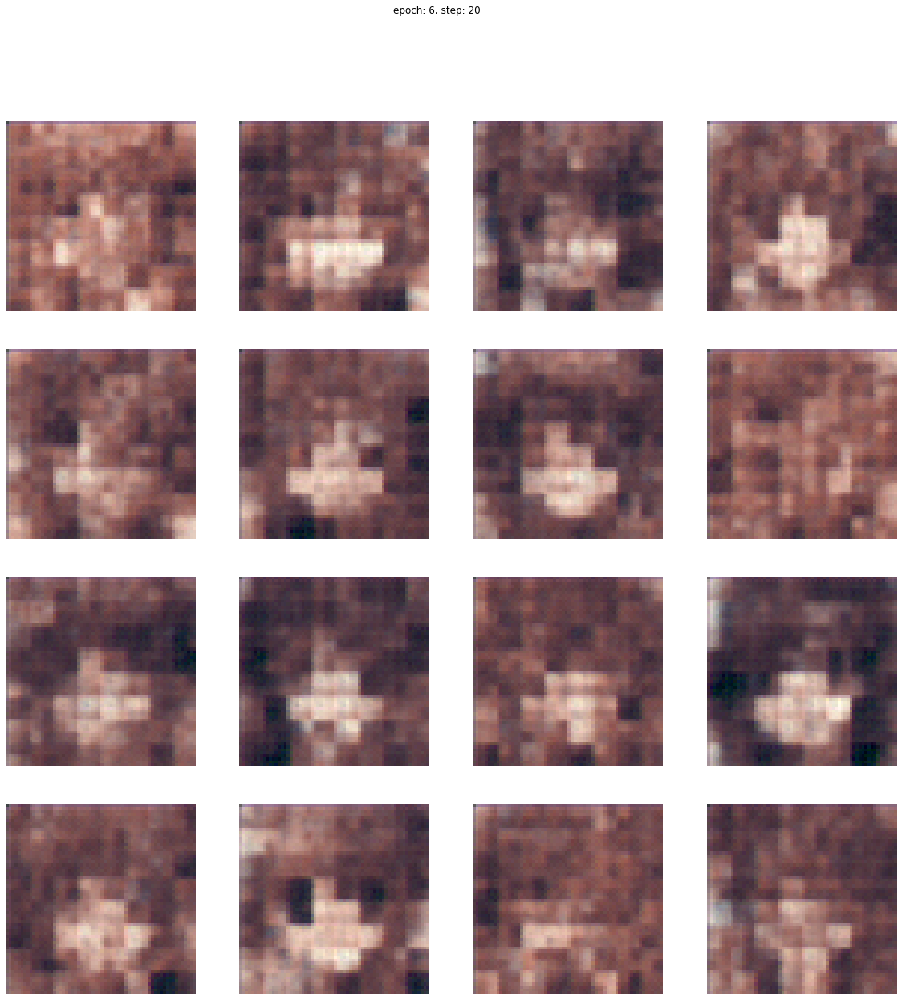

Epoch: 6 step: 20 mean loss = 954.50183
Epoch: 6 step: 21 mean loss = 953.67957
Epoch: 6 step: 22 mean loss = 952.8713
Epoch: 6 step: 23 mean loss = 952.0591
Epoch: 6 step: 24 mean loss = 951.2489
Epoch: 6 step: 25 mean loss = 950.4445
Start of epoch 7


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


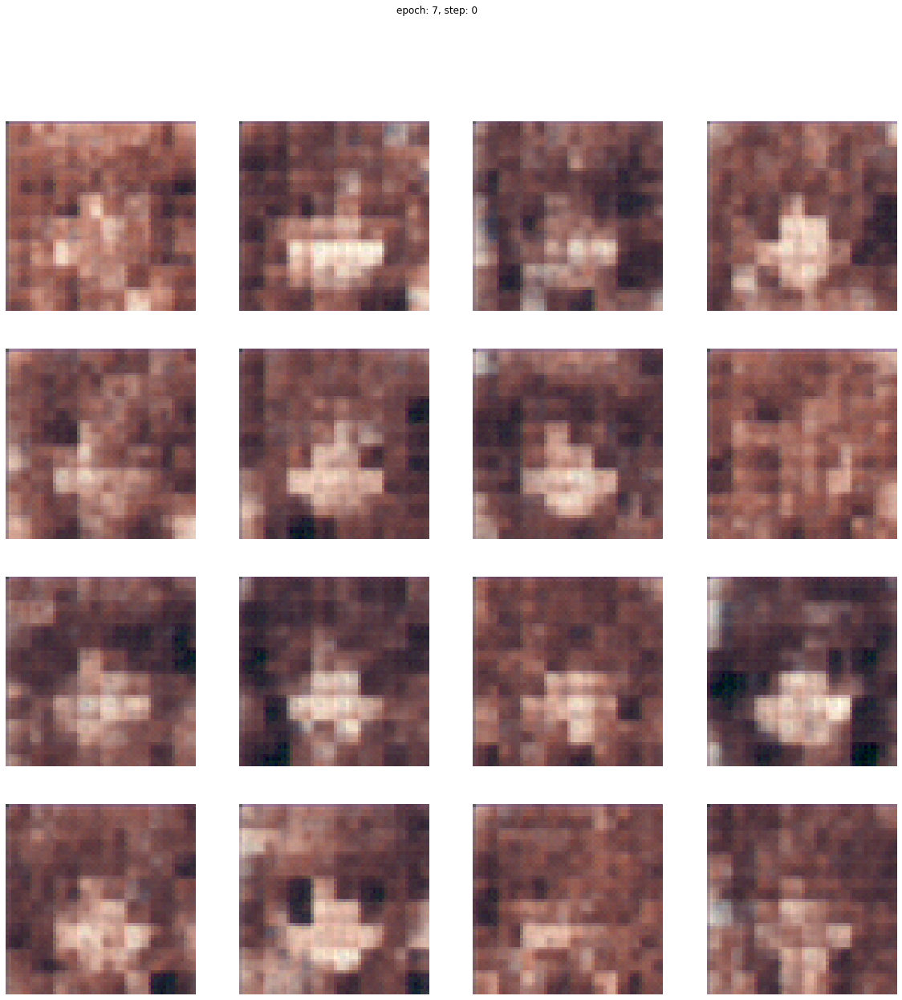

Epoch: 7 step: 0 mean loss = 949.626
Epoch: 7 step: 1 mean loss = 948.8118
Epoch: 7 step: 2 mean loss = 948.00183
Epoch: 7 step: 3 mean loss = 947.19434
Epoch: 7 step: 4 mean loss = 946.3876
Epoch: 7 step: 5 mean loss = 945.5745
Epoch: 7 step: 6 mean loss = 944.76965
Epoch: 7 step: 7 mean loss = 943.9672
Epoch: 7 step: 8 mean loss = 943.1572
Epoch: 7 step: 9 mean loss = 942.35486


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


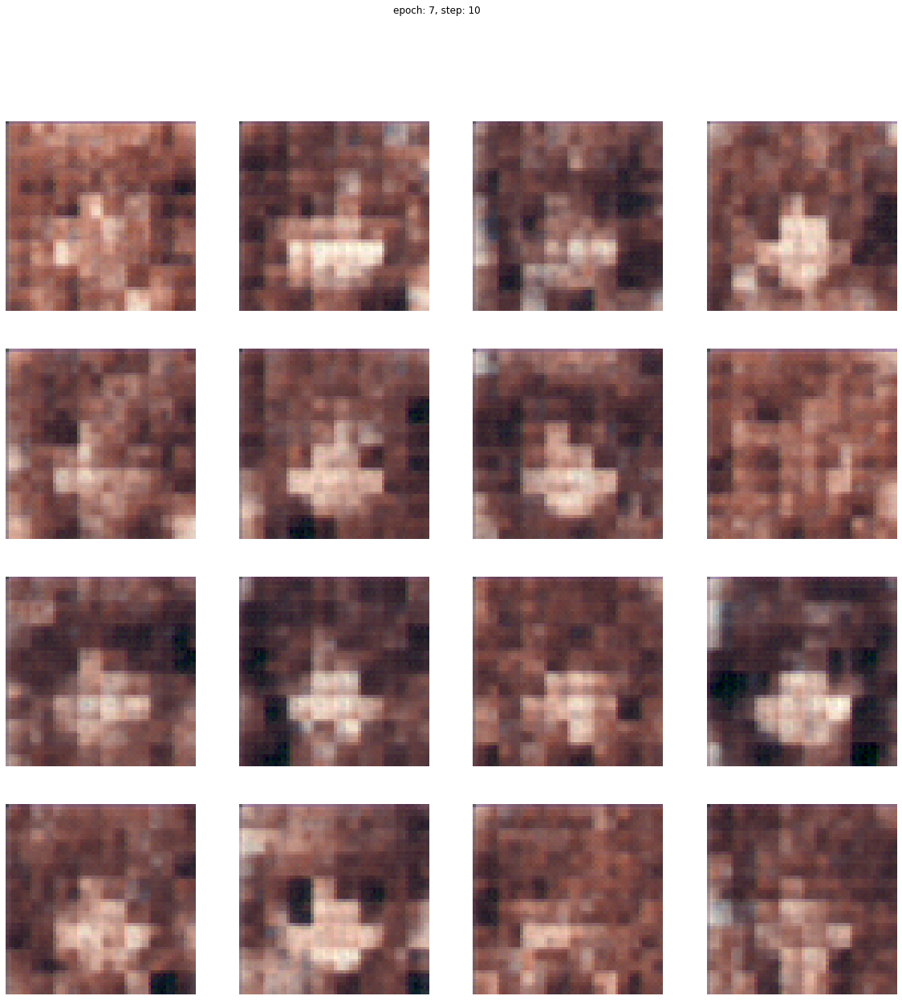

Epoch: 7 step: 10 mean loss = 941.5535
Epoch: 7 step: 11 mean loss = 940.75256
Epoch: 7 step: 12 mean loss = 939.95337
Epoch: 7 step: 13 mean loss = 939.15344
Epoch: 7 step: 14 mean loss = 938.3576
Epoch: 7 step: 15 mean loss = 937.5562
Epoch: 7 step: 16 mean loss = 936.764
Epoch: 7 step: 17 mean loss = 935.9724
Epoch: 7 step: 18 mean loss = 935.1817
Epoch: 7 step: 19 mean loss = 934.3893


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


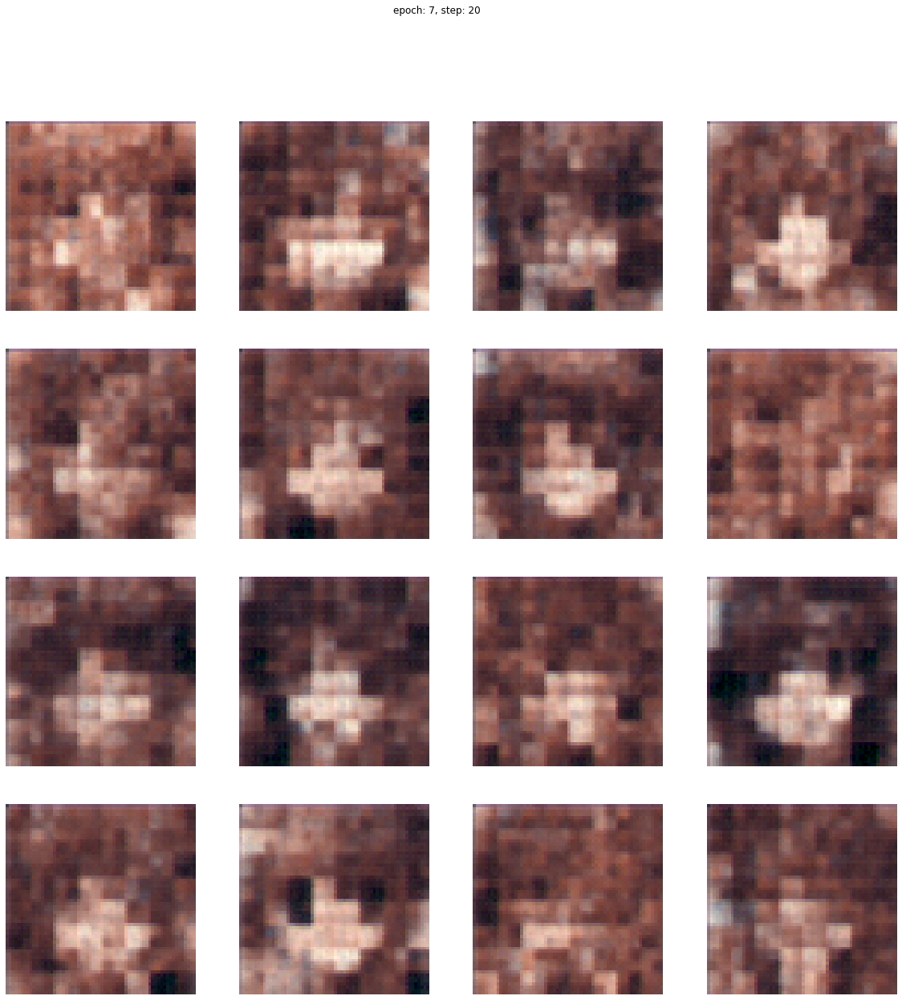

Epoch: 7 step: 20 mean loss = 933.5969
Epoch: 7 step: 21 mean loss = 932.80927
Epoch: 7 step: 22 mean loss = 932.01996
Epoch: 7 step: 23 mean loss = 931.23785
Epoch: 7 step: 24 mean loss = 930.4556
Epoch: 7 step: 25 mean loss = 929.67725
Start of epoch 8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


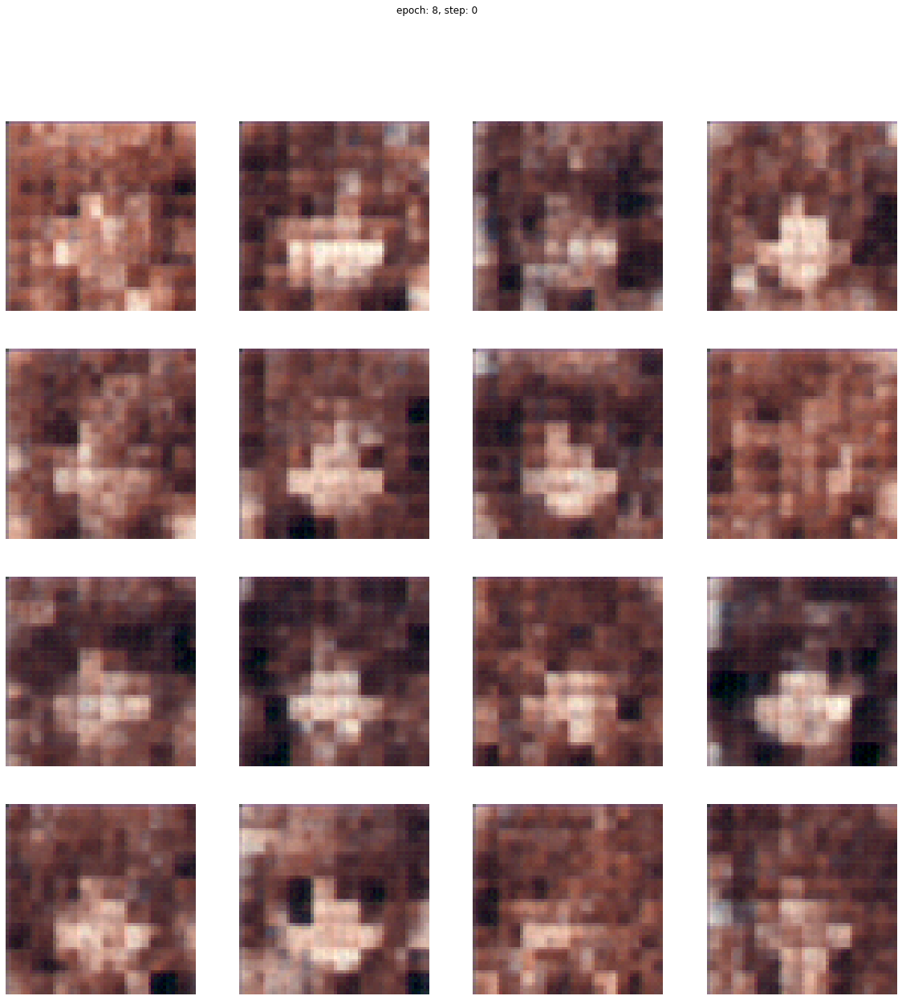

Epoch: 8 step: 0 mean loss = 928.88855
Epoch: 8 step: 1 mean loss = 928.10516
Epoch: 8 step: 2 mean loss = 927.32996
Epoch: 8 step: 3 mean loss = 926.55914
Epoch: 8 step: 4 mean loss = 925.7881
Epoch: 8 step: 5 mean loss = 925.0147
Epoch: 8 step: 6 mean loss = 924.25305
Epoch: 8 step: 7 mean loss = 923.4908
Epoch: 8 step: 8 mean loss = 922.7355
Epoch: 8 step: 9 mean loss = 921.9911


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


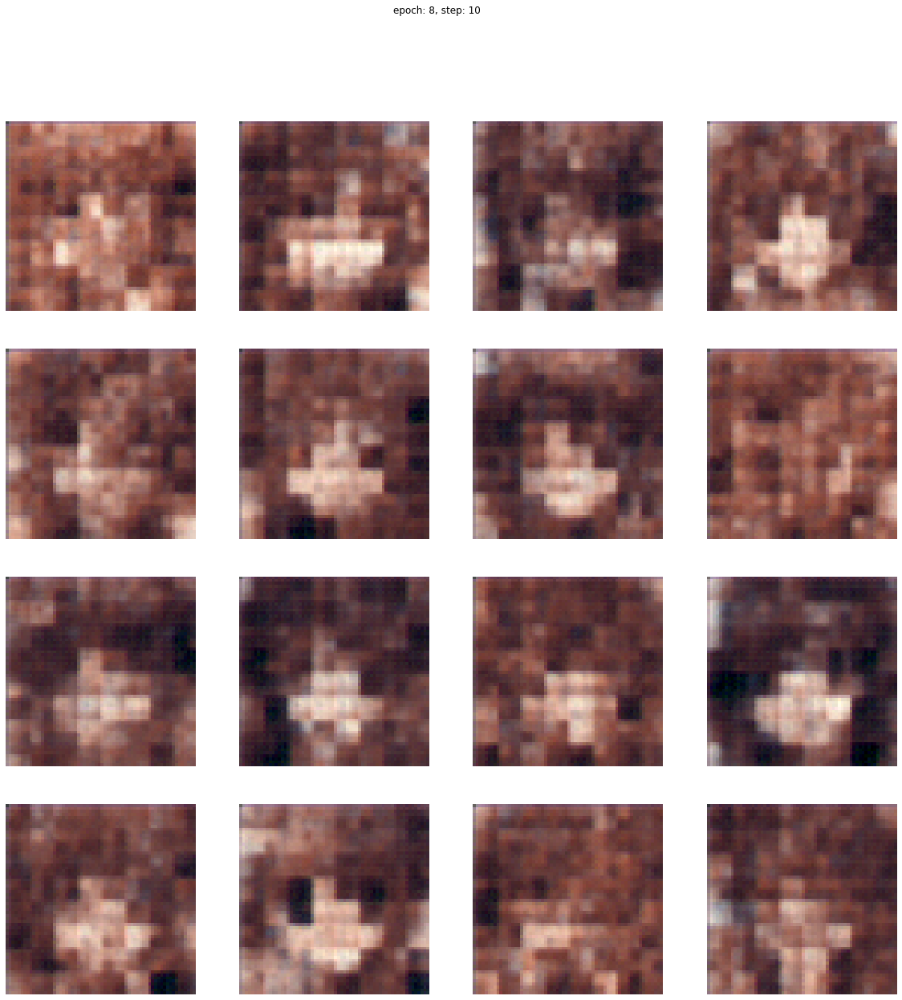

Epoch: 8 step: 10 mean loss = 921.2542
Epoch: 8 step: 11 mean loss = 920.5104
Epoch: 8 step: 12 mean loss = 919.75305
Epoch: 8 step: 13 mean loss = 918.99664
Epoch: 8 step: 14 mean loss = 918.2485
Epoch: 8 step: 15 mean loss = 917.5042
Epoch: 8 step: 16 mean loss = 916.75354
Epoch: 8 step: 17 mean loss = 916.0005
Epoch: 8 step: 18 mean loss = 915.2546
Epoch: 8 step: 19 mean loss = 914.5072


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


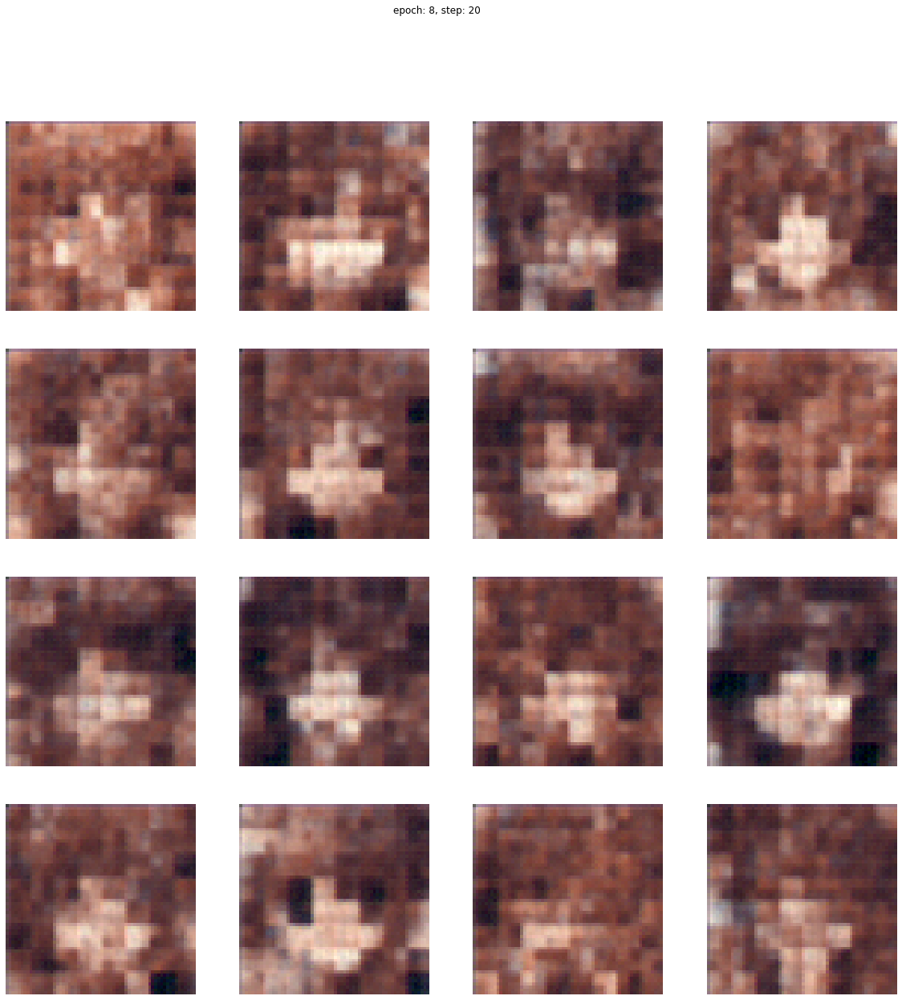

Epoch: 8 step: 20 mean loss = 913.76135
Epoch: 8 step: 21 mean loss = 913.0158
Epoch: 8 step: 22 mean loss = 912.27203
Epoch: 8 step: 23 mean loss = 911.5345
Epoch: 8 step: 24 mean loss = 910.79333
Epoch: 8 step: 25 mean loss = 910.0528
Start of epoch 9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


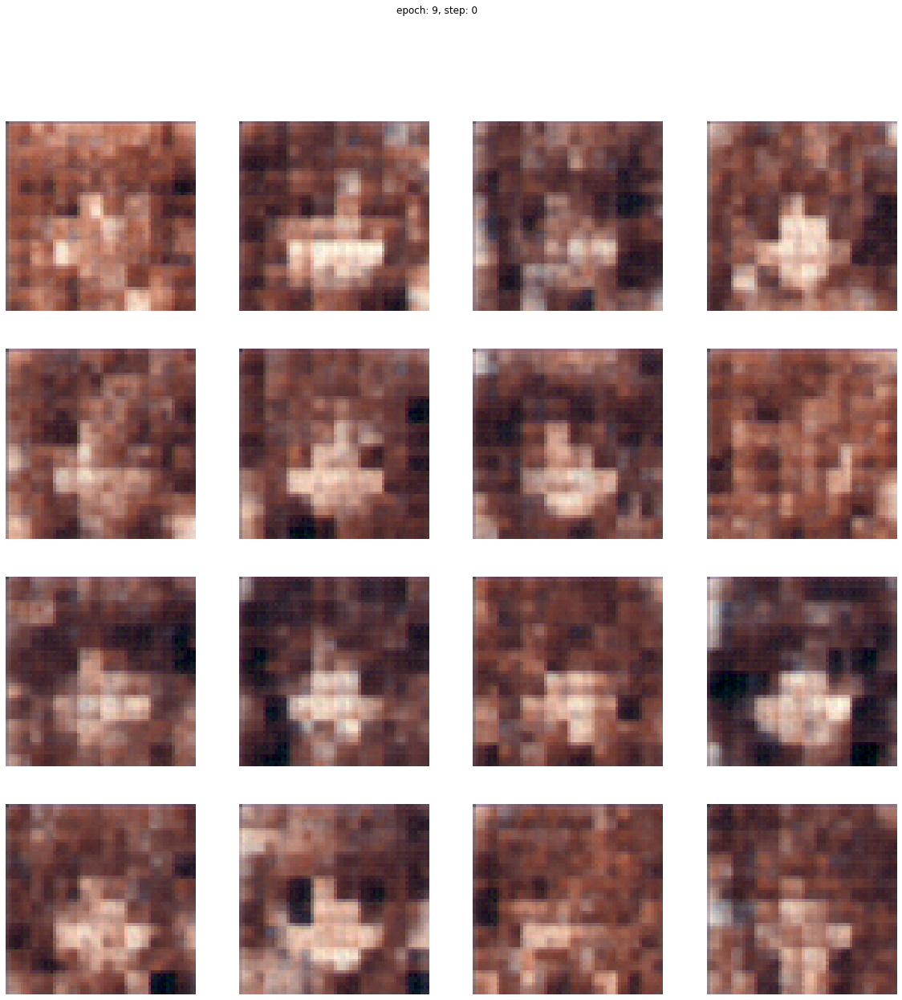

Epoch: 9 step: 0 mean loss = 909.3078
Epoch: 9 step: 1 mean loss = 908.57184
Epoch: 9 step: 2 mean loss = 907.8397
Epoch: 9 step: 3 mean loss = 907.10767
Epoch: 9 step: 4 mean loss = 906.3774
Epoch: 9 step: 5 mean loss = 905.645
Epoch: 9 step: 6 mean loss = 904.9197
Epoch: 9 step: 7 mean loss = 904.1907
Epoch: 9 step: 8 mean loss = 903.46014
Epoch: 9 step: 9 mean loss = 902.73566


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


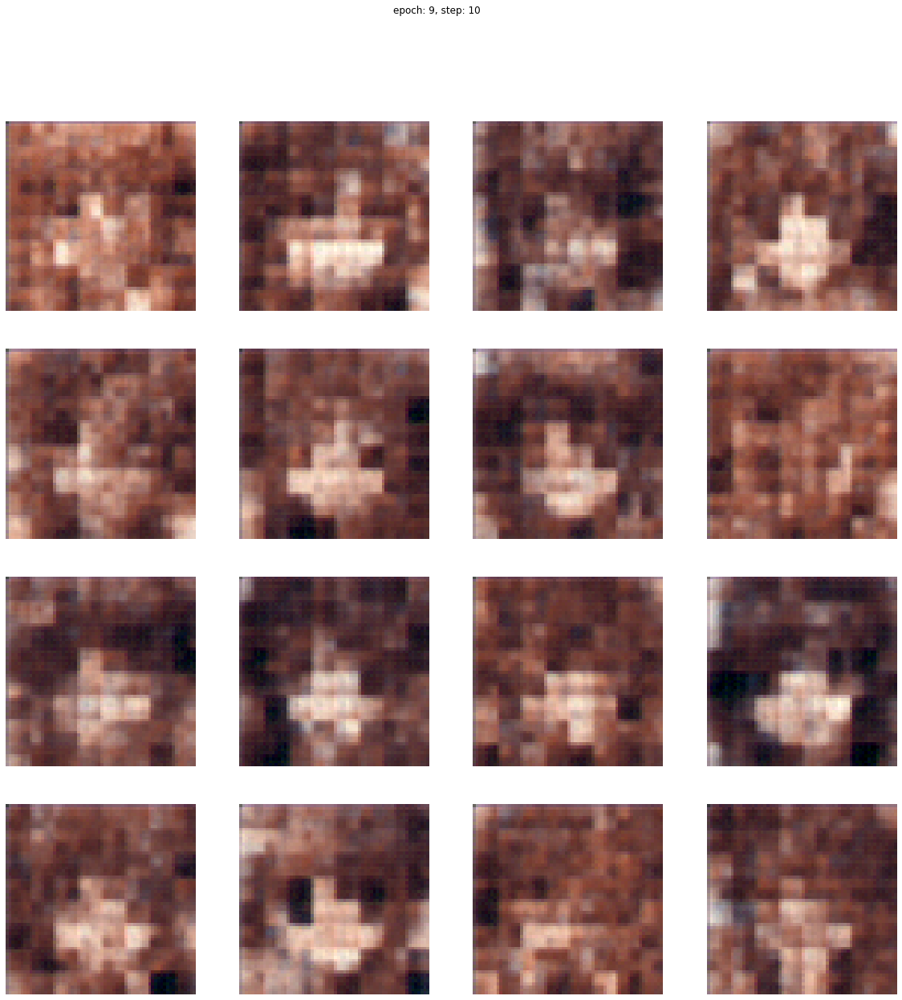

Epoch: 9 step: 10 mean loss = 902.01373
Epoch: 9 step: 11 mean loss = 901.2901
Epoch: 9 step: 12 mean loss = 900.57135
Epoch: 9 step: 13 mean loss = 899.8547
Epoch: 9 step: 14 mean loss = 899.136
Epoch: 9 step: 15 mean loss = 898.4202
Epoch: 9 step: 16 mean loss = 897.7035
Epoch: 9 step: 17 mean loss = 896.99347
Epoch: 9 step: 18 mean loss = 896.28644
Epoch: 9 step: 19 mean loss = 895.57416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


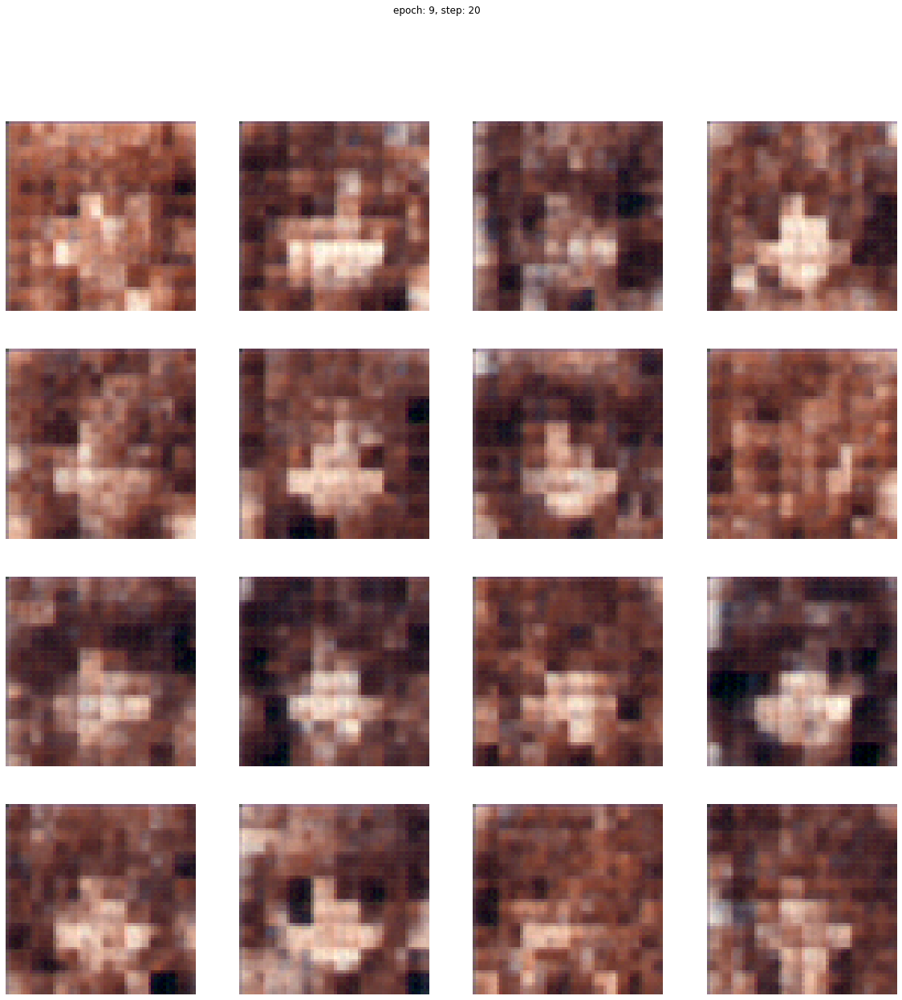

Epoch: 9 step: 20 mean loss = 894.8657
Epoch: 9 step: 21 mean loss = 894.1592
Epoch: 9 step: 22 mean loss = 893.4552
Epoch: 9 step: 23 mean loss = 892.754
Epoch: 9 step: 24 mean loss = 892.05695
Epoch: 9 step: 25 mean loss = 891.36554
Start of epoch 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


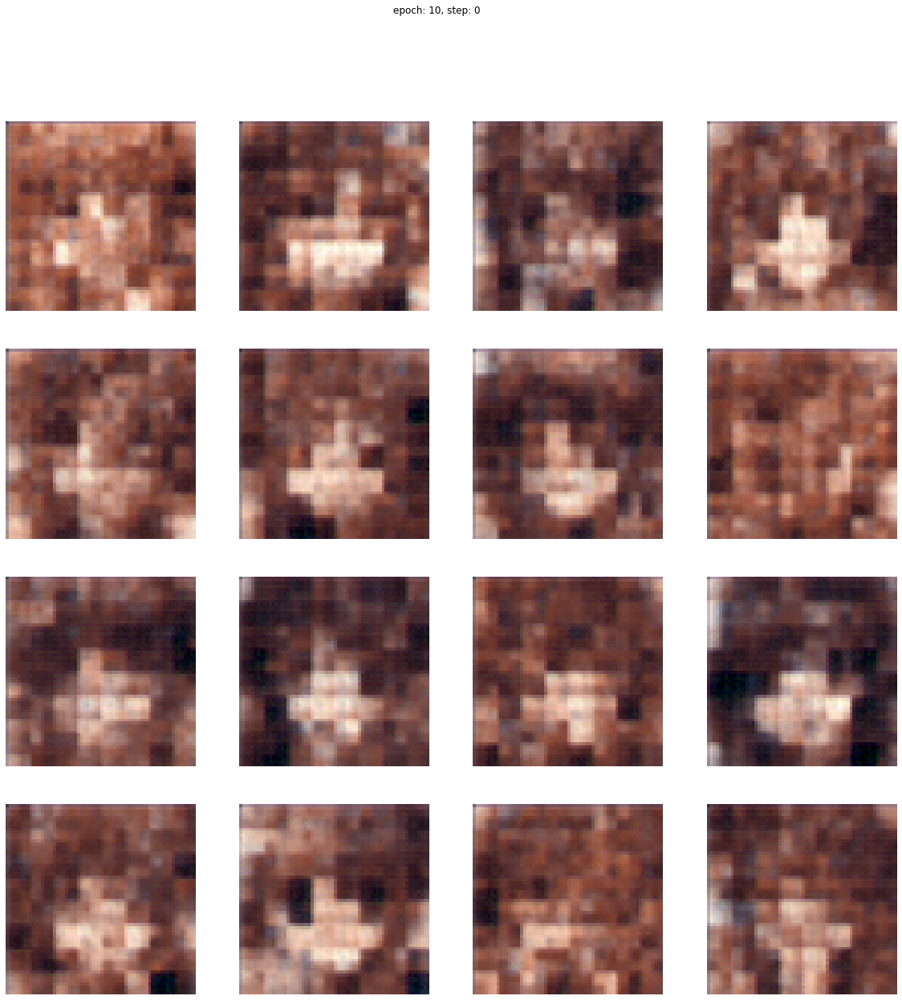

Epoch: 10 step: 0 mean loss = 890.67084
Epoch: 10 step: 1 mean loss = 889.982
Epoch: 10 step: 2 mean loss = 889.30774
Epoch: 10 step: 3 mean loss = 888.62103
Epoch: 10 step: 4 mean loss = 887.9327
Epoch: 10 step: 5 mean loss = 887.2434
Epoch: 10 step: 6 mean loss = 886.55664
Epoch: 10 step: 7 mean loss = 885.8703
Epoch: 10 step: 8 mean loss = 885.18774
Epoch: 10 step: 9 mean loss = 884.50256


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


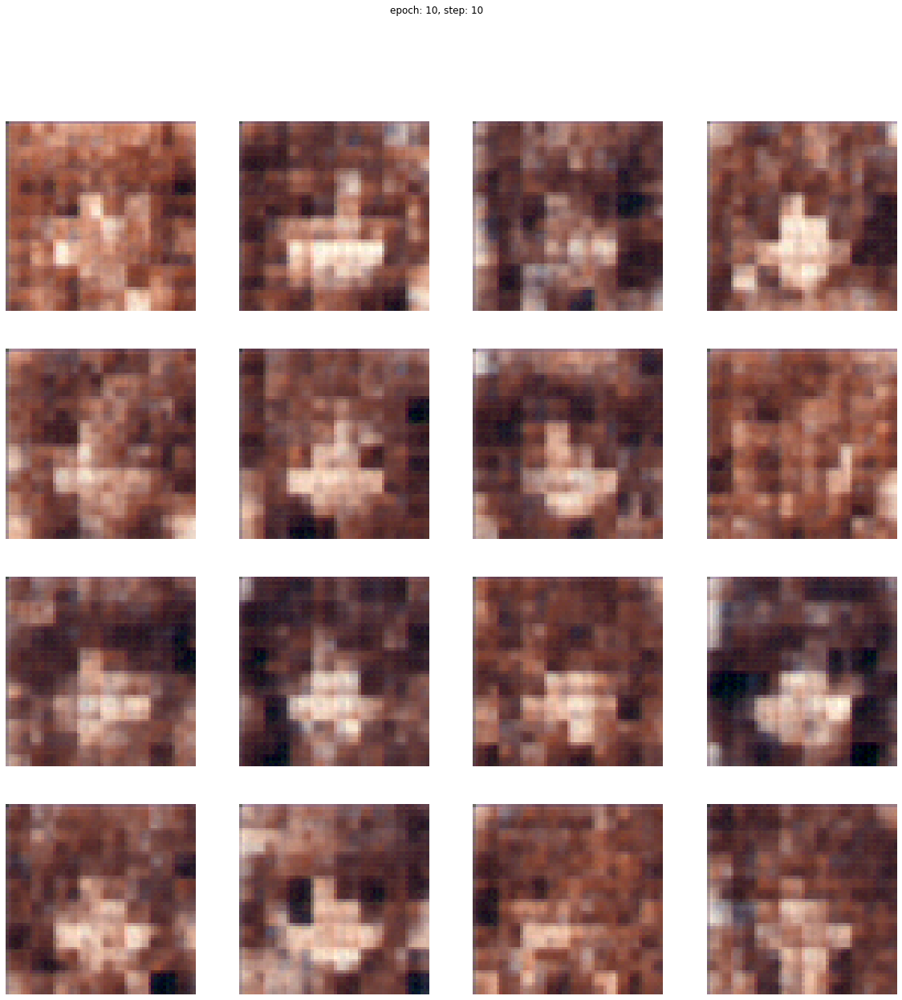

Epoch: 10 step: 10 mean loss = 883.81415
Epoch: 10 step: 11 mean loss = 883.13824
Epoch: 10 step: 12 mean loss = 882.4594
Epoch: 10 step: 13 mean loss = 881.779
Epoch: 10 step: 14 mean loss = 881.1023
Epoch: 10 step: 15 mean loss = 880.4209
Epoch: 10 step: 16 mean loss = 879.7483
Epoch: 10 step: 17 mean loss = 879.07367
Epoch: 10 step: 18 mean loss = 878.4055
Epoch: 10 step: 19 mean loss = 877.7278


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


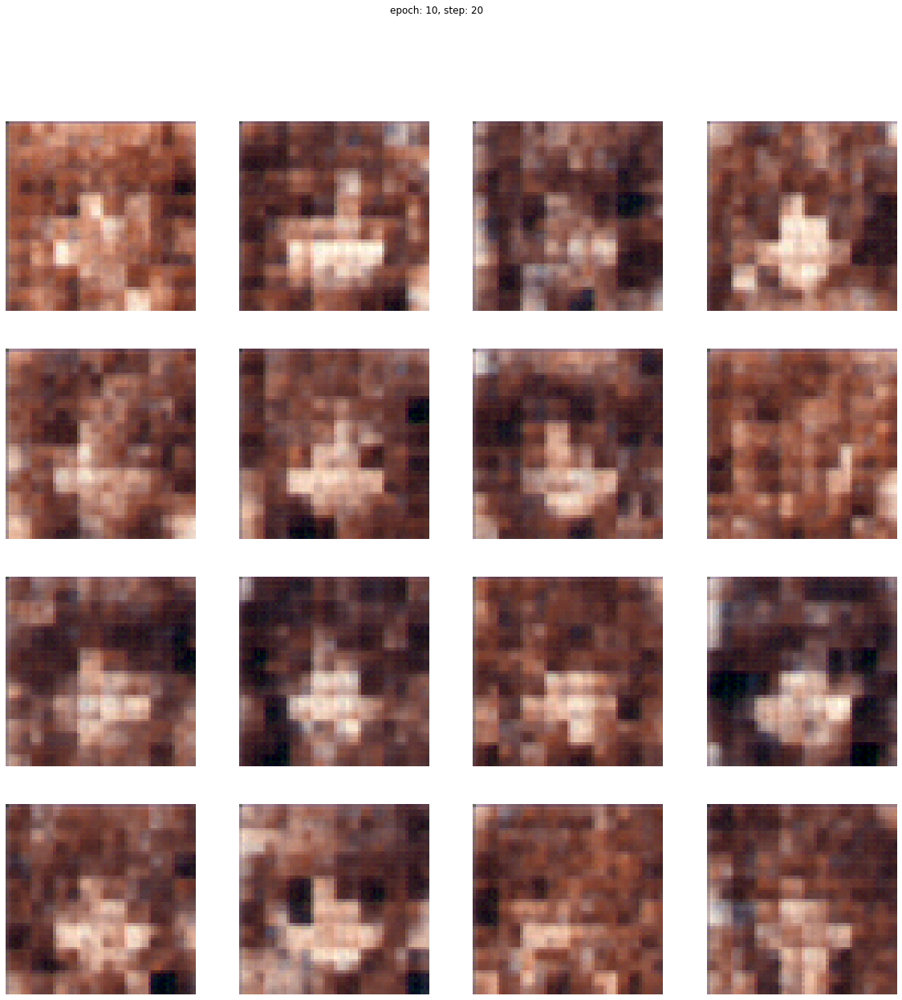

Epoch: 10 step: 20 mean loss = 877.05786
Epoch: 10 step: 21 mean loss = 876.38727
Epoch: 10 step: 22 mean loss = 875.7189
Epoch: 10 step: 23 mean loss = 875.0533
Epoch: 10 step: 24 mean loss = 874.38806
Epoch: 10 step: 25 mean loss = 873.72253
Start of epoch 11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


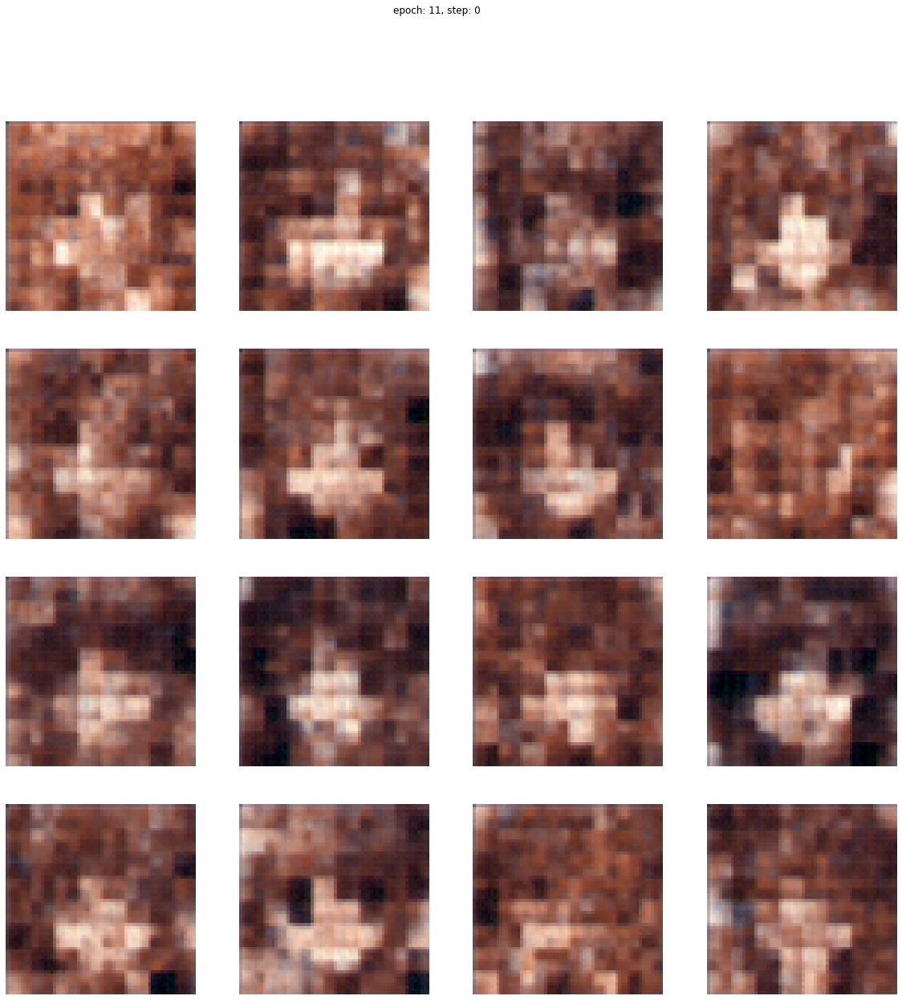

Epoch: 11 step: 0 mean loss = 873.0517
Epoch: 11 step: 1 mean loss = 872.387
Epoch: 11 step: 2 mean loss = 871.73083
Epoch: 11 step: 3 mean loss = 871.07275
Epoch: 11 step: 4 mean loss = 870.4166
Epoch: 11 step: 5 mean loss = 869.758
Epoch: 11 step: 6 mean loss = 869.1046
Epoch: 11 step: 7 mean loss = 868.4501
Epoch: 11 step: 8 mean loss = 867.797
Epoch: 11 step: 9 mean loss = 867.1526


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

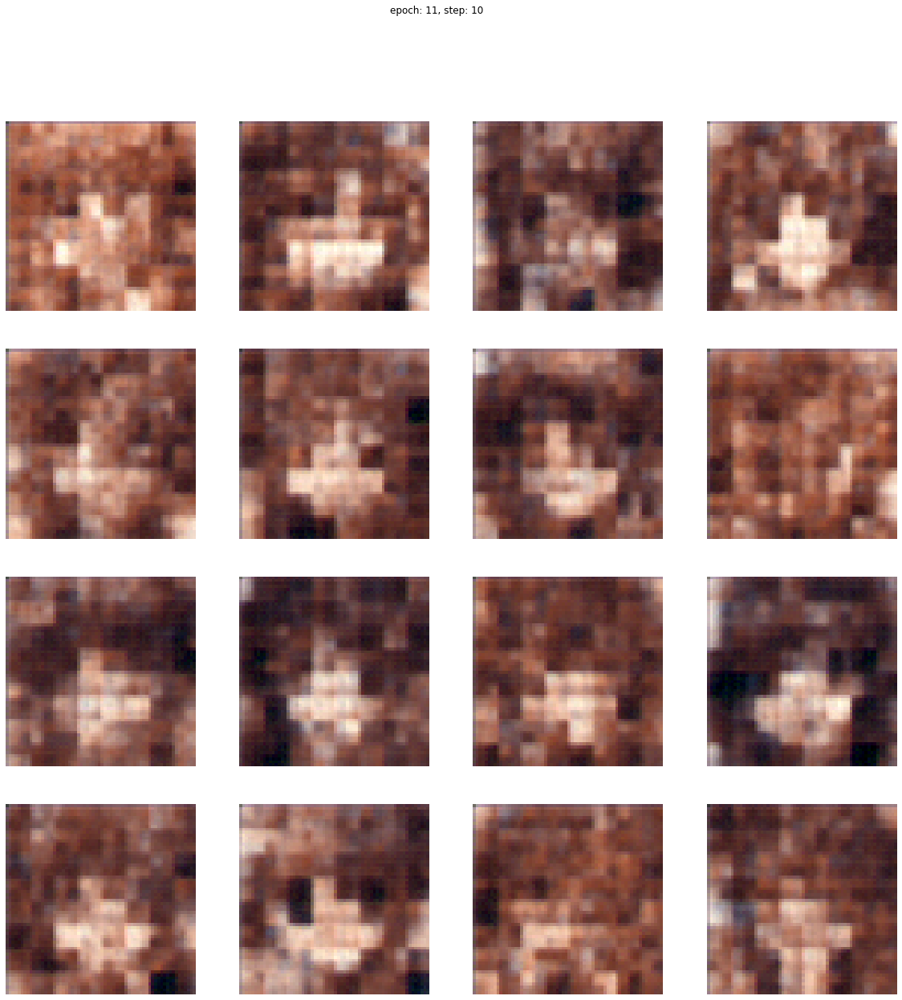

Epoch: 11 step: 10 mean loss = 866.5194
Epoch: 11 step: 11 mean loss = 865.92194
Epoch: 11 step: 12 mean loss = 865.36017
Epoch: 11 step: 13 mean loss = 864.7723
Epoch: 11 step: 14 mean loss = 864.1458
Epoch: 11 step: 15 mean loss = 863.53864
Epoch: 11 step: 16 mean loss = 862.9057
Epoch: 11 step: 17 mean loss = 862.2956
Epoch: 11 step: 18 mean loss = 861.6684
Epoch: 11 step: 19 mean loss = 861.0494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


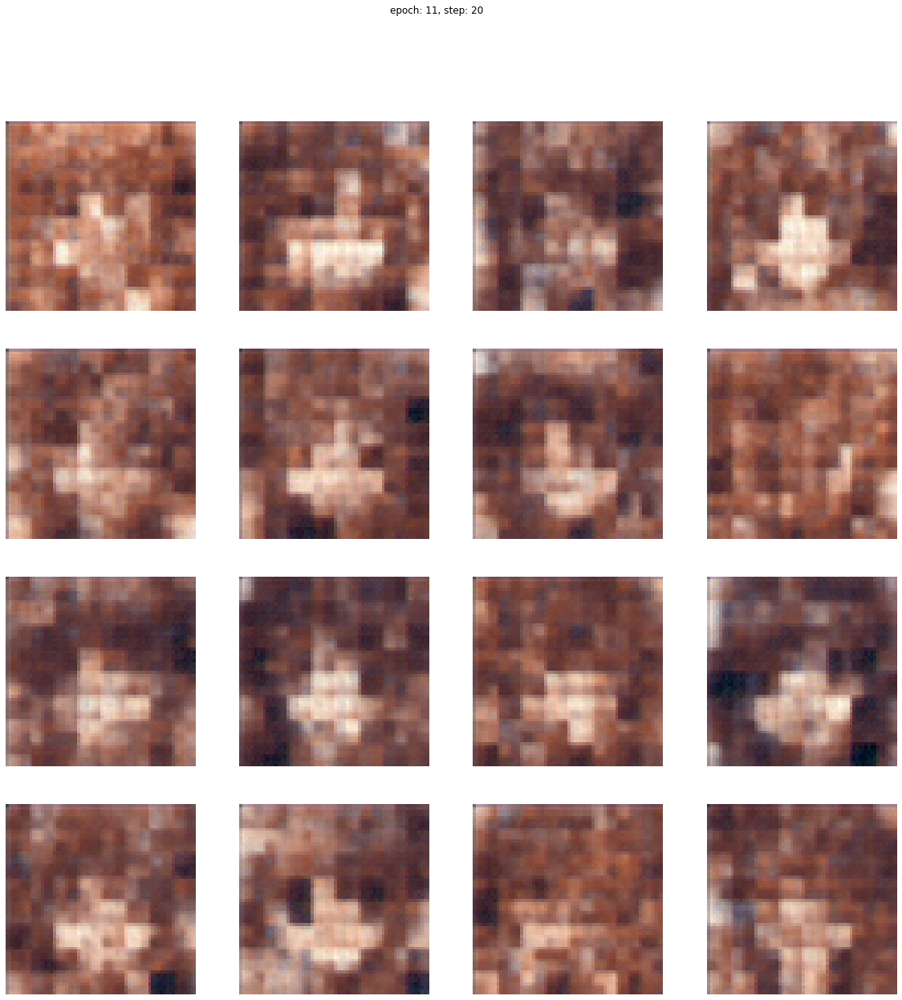

Epoch: 11 step: 20 mean loss = 860.4202
Epoch: 11 step: 21 mean loss = 859.80426
Epoch: 11 step: 22 mean loss = 859.17804
Epoch: 11 step: 23 mean loss = 858.55945
Epoch: 11 step: 24 mean loss = 857.93787
Epoch: 11 step: 25 mean loss = 857.31805
Start of epoch 12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

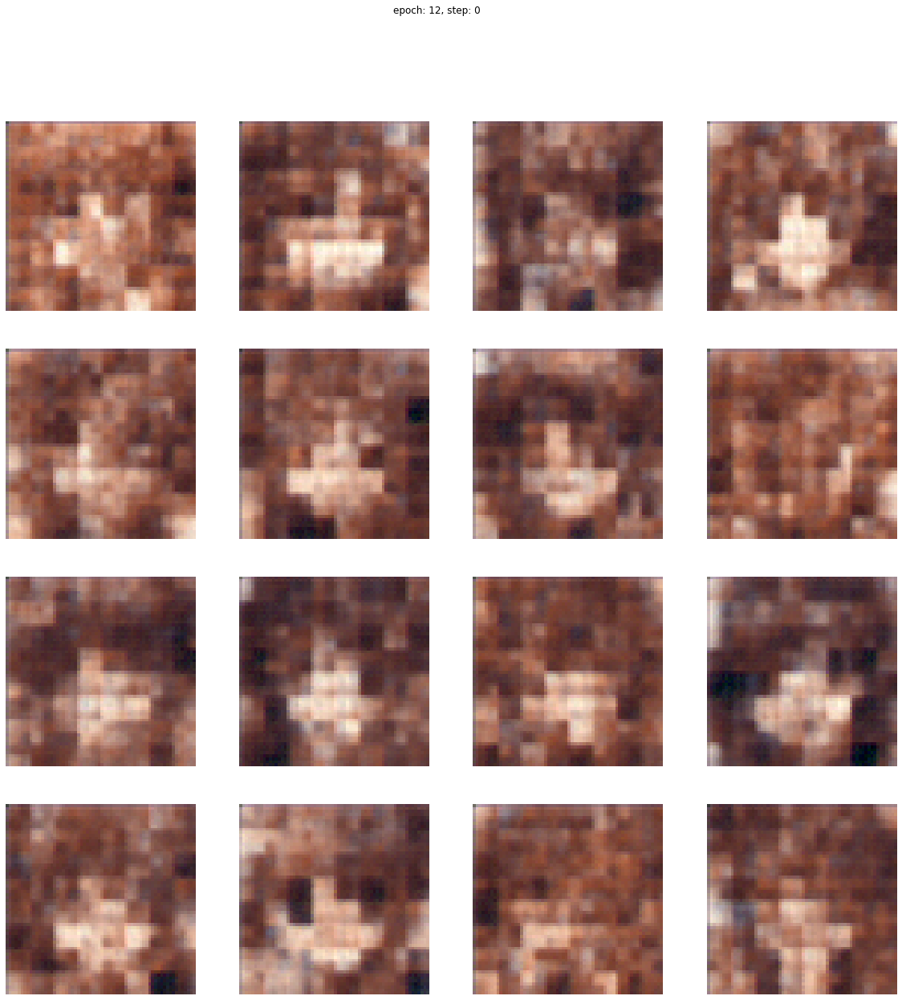

Epoch: 12 step: 0 mean loss = 856.6912
Epoch: 12 step: 1 mean loss = 856.0692
Epoch: 12 step: 2 mean loss = 855.45105
Epoch: 12 step: 3 mean loss = 854.8318
Epoch: 12 step: 4 mean loss = 854.21576
Epoch: 12 step: 5 mean loss = 853.59814
Epoch: 12 step: 6 mean loss = 852.9831
Epoch: 12 step: 7 mean loss = 852.3657
Epoch: 12 step: 8 mean loss = 851.7504
Epoch: 12 step: 9 mean loss = 851.1349


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

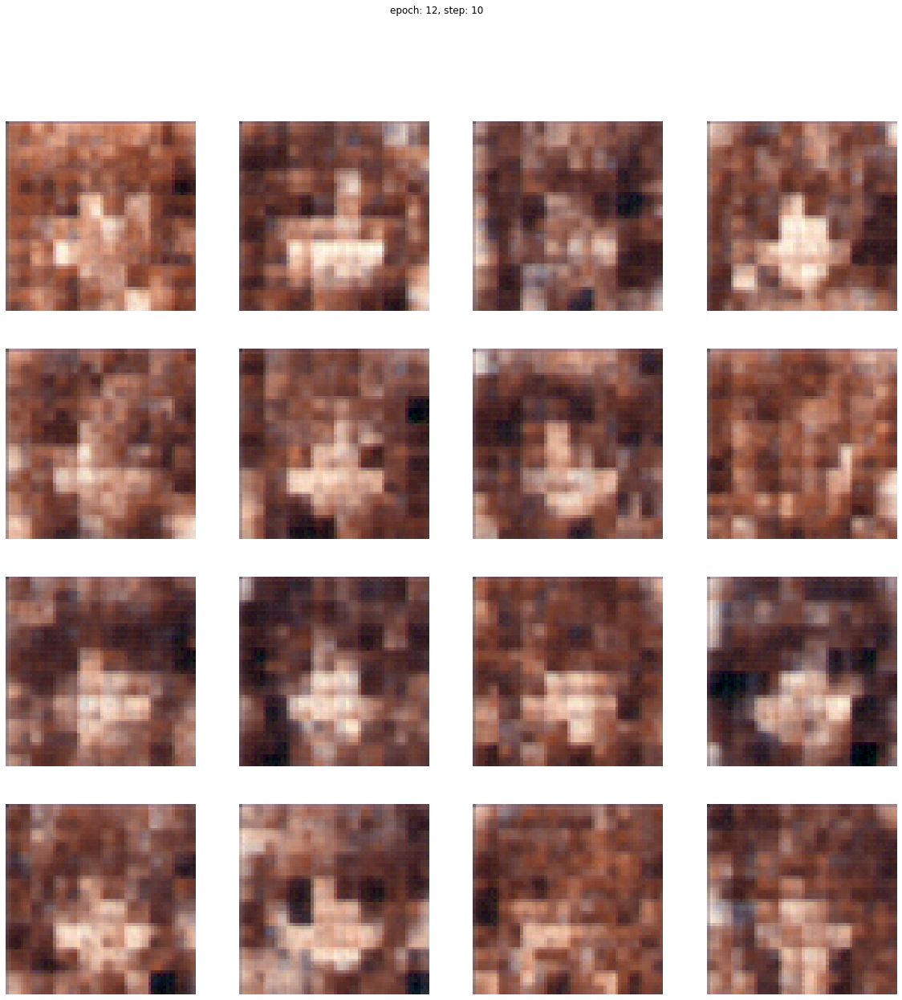

Epoch: 12 step: 10 mean loss = 850.52216
Epoch: 12 step: 11 mean loss = 849.9103
Epoch: 12 step: 12 mean loss = 849.2972
Epoch: 12 step: 13 mean loss = 848.6894
Epoch: 12 step: 14 mean loss = 848.0789
Epoch: 12 step: 15 mean loss = 847.46716
Epoch: 12 step: 16 mean loss = 846.8609
Epoch: 12 step: 17 mean loss = 846.2539
Epoch: 12 step: 18 mean loss = 845.64844
Epoch: 12 step: 19 mean loss = 845.0425


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

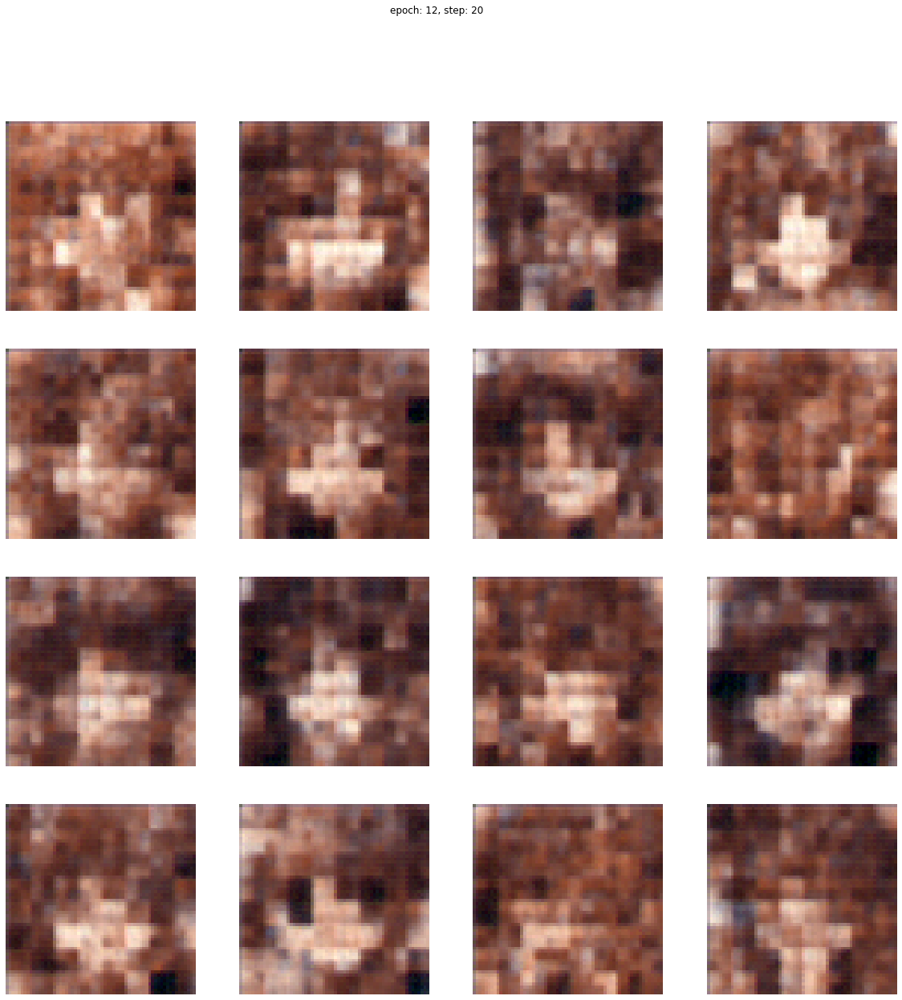

Epoch: 12 step: 20 mean loss = 844.43695
Epoch: 12 step: 21 mean loss = 843.83417
Epoch: 12 step: 22 mean loss = 843.2325
Epoch: 12 step: 23 mean loss = 842.6331
Epoch: 12 step: 24 mean loss = 842.0332
Epoch: 12 step: 25 mean loss = 841.43616
Start of epoch 13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

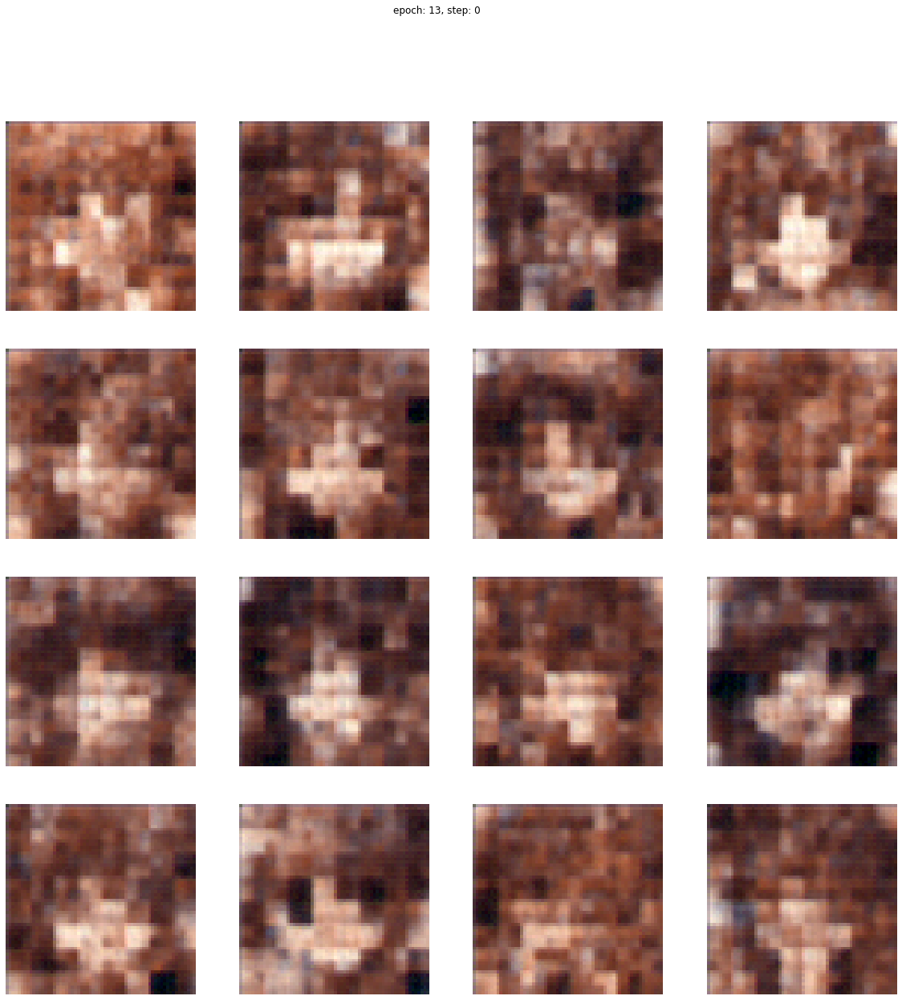

Epoch: 13 step: 0 mean loss = 840.83344
Epoch: 13 step: 1 mean loss = 840.23254
Epoch: 13 step: 2 mean loss = 839.6403
Epoch: 13 step: 3 mean loss = 839.0452
Epoch: 13 step: 4 mean loss = 838.4552
Epoch: 13 step: 5 mean loss = 837.8615
Epoch: 13 step: 6 mean loss = 837.2719
Epoch: 13 step: 7 mean loss = 836.68317
Epoch: 13 step: 8 mean loss = 836.0913
Epoch: 13 step: 9 mean loss = 835.50525


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

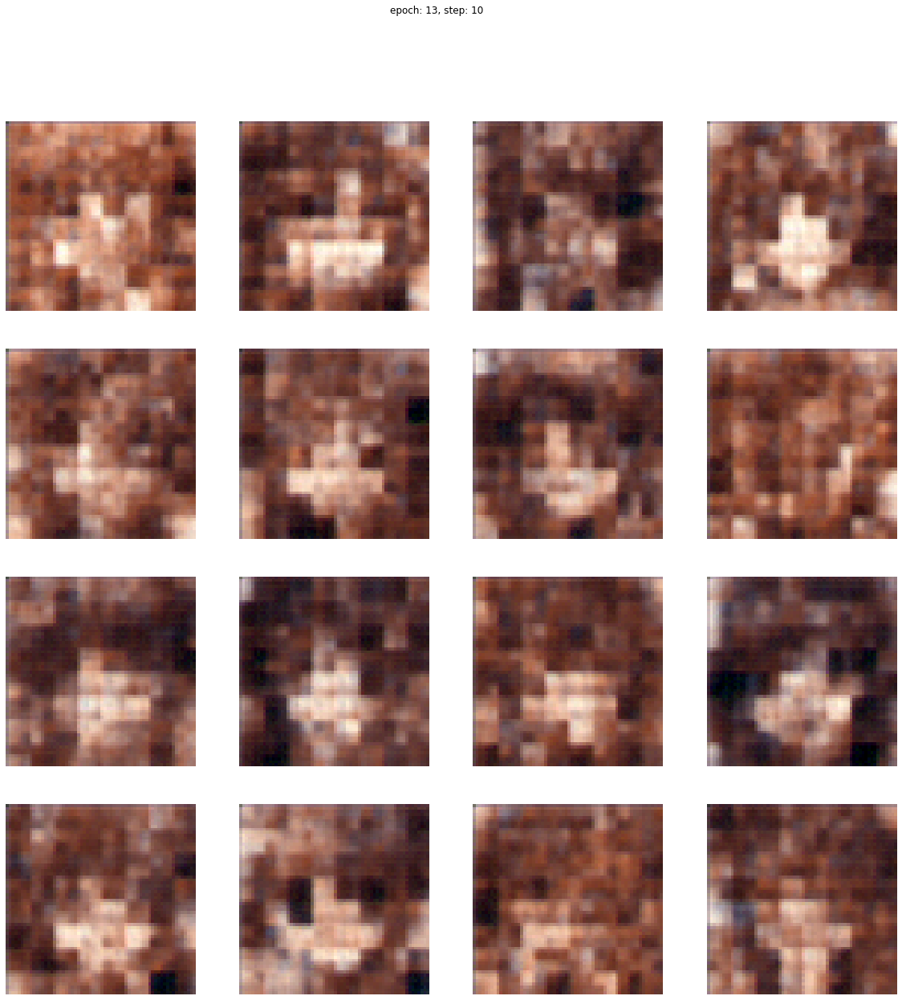

Epoch: 13 step: 10 mean loss = 834.91754
Epoch: 13 step: 11 mean loss = 834.3319
Epoch: 13 step: 12 mean loss = 833.7477
Epoch: 13 step: 13 mean loss = 833.166
Epoch: 13 step: 14 mean loss = 832.5833
Epoch: 13 step: 15 mean loss = 832.0017
Epoch: 13 step: 16 mean loss = 831.4213
Epoch: 13 step: 17 mean loss = 830.842
Epoch: 13 step: 18 mean loss = 830.2643
Epoch: 13 step: 19 mean loss = 829.68695


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

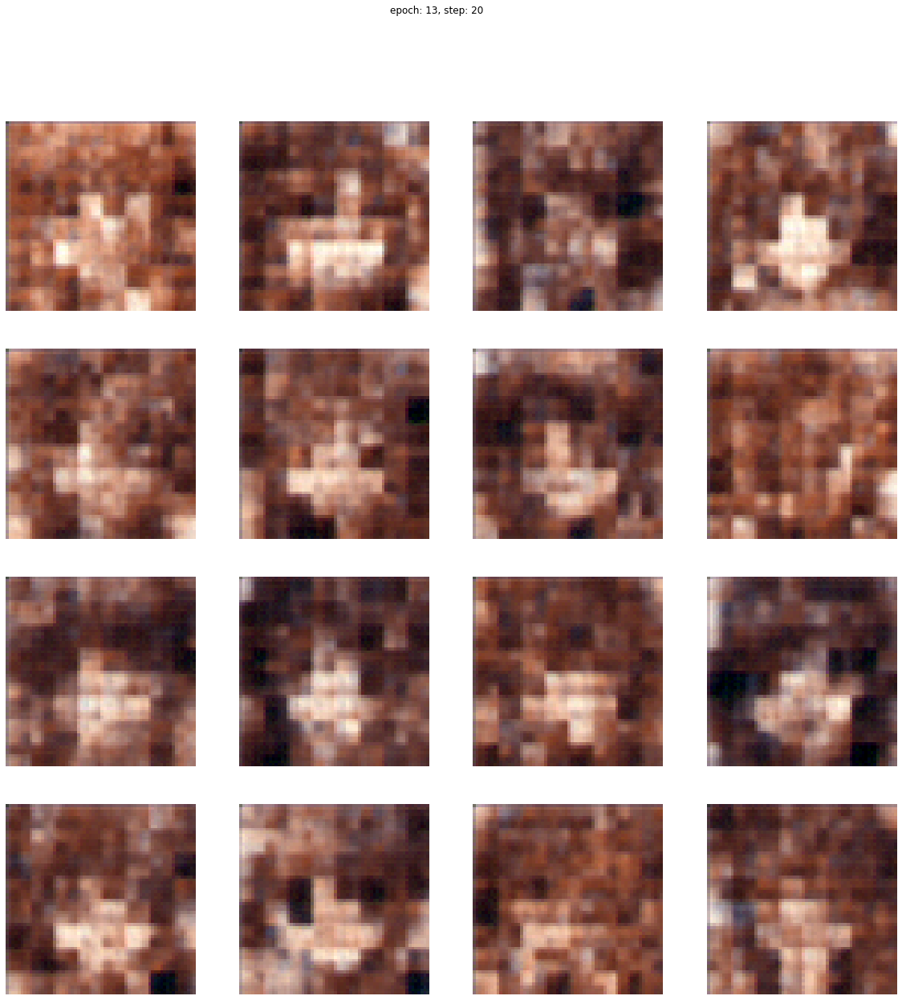

Epoch: 13 step: 20 mean loss = 829.11084
Epoch: 13 step: 21 mean loss = 828.5362
Epoch: 13 step: 22 mean loss = 827.9588
Epoch: 13 step: 23 mean loss = 827.3871
Epoch: 13 step: 24 mean loss = 826.8163
Epoch: 13 step: 25 mean loss = 826.2495
Start of epoch 14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

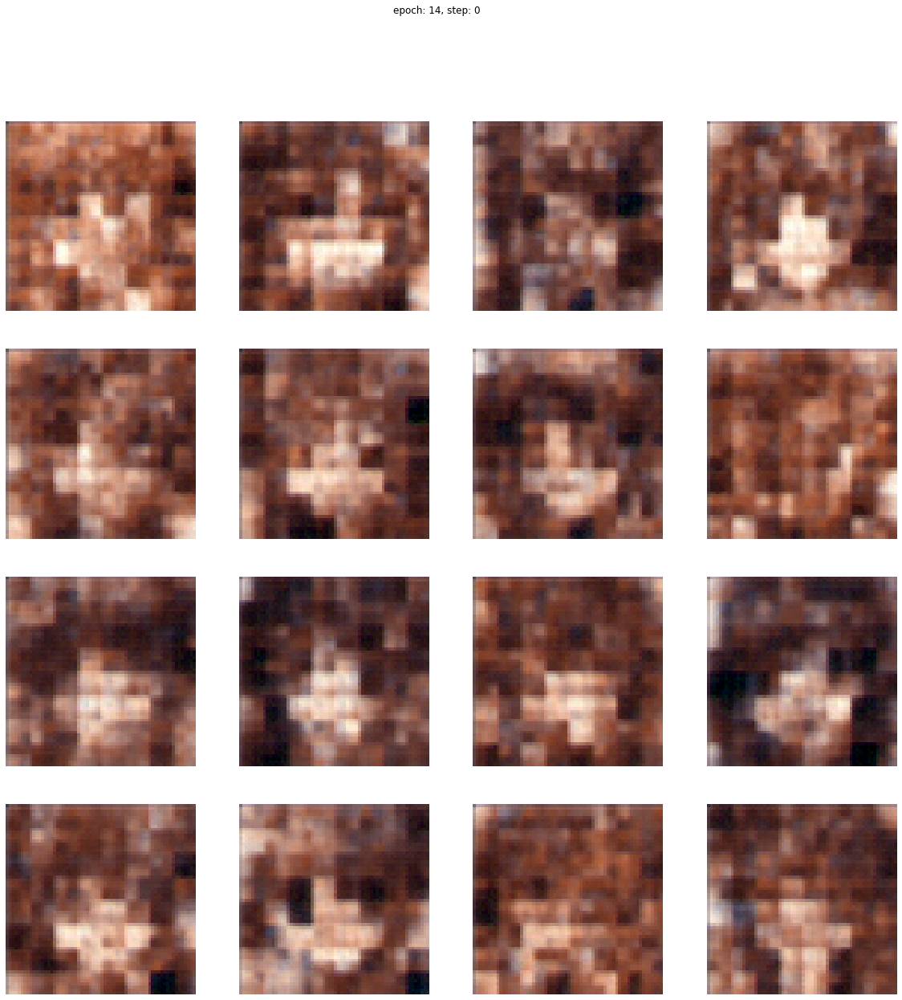

Epoch: 14 step: 0 mean loss = 825.67303
Epoch: 14 step: 1 mean loss = 825.10175
Epoch: 14 step: 2 mean loss = 824.53864
Epoch: 14 step: 3 mean loss = 823.9752
Epoch: 14 step: 4 mean loss = 823.4105
Epoch: 14 step: 5 mean loss = 822.84705
Epoch: 14 step: 6 mean loss = 822.2916
Epoch: 14 step: 7 mean loss = 821.7415
Epoch: 14 step: 8 mean loss = 821.20715
Epoch: 14 step: 9 mean loss = 820.69275


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

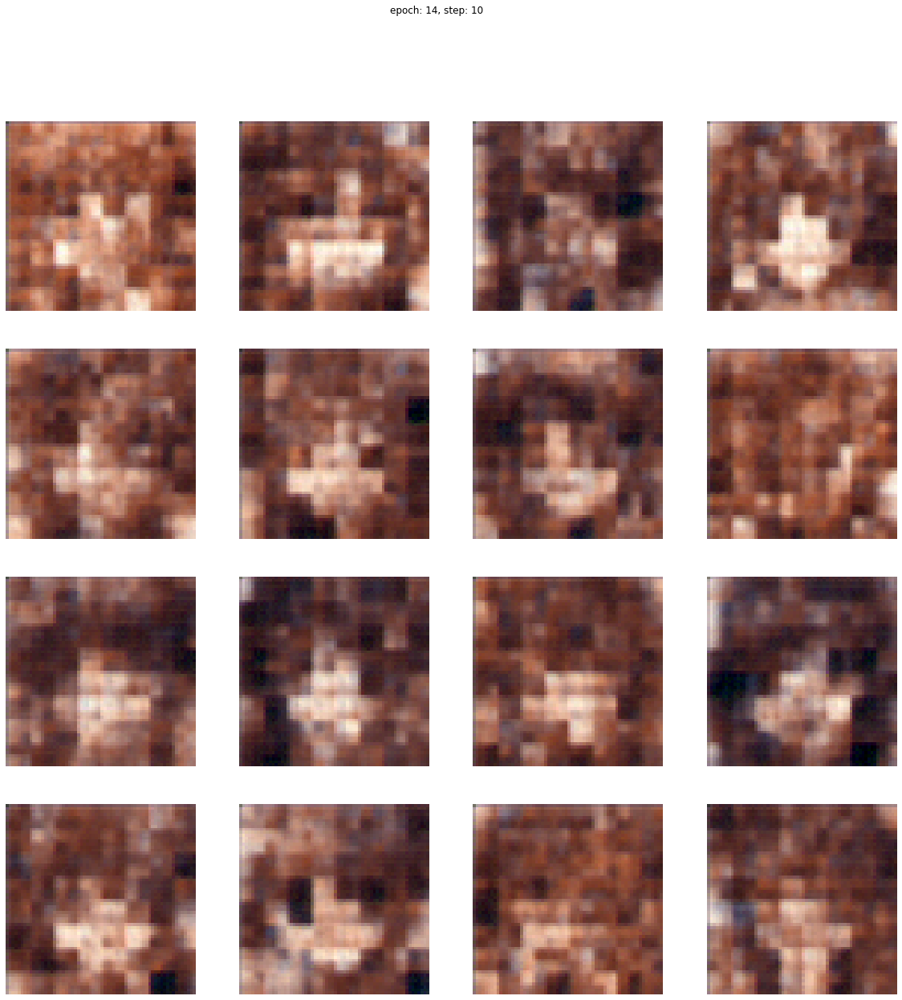

Epoch: 14 step: 10 mean loss = 820.1826
Epoch: 14 step: 11 mean loss = 819.6395
Epoch: 14 step: 12 mean loss = 819.09064
Epoch: 14 step: 13 mean loss = 818.56195
Epoch: 14 step: 14 mean loss = 818.02374
Epoch: 14 step: 15 mean loss = 817.47754
Epoch: 14 step: 16 mean loss = 816.9364
Epoch: 14 step: 17 mean loss = 816.40063
Epoch: 14 step: 18 mean loss = 815.8576
Epoch: 14 step: 19 mean loss = 815.318


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

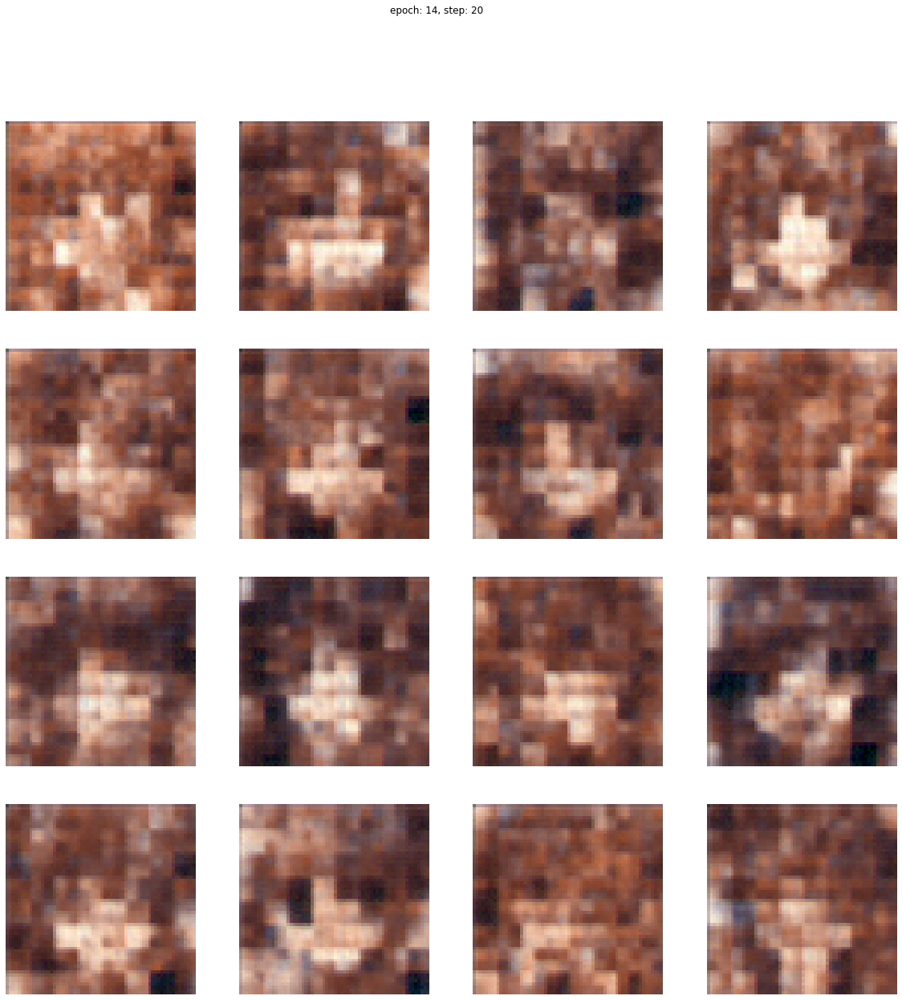

Epoch: 14 step: 20 mean loss = 814.77686
Epoch: 14 step: 21 mean loss = 814.2336
Epoch: 14 step: 22 mean loss = 813.6945
Epoch: 14 step: 23 mean loss = 813.1574
Epoch: 14 step: 24 mean loss = 812.6193
Epoch: 14 step: 25 mean loss = 812.0775
Start of epoch 15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

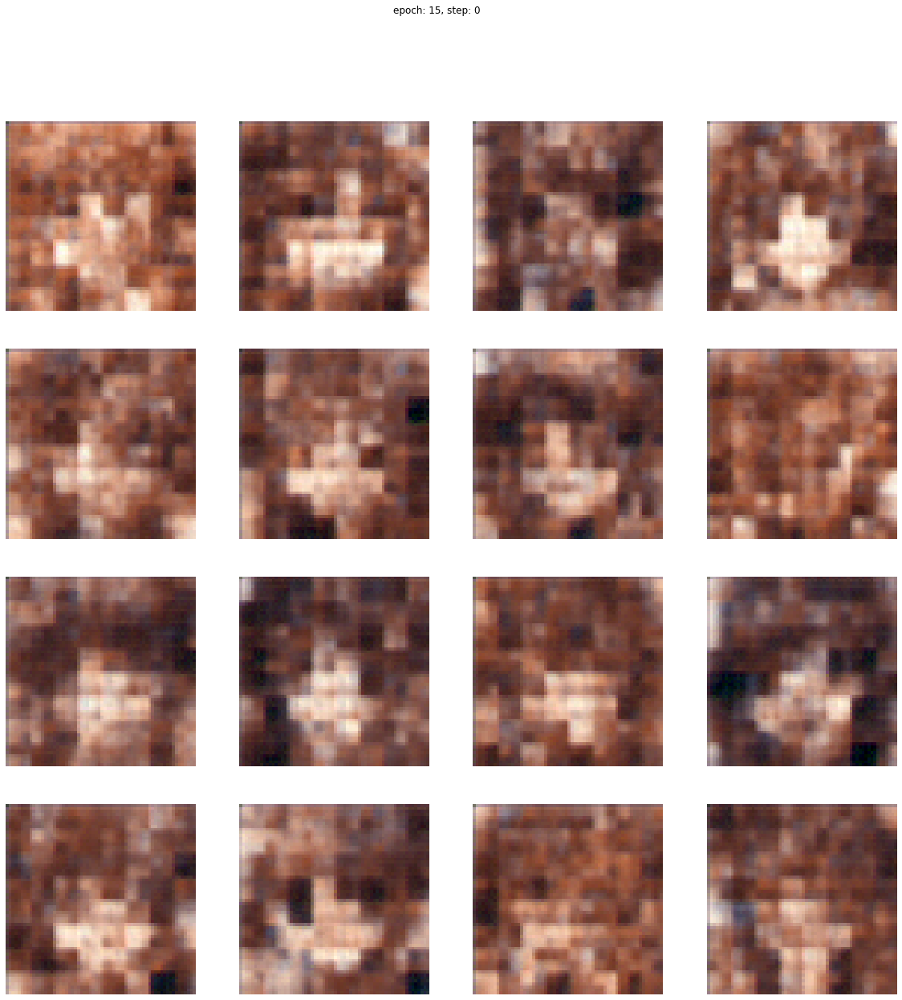

Epoch: 15 step: 0 mean loss = 811.5348
Epoch: 15 step: 1 mean loss = 810.99225
Epoch: 15 step: 2 mean loss = 810.45874
Epoch: 15 step: 3 mean loss = 809.9223
Epoch: 15 step: 4 mean loss = 809.39044
Epoch: 15 step: 5 mean loss = 808.8542
Epoch: 15 step: 6 mean loss = 808.31976
Epoch: 15 step: 7 mean loss = 807.78973
Epoch: 15 step: 8 mean loss = 807.25604
Epoch: 15 step: 9 mean loss = 806.7217


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

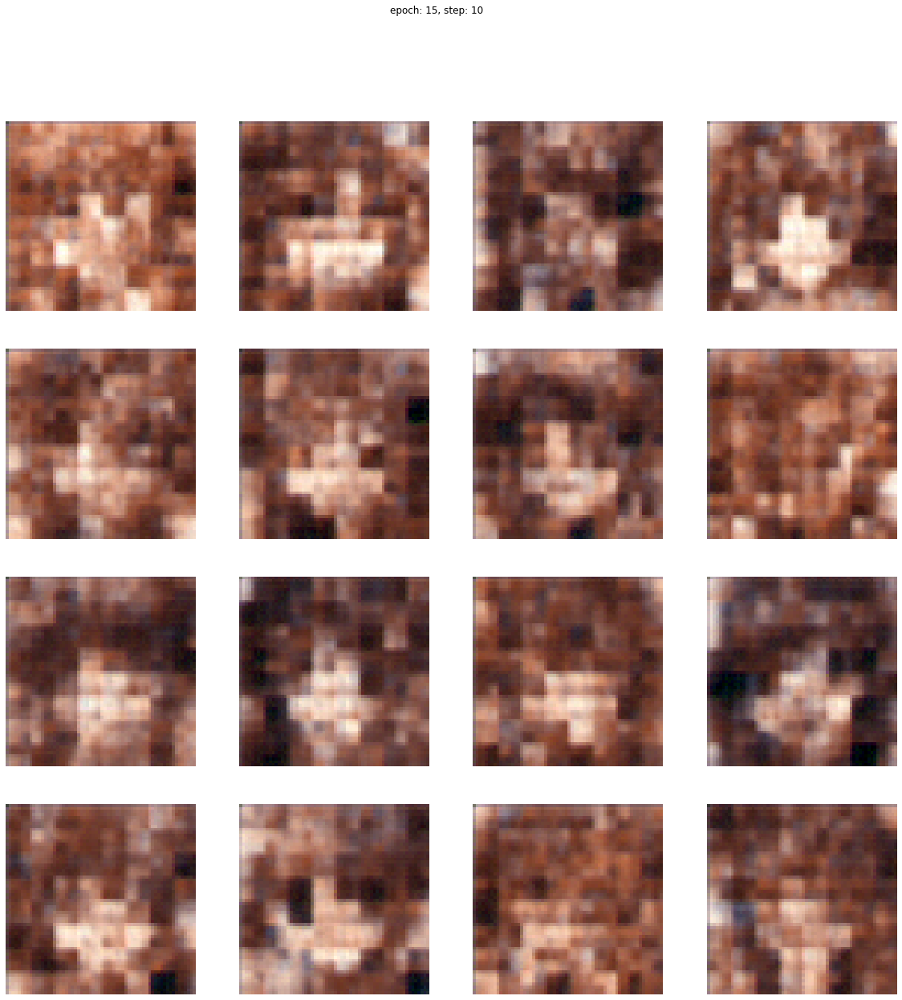

Epoch: 15 step: 10 mean loss = 806.1899
Epoch: 15 step: 11 mean loss = 805.66223
Epoch: 15 step: 12 mean loss = 805.13275
Epoch: 15 step: 13 mean loss = 804.60596
Epoch: 15 step: 14 mean loss = 804.0766
Epoch: 15 step: 15 mean loss = 803.5493
Epoch: 15 step: 16 mean loss = 803.0223
Epoch: 15 step: 17 mean loss = 802.4972
Epoch: 15 step: 18 mean loss = 801.97546
Epoch: 15 step: 19 mean loss = 801.451


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

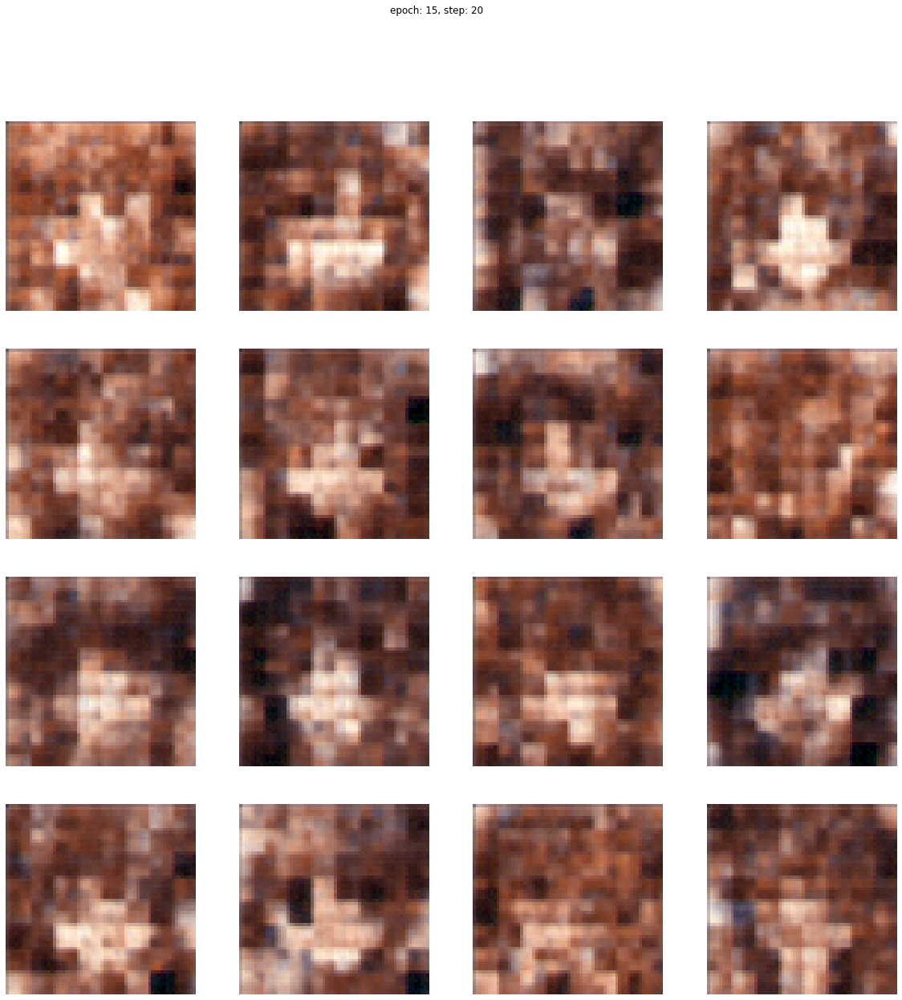

Epoch: 15 step: 20 mean loss = 800.92664
Epoch: 15 step: 21 mean loss = 800.4059
Epoch: 15 step: 22 mean loss = 799.8844
Epoch: 15 step: 23 mean loss = 799.3663
Epoch: 15 step: 24 mean loss = 798.84985
Epoch: 15 step: 25 mean loss = 798.32697
Start of epoch 16


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

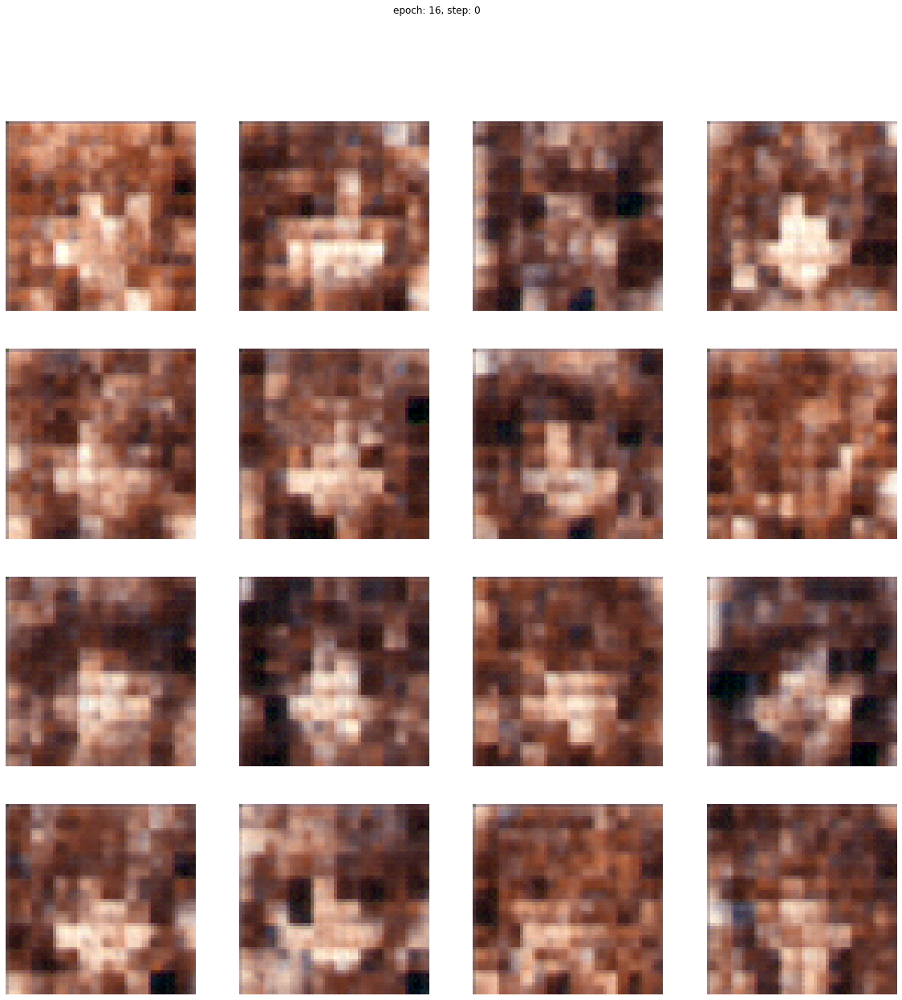

Epoch: 16 step: 0 mean loss = 797.80365
Epoch: 16 step: 1 mean loss = 797.28436
Epoch: 16 step: 2 mean loss = 796.77094
Epoch: 16 step: 3 mean loss = 796.2584
Epoch: 16 step: 4 mean loss = 795.7463
Epoch: 16 step: 5 mean loss = 795.2337
Epoch: 16 step: 6 mean loss = 794.72144
Epoch: 16 step: 7 mean loss = 794.2121
Epoch: 16 step: 8 mean loss = 793.6997
Epoch: 16 step: 9 mean loss = 793.19055


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

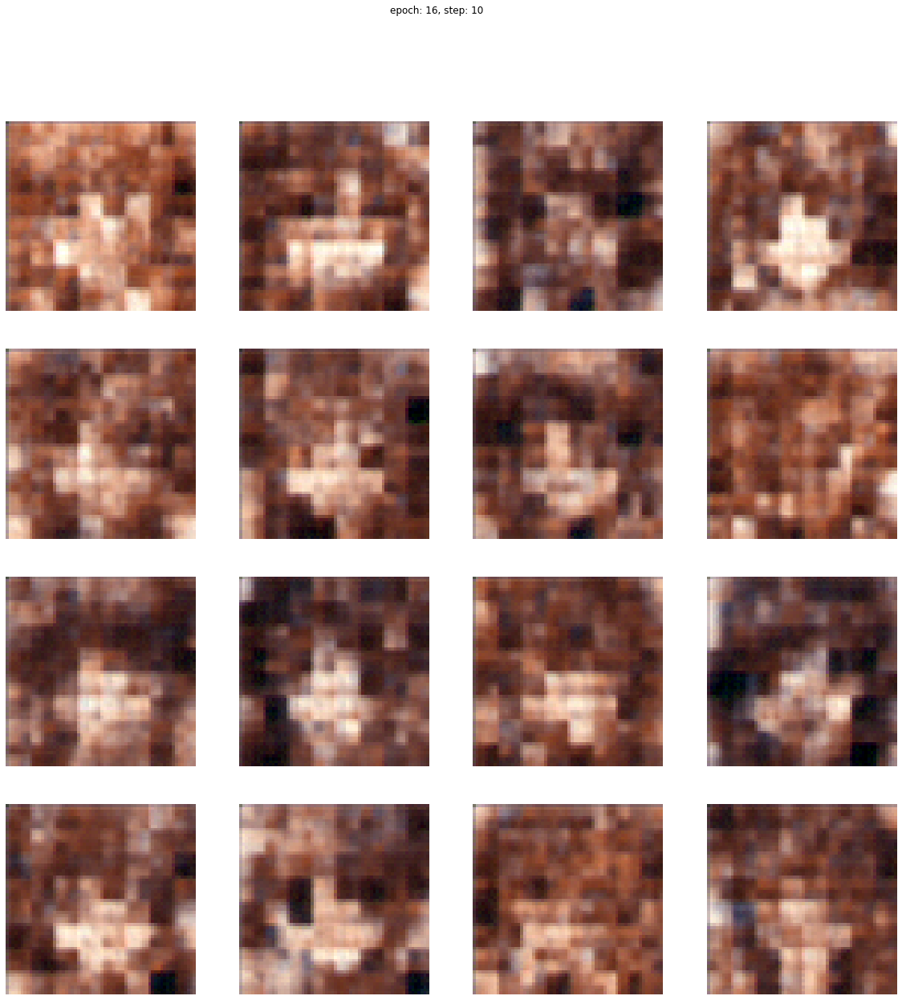

Epoch: 16 step: 10 mean loss = 792.6792
Epoch: 16 step: 11 mean loss = 792.17523
Epoch: 16 step: 12 mean loss = 791.6685
Epoch: 16 step: 13 mean loss = 791.16425
Epoch: 16 step: 14 mean loss = 790.65936
Epoch: 16 step: 15 mean loss = 790.15564
Epoch: 16 step: 16 mean loss = 789.6507
Epoch: 16 step: 17 mean loss = 789.14935
Epoch: 16 step: 18 mean loss = 788.6481
Epoch: 16 step: 19 mean loss = 788.1479


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

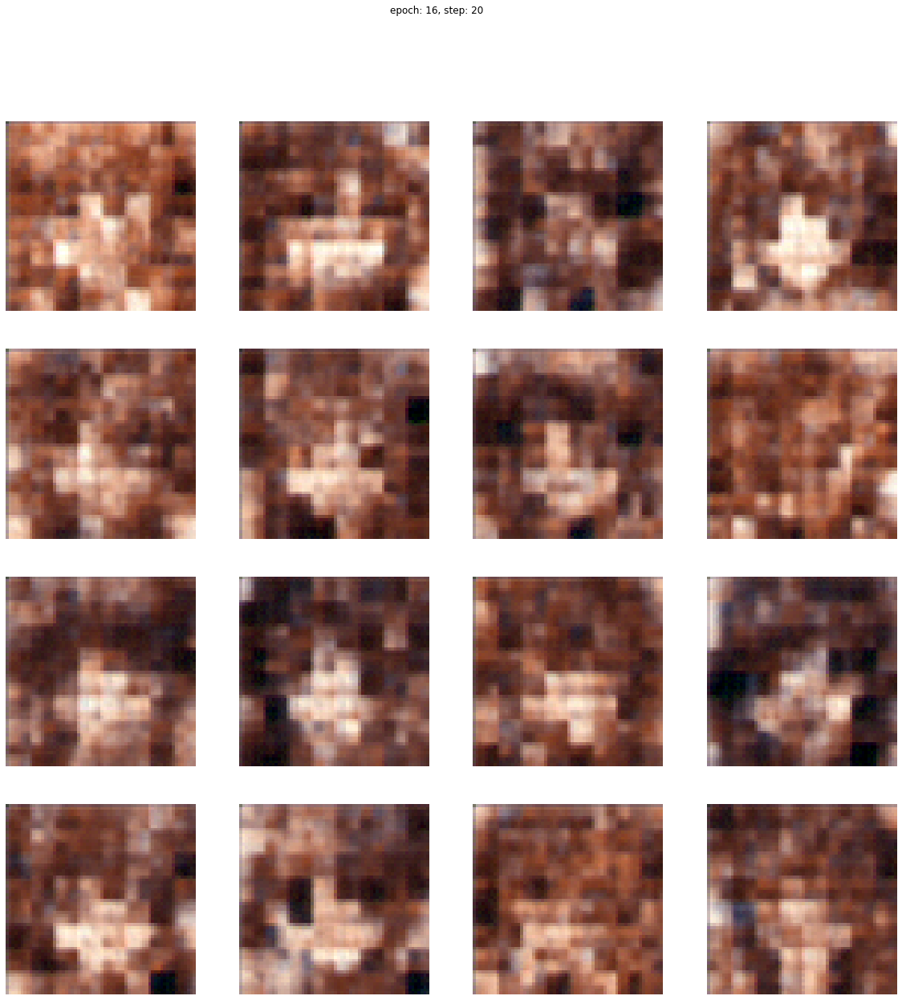

Epoch: 16 step: 20 mean loss = 787.65015
Epoch: 16 step: 21 mean loss = 787.1511
Epoch: 16 step: 22 mean loss = 786.6529
Epoch: 16 step: 23 mean loss = 786.1582
Epoch: 16 step: 24 mean loss = 785.6632
Epoch: 16 step: 25 mean loss = 785.1717
Start of epoch 17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

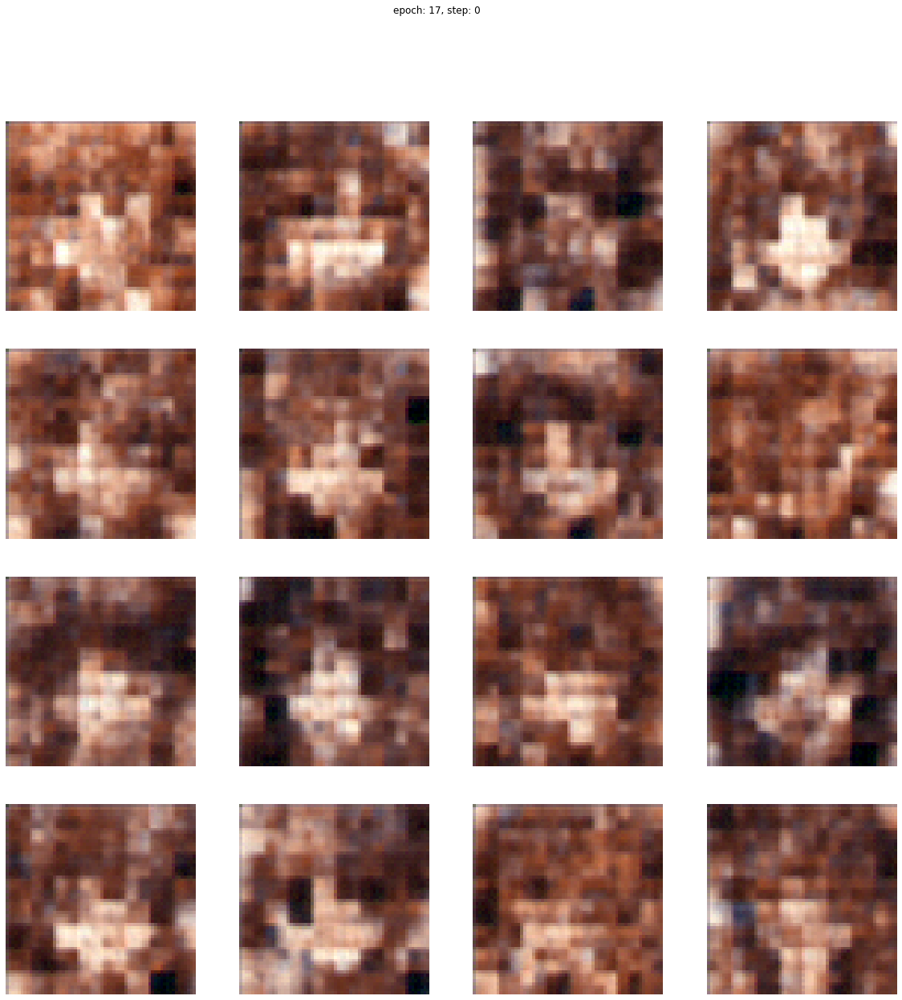

Epoch: 17 step: 0 mean loss = 784.67706
Epoch: 17 step: 1 mean loss = 784.18365
Epoch: 17 step: 2 mean loss = 783.6973
Epoch: 17 step: 3 mean loss = 783.2108
Epoch: 17 step: 4 mean loss = 782.72546
Epoch: 17 step: 5 mean loss = 782.23615
Epoch: 17 step: 6 mean loss = 781.7533
Epoch: 17 step: 7 mean loss = 781.26654
Epoch: 17 step: 8 mean loss = 780.77686
Epoch: 17 step: 9 mean loss = 780.2901


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

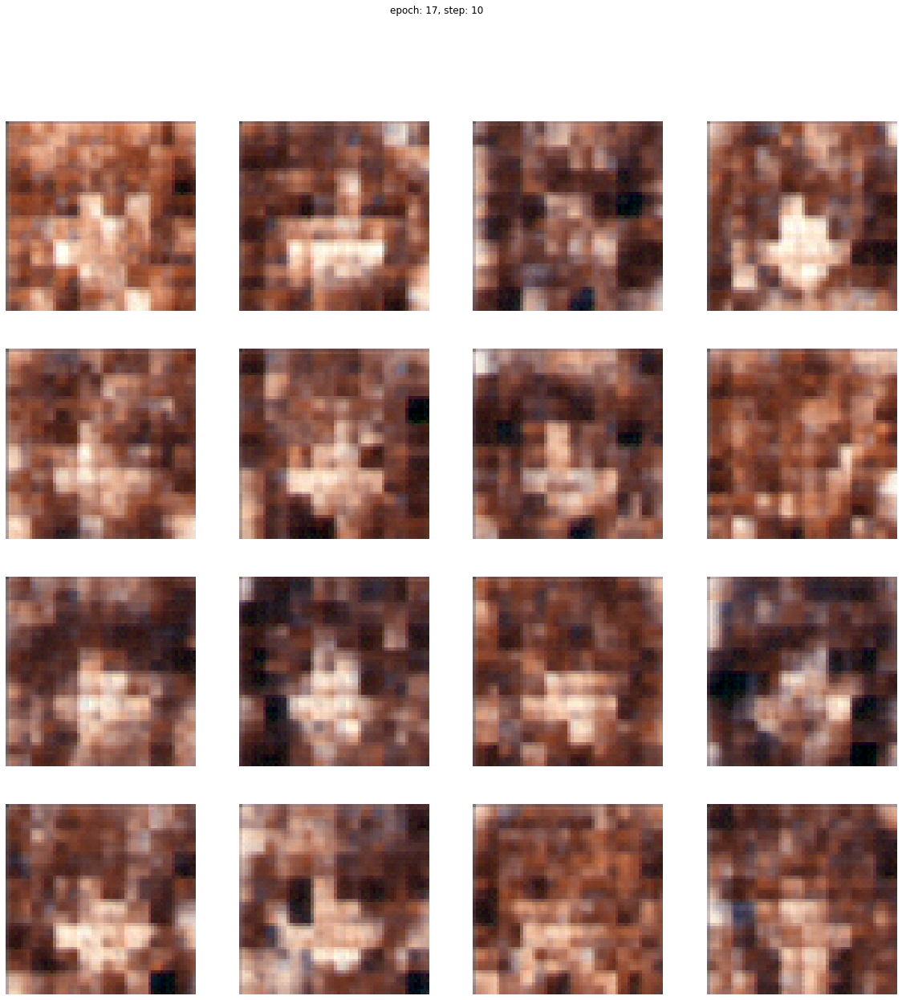

Epoch: 17 step: 10 mean loss = 779.80505
Epoch: 17 step: 11 mean loss = 779.3223
Epoch: 17 step: 12 mean loss = 778.8413
Epoch: 17 step: 13 mean loss = 778.35864
Epoch: 17 step: 14 mean loss = 777.87476
Epoch: 17 step: 15 mean loss = 777.3941
Epoch: 17 step: 16 mean loss = 776.9132
Epoch: 17 step: 17 mean loss = 776.4336
Epoch: 17 step: 18 mean loss = 775.9552
Epoch: 17 step: 19 mean loss = 775.4756


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

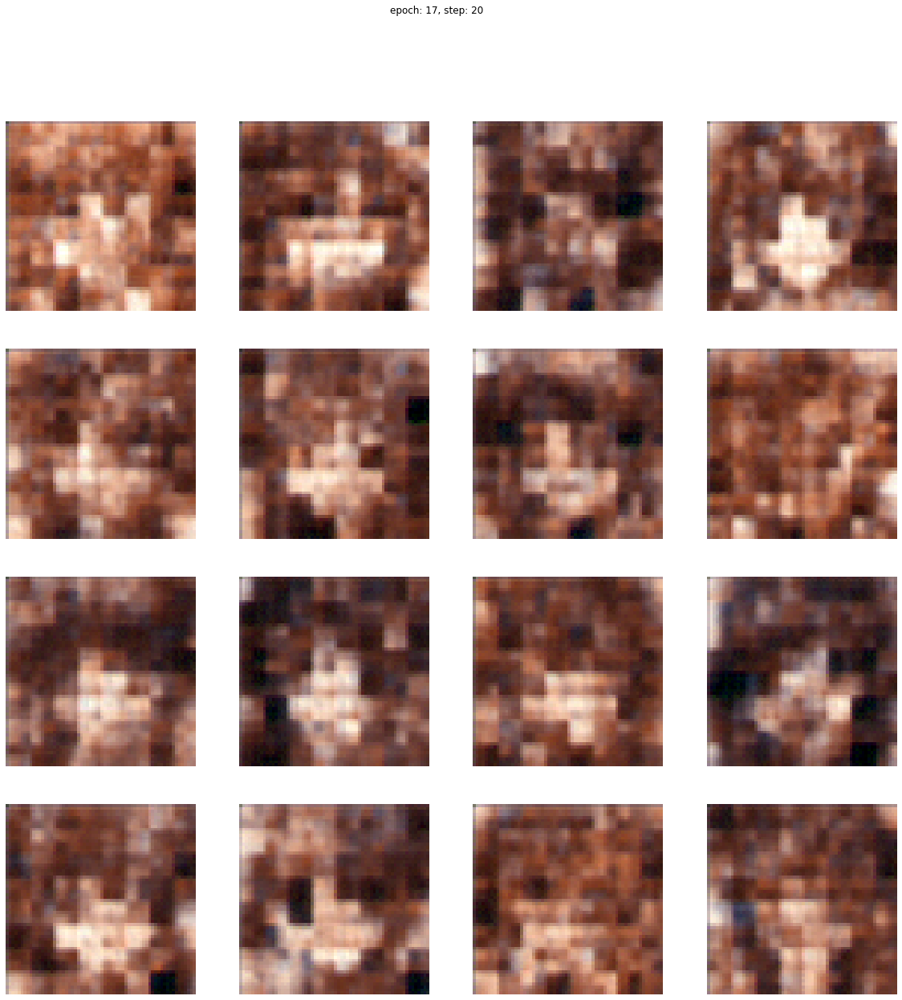

Epoch: 17 step: 20 mean loss = 774.9986
Epoch: 17 step: 21 mean loss = 774.52124
Epoch: 17 step: 22 mean loss = 774.04663
Epoch: 17 step: 23 mean loss = 773.5741
Epoch: 17 step: 24 mean loss = 773.1032
Epoch: 17 step: 25 mean loss = 772.63275
Start of epoch 18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

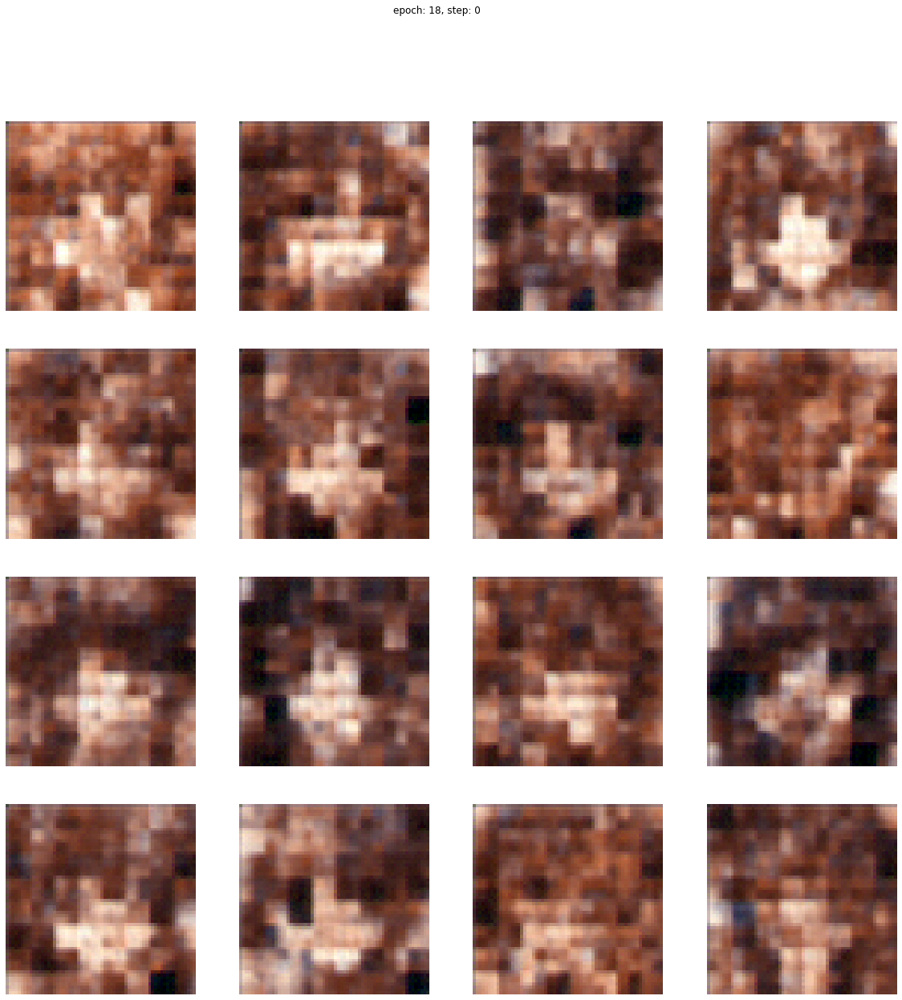

Epoch: 18 step: 0 mean loss = 772.1632
Epoch: 18 step: 1 mean loss = 771.69916
Epoch: 18 step: 2 mean loss = 771.24115
Epoch: 18 step: 3 mean loss = 770.7834
Epoch: 18 step: 4 mean loss = 770.3205
Epoch: 18 step: 5 mean loss = 769.85443
Epoch: 18 step: 6 mean loss = 769.3892
Epoch: 18 step: 7 mean loss = 768.92487
Epoch: 18 step: 8 mean loss = 768.4606
Epoch: 18 step: 9 mean loss = 767.99756


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

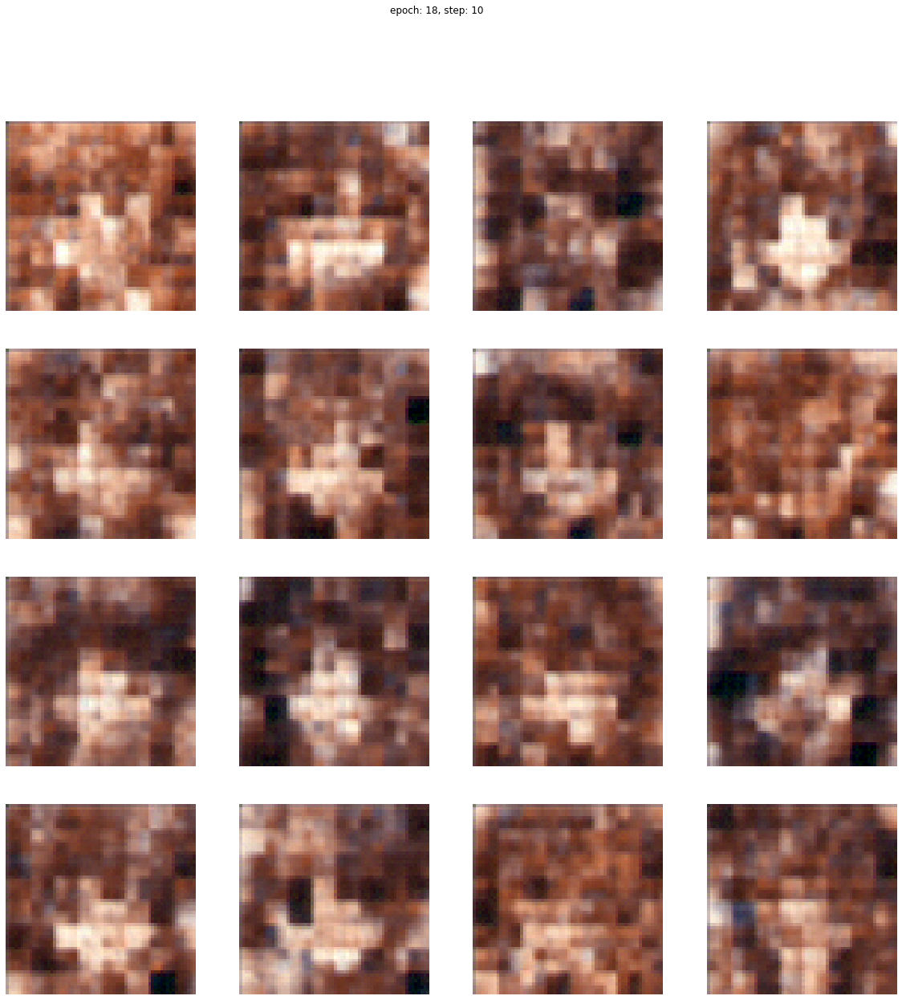

Epoch: 18 step: 10 mean loss = 767.5358
Epoch: 18 step: 11 mean loss = 767.0734
Epoch: 18 step: 12 mean loss = 766.6118
Epoch: 18 step: 13 mean loss = 766.15234
Epoch: 18 step: 14 mean loss = 765.6918
Epoch: 18 step: 15 mean loss = 765.2306
Epoch: 18 step: 16 mean loss = 764.77057
Epoch: 18 step: 17 mean loss = 764.3126
Epoch: 18 step: 18 mean loss = 763.8583
Epoch: 18 step: 19 mean loss = 763.39923


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

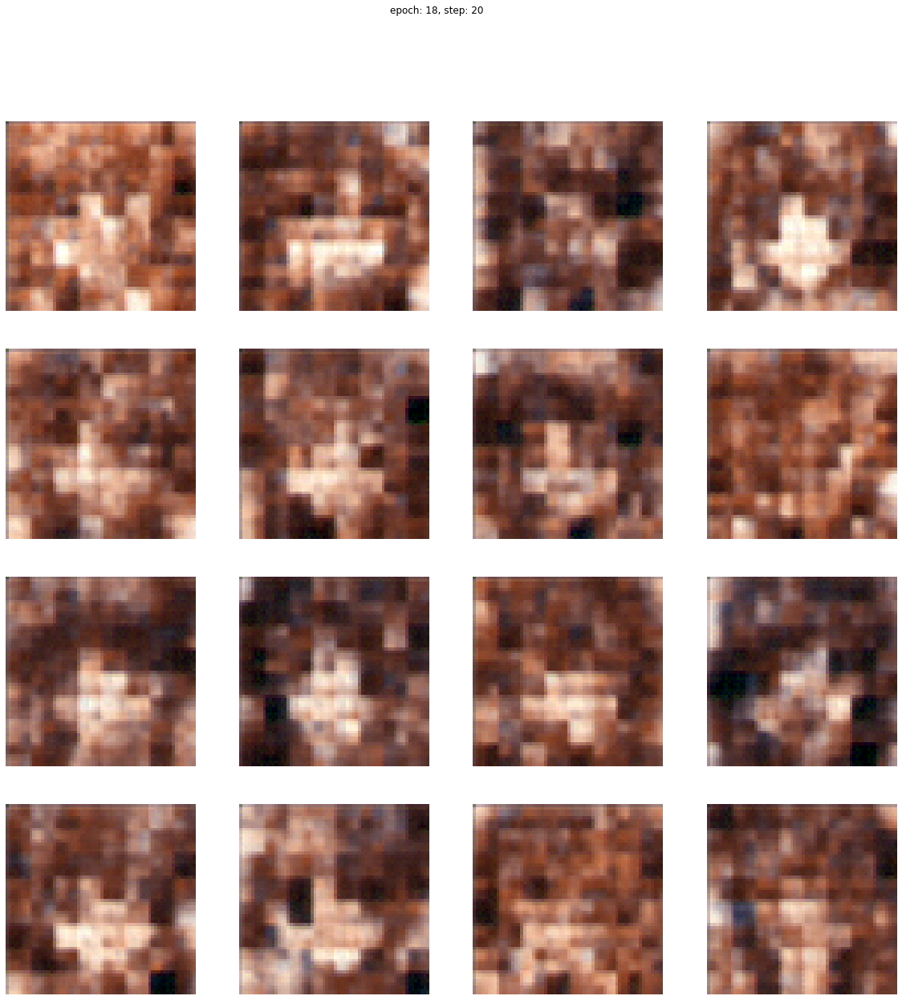

Epoch: 18 step: 20 mean loss = 762.9411
Epoch: 18 step: 21 mean loss = 762.48517
Epoch: 18 step: 22 mean loss = 762.03143
Epoch: 18 step: 23 mean loss = 761.5775
Epoch: 18 step: 24 mean loss = 761.1249
Epoch: 18 step: 25 mean loss = 760.6741
Start of epoch 19


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

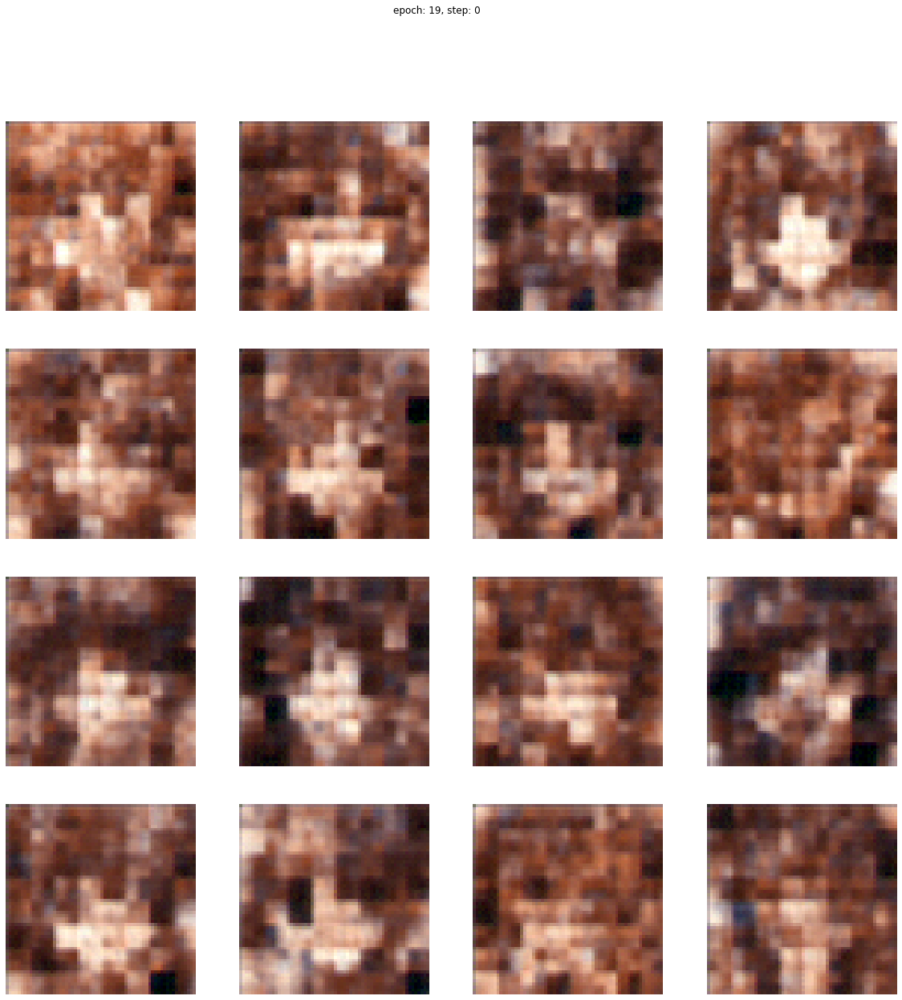

Epoch: 19 step: 0 mean loss = 760.2162
Epoch: 19 step: 1 mean loss = 759.76294
Epoch: 19 step: 2 mean loss = 759.3145
Epoch: 19 step: 3 mean loss = 758.8665
Epoch: 19 step: 4 mean loss = 758.41785
Epoch: 19 step: 5 mean loss = 757.96857
Epoch: 19 step: 6 mean loss = 757.52454
Epoch: 19 step: 7 mean loss = 757.07874
Epoch: 19 step: 8 mean loss = 756.6342
Epoch: 19 step: 9 mean loss = 756.195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

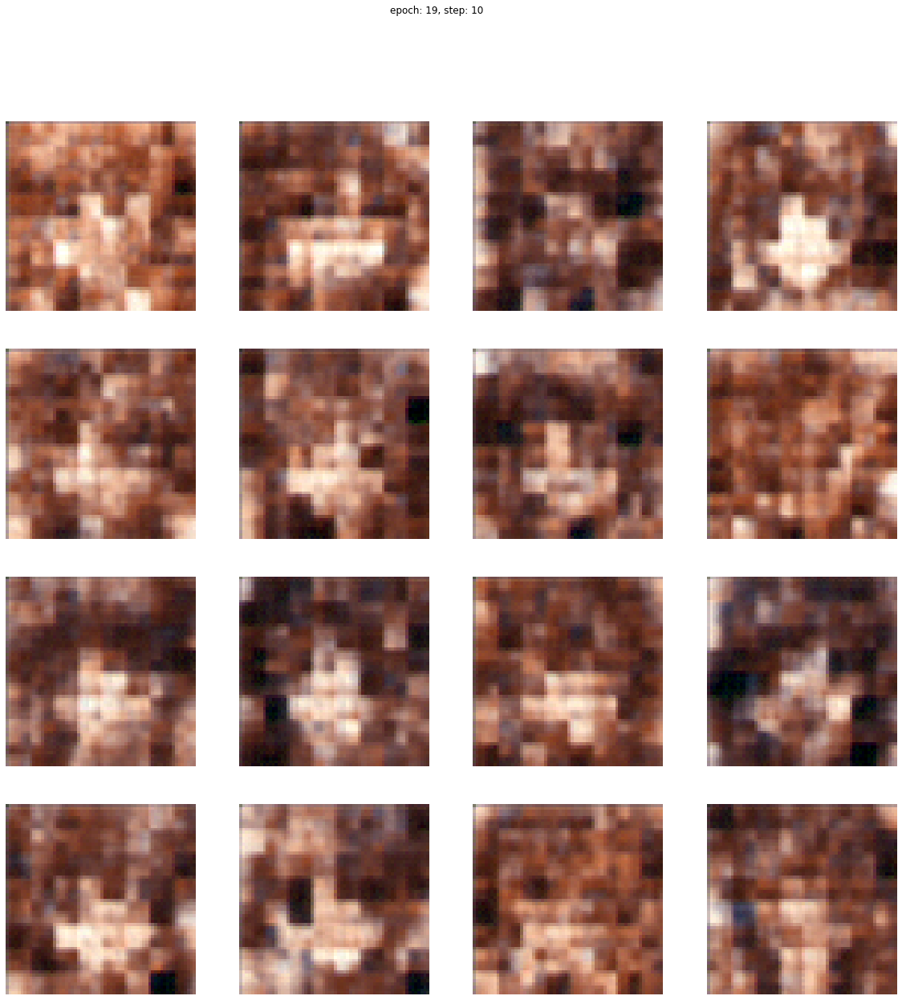

Epoch: 19 step: 10 mean loss = 755.7583
Epoch: 19 step: 11 mean loss = 755.3253
Epoch: 19 step: 12 mean loss = 754.88727
Epoch: 19 step: 13 mean loss = 754.4461
Epoch: 19 step: 14 mean loss = 754.00653
Epoch: 19 step: 15 mean loss = 753.568
Epoch: 19 step: 16 mean loss = 753.1292
Epoch: 19 step: 17 mean loss = 752.68866
Epoch: 19 step: 18 mean loss = 752.2532
Epoch: 19 step: 19 mean loss = 751.8158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

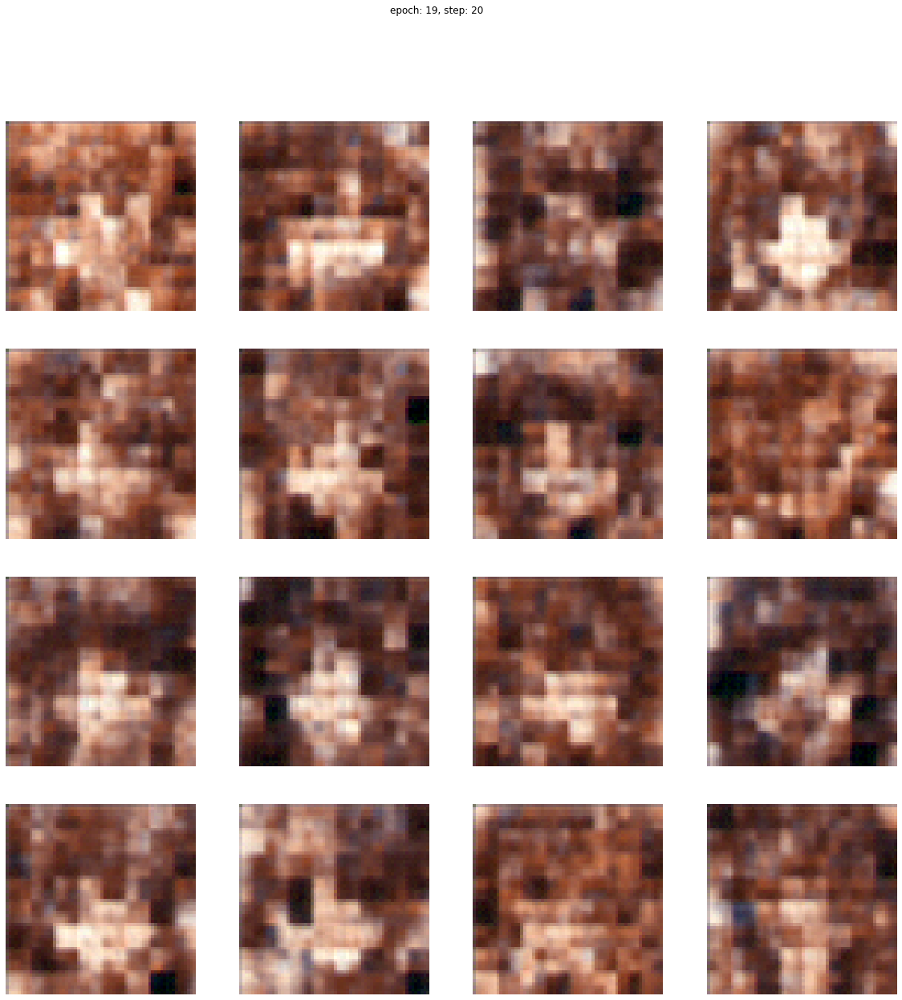

Epoch: 19 step: 20 mean loss = 751.378
Epoch: 19 step: 21 mean loss = 750.9415
Epoch: 19 step: 22 mean loss = 750.50696
Epoch: 19 step: 23 mean loss = 750.07214
Epoch: 19 step: 24 mean loss = 749.6379
Epoch: 19 step: 25 mean loss = 749.2078


In [30]:
# Training loop. Display generated images each epoch

### START CODE HERE ###
epochs = 20
### END CODE HERE ###

random_vector_for_generation = tf.random.normal(shape=[16, LATENT_DIM])
generate_and_save_images(decoder, 0, 0, random_vector_for_generation)

for epoch in range(epochs):
  print('Start of epoch %d' % (epoch,))

  # Iterate over the batches of the dataset.
  for step, x_batch_train in enumerate(training_dataset):
    with tf.GradientTape() as tape:
      ### START CODE HERE ### 
      predictions=vae(x_batch_train)
      # Compute reconstruction loss
      true_labels=tf.reshape(x_batch_train , shape=[-1])
      pred_labels=tf.reshape(predictions , shape=[-1])
      loss=mse_loss(true_labels  , pred_labels)*64*64*3
      loss+= sum(vae.losses)
    gradients=tape.gradient(loss , vae.trainable_weights)
    optimizer.apply_gradients( zip(gradients , vae.trainable_weights) )
    ### END CODE HERE
    
    loss_metric(loss)

    if step % 10 == 0:
      #display.clear_output(wait=False)    
      generate_and_save_images(decoder, epoch, step, random_vector_for_generation)
    print('Epoch: %s step: %s mean loss = %s' % (epoch, step, loss_metric.result().numpy()))

# Plot Reconstructed Images


As mentioned, your model will be graded on how well it is able to reconstruct images (not generate new ones). You can get a glimpse of how it is doing with the code block below. It feeds in a batch from the test set and plots a row of input (top) and output (bottom) images. Don't worry if the outputs are a blurry. It will look something like below:

<img src="https://drive.google.com/uc?export=view&id=1OPMbZOxX9fx8tK6CGVbrMaQdgyOiQJIC" width="75%" height="60%"/>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

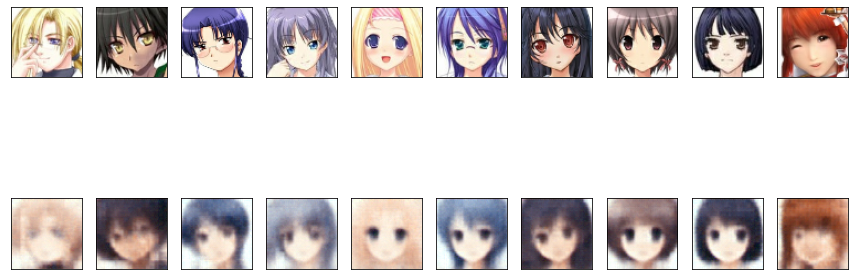

In [31]:
test_dataset = validation_dataset.take(1)
output_samples = []

for input_image in tfds.as_numpy(test_dataset):
      output_samples = input_image # turning the test_dataset into image array

idxs = np.random.choice(64, size=10)

vae_predicted = vae.predict(test_dataset) # returns image array
display_results(output_samples[idxs], vae_predicted[idxs])

# Plot Generated Images


Using the default parameters, it can take a long time to train your model well enough to generate good fake anime faces. In case you decide to experiment, we provided the code block below to display an 8x8 gallery of fake data generated from your model. Here is a sample gallery generated after 50 epochs.

<img src="https://drive.google.com/uc?export=view&id=1QwElgfg5TY6vCgI1FK6vdI8Bo6UZKfuX" width="75%" height="60%"/>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


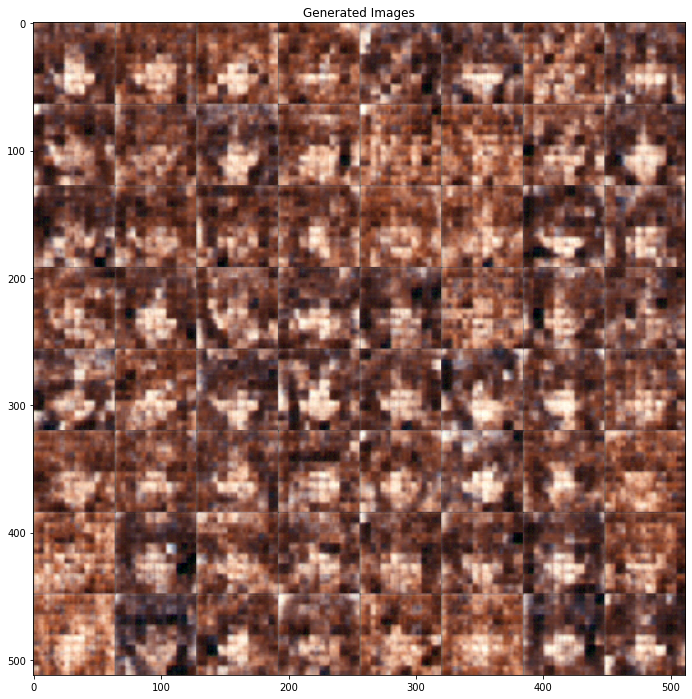

In [32]:
def plot_images(rows, cols, images, title):
    '''Displays images in a grid.'''
    grid = np.zeros(shape=(rows*64, cols*64, 3))
    for row in range(rows):
        for col in range(cols):
            grid[row*64:(row+1)*64, col*64:(col+1)*64, :] = images[row*cols + col]

    plt.figure(figsize=(12,12))       
    plt.imshow(grid)
    plt.title(title)
    plt.show()

# initialize random inputs
test_vector_for_generation = tf.random.normal(shape=[64, LATENT_DIM])

# get predictions from the decoder model
predictions= decoder.predict(test_vector_for_generation)

# plot the predictions
plot_images(8,8,predictions,'Generated Images')

### Save the Model

Once your satisfied with the results, please save and download the model. Afterwards, please go back to the Coursera submission portal to upload your h5 file to the autograder.

In [33]:
vae.save("anime.h5")